In [ ]:
import visualization as vis
%run 00_analysis_config.ipynb

In [ ]:
# modules in this directory
import visualization, util, event, cutflow, detector
importlib.reload(event)
importlib.reload(visualization)
importlib.reload(util)
importlib.reload(detector)
import visualization as vis
reload(vis)

import lsfit

# Figure save path prefix
savefig.fig_prefix = "plots/vertex2_"    # It's good to keep figures in a separate folder. Can also be set to None.
savefig.SAVE = False         # Use this flag to turn the figure saving on or off, so that you don't need to modify all notebook to save figure.

In [ ]:
print(1)

In [3]:
filename = "data/LLP_bb_20GeV_40Events_recon.root"
# filename = "/project/def-mdiamond/tomren/mathusla/data/LLP/LLP_test_bb_20/20230617/213934/stat_vertexmod.root"
tfile = root.TFile.Open(filename)
tree_name = tfile.GetListOfKeys()[0].GetName()
Tree = tfile.Get(tree_name)

nevents = int(Tree.GetEntries())
branch_list = [Tree.GetListOfBranches()[i].GetName() for i in range(len(Tree.GetListOfBranches()))]
print("Number of events",nevents)

Number of events 199


In [4]:
for i in range(20):
    Tree.GetEntry(i)
    print(i, Tree.GenParticle_y[1]*0.1, -Tree.GenParticle_z[1]*0.1+85.47*100, Tree.GenParticle_x[1]*0.1)

0 138.8366350331123 9104.530487116019 7109.030013888139
1 -1056.9873281525572 7026.650697466024 16963.106200731312
2 592.7085872409593 8582.638257607 11025.09150704668
3 -1064.503311853368 8530.987891727655 10318.17970205982
4 2321.8364553064134 7537.4042542396255 14954.604706494913
5 -2919.864260113354 7094.027206044701 10986.152452136601
6 635.4772108915155 9015.653822195552 7069.192262050198
7 -3232.0482592876424 7383.431456911081 16879.681242411196
8 -2539.7232983523095 7071.862811620191 15686.30208735456
9 -1370.2034789990958 7307.782587850954 7616.450055236695
10 2404.5706469633633 7425.405857250979 8539.22245274082
11 1099.0610343028252 8856.539349437213 8760.397899894038
12 -830.4630339544824 9138.826511799027 12135.829111700448
13 1989.4189353962292 8755.128126155205 7384.442835302506
14 2879.490015378847 9106.15320734411 7571.925480699159
15 -4429.213012737858 7114.068752549281 13459.335520219207
16 4473.273050510578 6749.612032449522 16806.184270391353
17 1336.8915457727144 

In [38]:
original = [15, 27,3]
new = [23, 13, 16]
np.linalg.norm(original), np.linalg.norm(new)

(30.116440692751194, 21.77154105707724)

In [28]:
Vertex_G4ID = []
Vertex_track_chi2 = []
for i in range(200):
    Tree.GetEntry(i)
    # print(i, Tree.GenParticle_y[1]*0.1, -Tree.GenParticle_z[1]*0.1+85.47*100, Tree.GenParticle_x[1]*0.1)
    
    if Tree.Vertex_k_m_x.size()<1:
        continue
    
    # Get the recon vertex that is closest to the truth
    vertex_truth = [Tree.GenParticle_y[1]*0.1, -Tree.GenParticle_z[1]*0.1+85.47*100, Tree.GenParticle_x[1]*0.1, 0]
    vertex_recon=[[Tree.Vertex_k_m_x.at(iv),Tree.Vertex_k_m_y.at(iv),Tree.Vertex_k_m_z.at(iv),Tree.Vertex_k_m_t.at(iv)]  for iv in range(Tree.Vertex_k_m_x.size())]
    recon_truth_dist = [np.linalg.norm((np.array(vrecon) - vertex_truth)[:3])  for vrecon in vertex_recon]
    vertex_ind = np.argmin(recon_truth_dist)
    vertex_recon = vertex_recon[vertex_ind]
    
    

    track_km_inds = np.array(util.unzip(util.c2list(Tree.Track_k_m_ids)),dtype=object)
    track_km_g4inds = np.array([min(i) for i in track_km_inds])    
    vertex_track_inds=util.unzip(np.array(util.c2list(Tree.Vertex_k_m_trackIndices),dtype=int))[vertex_ind]
    
    # # One entry per track. 
    # print(vertex_track_inds)
    # print(Tree.Vertex_k_m_chi2_track)
    
    vertex_track_g4id = track_km_g4inds[vertex_track_inds] # Geant 4 track index
    vertex_chi2_track = util.unzip(np.array(util.c2list(Tree.Vertex_k_m_chi2_track)))[vertex_ind] # delta chi2
    Vertex_G4ID.extend(vertex_track_g4id)
    Vertex_track_chi2.extend(vertex_chi2_track)
    
    # print("One event")
    # print(vertex_track_g4id,vertex_chi2_track)
Vertex_G4ID=np.array(Vertex_G4ID)
Vertex_track_chi2=np.array(Vertex_track_chi2)

In [36]:
mean(Vertex_track_chi2)/3

15.3742213857699

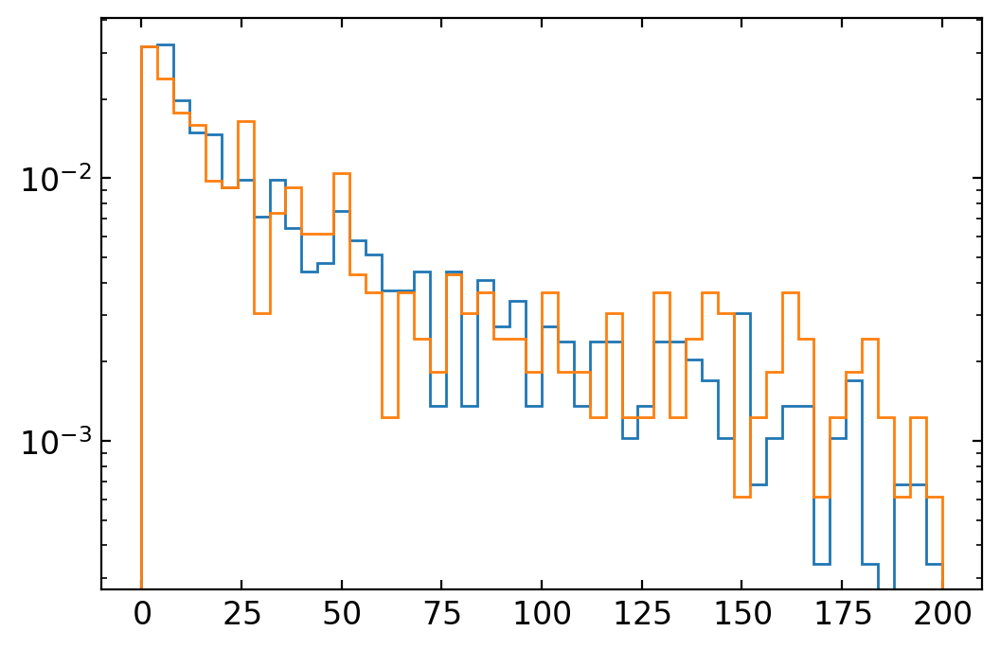

In [32]:
hist(Vertex_track_chi2[Vertex_G4ID<200],bins=50,range=(0,200),histtype="step",density=1);
hist(Vertex_track_chi2[Vertex_G4ID>200],bins=50,range=(0,200),histtype="step",density=1);
yscale("log")

### Vertex seed

In [27]:
dists=[]

for ievent in range(40):
    Tree.GetEntry(ievent)
    if Tree.Track_k_m_x0.size()>=2:
        tracks = []
        for track_ind in range(Tree.Track_k_m_x0.size()):
            track_1 =np.array([Tree.Track_k_m_x0.at(track_ind), Tree.Track_k_m_y0.at(track_ind), Tree.Track_k_m_z0.at(track_ind),Tree.Track_k_m_velX.at(track_ind), Tree.Track_k_m_velY.at(track_ind), Tree.Track_k_m_velZ.at(track_ind), Tree.Track_k_m_t0.at(track_ind)])
            tracks.append(track_1)

        residuals=[]
        for i in range(len(tracks)):
            for j in range(i+1, len(tracks)):
                position,t,dist = closest_approach_midpoint(tracks[i],tracks[j])
                dists.append(dist)
                
dists=np.array(dists)

Text(0.5, 0, 'Closest distance')

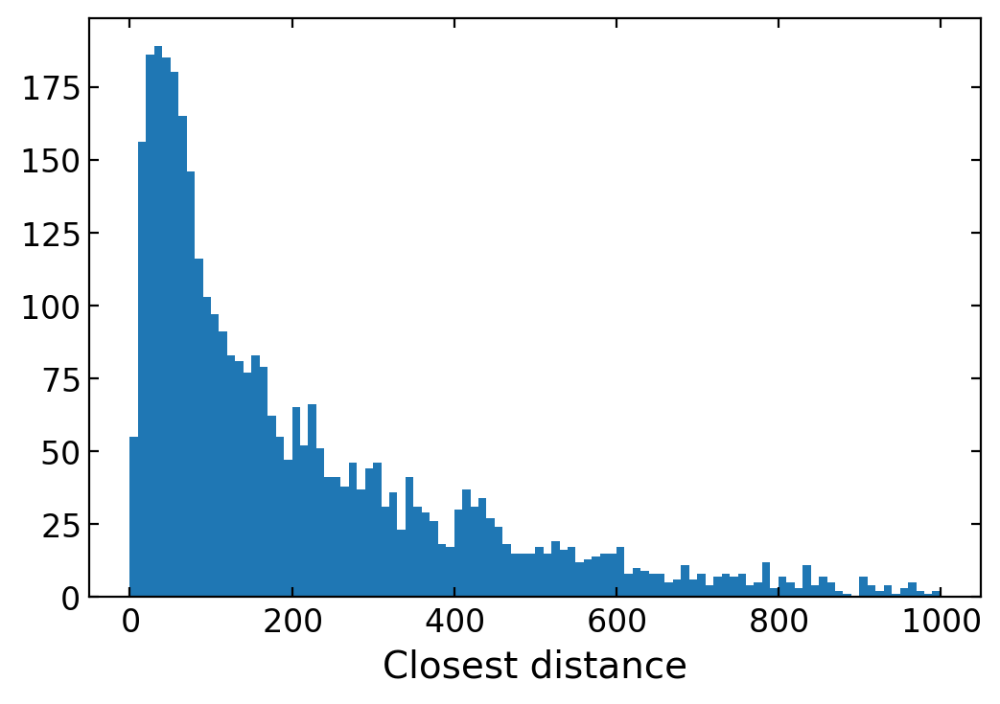

In [10]:
hist(dists,range=(0,1e3));
xlabel("Closest distance")

### Track seed

In [5]:
def test_compatible(v1, v2,length_threshold=0.05, angle_cos_threshold=0.2):
    """test_compatible([1,1,1],[2,5,2.4])"""
    l1 = np.linalg.norm(v1)
    l2 = np.linalg.norm(v2)
    if (l1-l2)/(l1+l2)>length_threshold:
        return False
    v1_normed = v1/l1
    v2_normed = v2/l2
    dot = np.dot(v1_normed,v2_normed)
    if abs(dot)>1:
        dot=1
    if np.abs(dot)<0.95:
        return False
    return True

In [45]:
ds_abs_cut=250
dss_abs = []
dss_rel = []
dss_rel_r = []
dss_c = []
dys=[]
dlayer=[]
mask_sametrack=[]


for ievent in range(10):

    ev = event.Event(filename, 0, tree_name=tree_name)
    ev.EventNumber=ievent

    hits = lsfit.get_digi_hits(ev)
    trackid = util.c2list(ev.Tree.Digi_track_id)
    c=29.97
    
    seeds_temp = [] # list of [x0,y0,z0,vx,vy,vz,t]
    for i in range(len(hits)):
        for j in range(i, len(hits)):
            if hits[i].hit_layer!=hits[j].hit_layer:
                # ds = np.sqrt((hits[i].x-hits[j].x)**2 + (hits[i].y-hits[j].y)**2 + (hits[i].z-hits[j].z)**2)/c/(hits[i].t-hits[j].t) -1 
                ds_abs = ((hits[i].x-hits[j].x)**2 + (hits[i].y-hits[j].y)**2 + (hits[i].z-hits[j].z)**2)/c**2-((hits[i].t-hits[j].t)**2) 
                # if abs(ds_abs)>ds_abs_cut:
                #     continue
                # if abs(hits[i].hit_layer-hits[j].hit_layer)<=2:
                #     continue
                
                ds_rel = ((hits[i].x-hits[j].x)**2 + (hits[i].y-hits[j].y)**2 + (hits[i].z-hits[j].z)**2)/c**2/((hits[i].t-hits[j].t)**2) -1 
                ds_rel_r = 1-c**2*((hits[i].t-hits[j].t)**2) /((hits[i].x-hits[j].x)**2 + (hits[i].y-hits[j].y)**2 + (hits[i].z-hits[j].z)**2)
                ds_c = np.sqrt((hits[i].x-hits[j].x)**2 + (hits[i].y-hits[j].y)**2 + (hits[i].z-hits[j].z)**2)/c/np.abs((hits[i].t-hits[j].t)) -1 
                dss_abs.append(ds_abs)
                dss_rel.append(ds_rel)
                dss_rel_r.append(ds_rel_r)
                dss_c.append(ds_c)
                dys.append(abs(hits[i].y-hits[j].y))
                dlayer.append(abs(hits[i].hit_layer-hits[j].hit_layer))
                if trackid[i]==trackid[j]:
                    mask_sametrack.append(True)
                else:
                    mask_sametrack.append(False)    
                    
                dx = hits[j].x-hits[i].x
                dy = hits[j].y-hits[i].y
                dz = hits[j].z-hits[i].z
                dt = hits[j].t-hits[i].t
                seeds_temp.append(np.array([hits[i].x+dx*0.5, hits[i].y+dy*0.5, hits[i].z+dz*0.5, dx/dt, dy/dt, dz/dt, hits[i].t+dt*0.5]))
                
#     seeds_ncomp_temp = np.zeros(len(seeds_temp))
#     for i in tqdm(range(len(seeds_temp))):
#         for j in range(i, len(seeds_temp)):
#             seed1 = seeds_temp[i]
#             seed2 = seeds_temp[j]
#             if (seed2-seed1)[-1]==0:
#                 continue
#             dv = (seed2-seed1)[:3]/(seed2-seed1)[-1] # dr/dt
#             v1 = seed1[3:6]
#             v2 = seed2[3:6]
#             if not test_compatible(v1,v2):
#                 continue
#             # elif not test_compatible((v1+v2)*0.5,dv):
#             #     continue
#             elif not test_compatible(v1,dv):
#                 continue
#             elif not test_compatible(v2,dv):
#                 continue                
#             else:
#                 seeds_ncomp_temp[i]+=1
#                 seeds_ncomp_temp[j]+=1
            
        
                
dss_abs=np.array(dss_abs)
dss_rel=np.array(dss_rel)
dss_rel_r=np.array(dss_rel_r)
dss_c=np.array(dss_c)
mask_sametrack=np.array(mask_sametrack)        
dys=np.array(dys)
dlayer=np.array(dlayer)

100%|██████████| 1072/1072 [00:21<00:00, 48.98it/s] 
0it [00:00, ?it/s]
  9%|▉         | 713/7813 [03:33<35:27,  3.34it/s]


KeyboardInterrupt: 

(-1.0, 150.0)

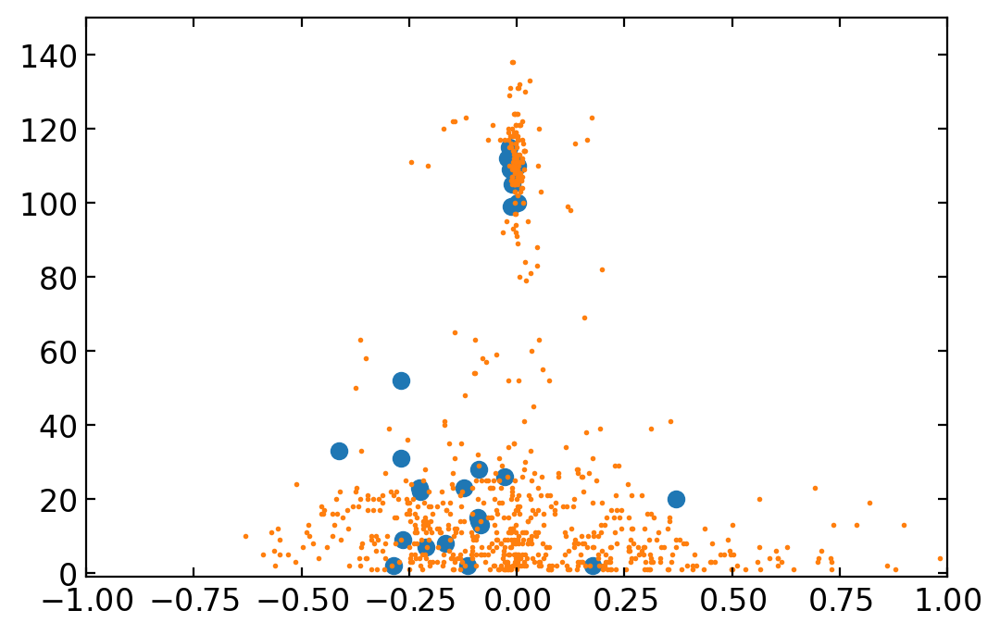

In [42]:
# scatter(dss_rel, seeds_ncomp_temp, s=1)
# xlim(-1,1)
# ylim(-1,50)

mask1=(seeds_ncomp_temp>0)&(mask_sametrack)
mask2=(seeds_ncomp_temp>0)&(~mask_sametrack)

# hist2d(dss_rel, seeds_ncomp_temp, range=((-1,1),(-1,50)),bins=(50,50), norm=LogNorm());
scatter(dss_rel[mask1], seeds_ncomp_temp[mask1])
scatter(dss_rel[mask2], seeds_ncomp_temp[mask2], s=1)
xlim(-1,1)
ylim(-1,150)


In [6]:
dlayer_unique = np.unique(dlayer)
print(dlayer_unique)

[  1   2   3   4   5   6   7 990 991 992 993 994 995 996 997]


In [29]:
# mask_dy = dlayer==dlayer_unique[2]
# n,ibins,p = hist(dss_abs[mask_sametrack],range=(-2,900),histtype="step");
# n1,ibins,p = hist(dss_abs[mask_sametrack&mask_dy],range=(-2,900),alpha=0.1,color="C0");
# n,ibins,p = hist(dss_abs[~mask_sametrack],range=(-2,900),histtype="step");
# n2,ibins,p = hist(dss_abs[~mask_sametrack&mask_dy],range=(-2,900),alpha=0.1,color="C1");
# yscale("log")
# axt = gca().twinx()
# axt.step(ibins[1:],n1/n2,color="r")
# axt.set_ylim(0,0.5)


# ds_abs_cut=20
# axvline(ds_abs_cut)
# sum(mask_sametrack&(dss_abs<ds_abs_cut)), sum(mask_sametrack&(dss_abs<ds_abs_cut))/sum(mask_sametrack),sum(~mask_sametrack&(dss_abs<ds_abs_cut)),sum(~mask_sametrack&(dss_abs<ds_abs_cut))/sum(~mask_sametrack)

(-1.0, 1.0)

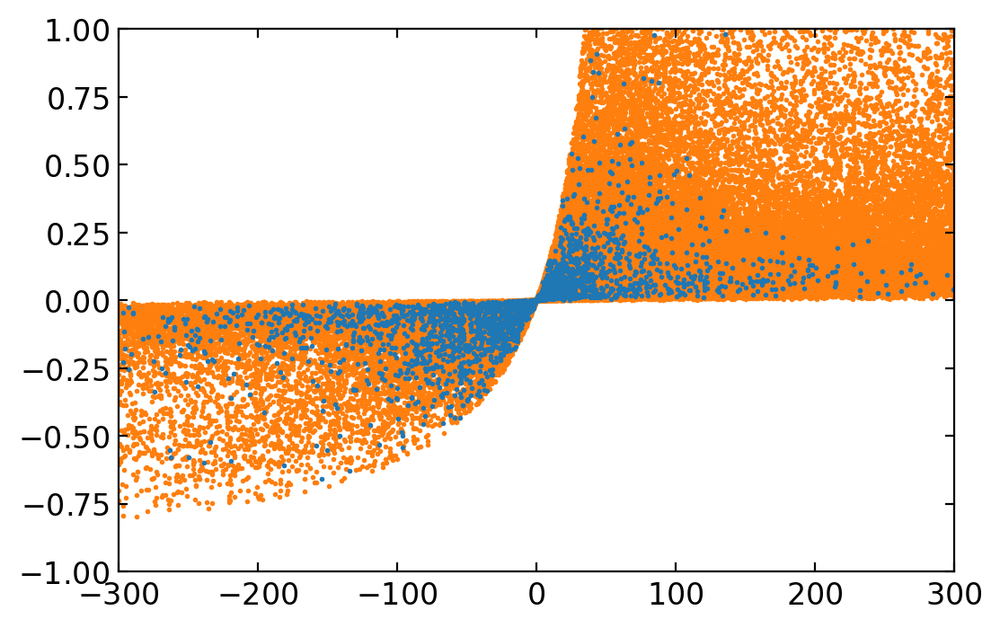

In [19]:
mask_layer =  (dlayer>2)&(dlayer<8)
mask_abs = (dss_abs<250)&(dss_abs>-250) 

scatter(dss_abs[~mask_sametrack&mask_layer],dss_rel[~mask_sametrack&mask_layer], s=1,color="C1")
scatter(dss_abs[mask_sametrack&mask_layer],dss_rel[mask_sametrack&mask_layer], s=1,color="C0")
xlim(-300,300)
ylim(-1,1)

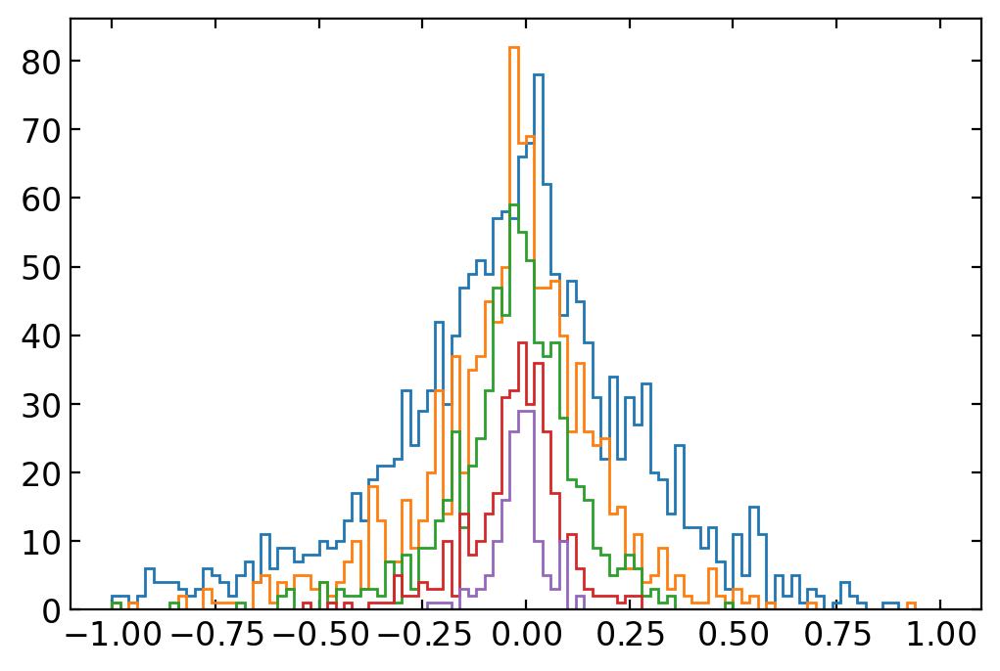

/tmp/ipykernel_14995/393409243.py:24: RuntimeWarning: invalid value encountered in true_divide
  axt.step(ibins[1:],n1/n2,color="r")


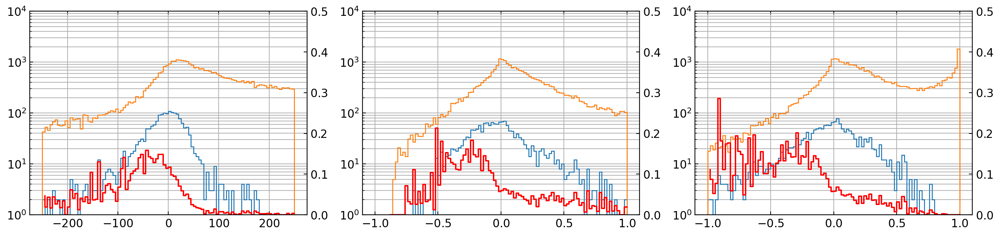

/tmp/ipykernel_14995/393409243.py:24: RuntimeWarning: invalid value encountered in true_divide
  axt.step(ibins[1:],n1/n2,color="r")


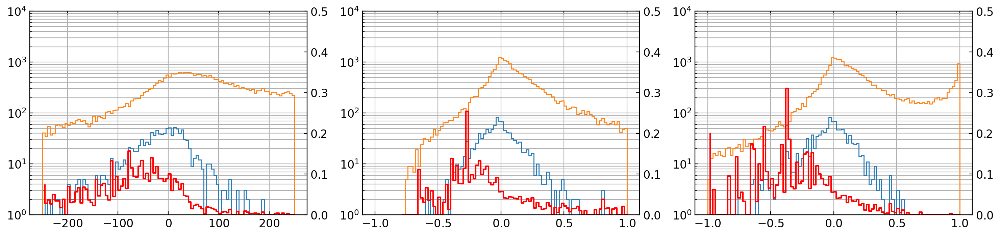

/tmp/ipykernel_14995/393409243.py:24: RuntimeWarning: invalid value encountered in true_divide
  axt.step(ibins[1:],n1/n2,color="r")


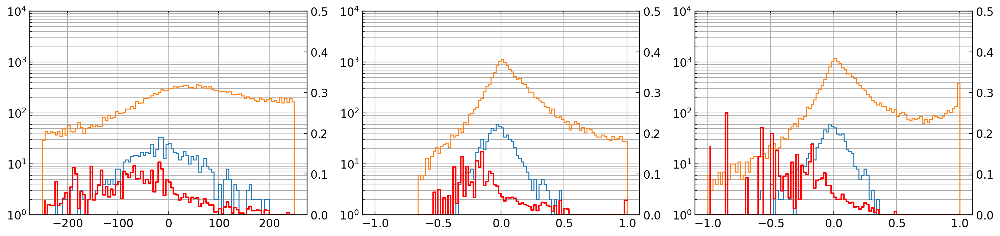

/tmp/ipykernel_14995/393409243.py:24: RuntimeWarning: divide by zero encountered in true_divide
  axt.step(ibins[1:],n1/n2,color="r")
/tmp/ipykernel_14995/393409243.py:24: RuntimeWarning: invalid value encountered in true_divide
  axt.step(ibins[1:],n1/n2,color="r")
/tmp/ipykernel_14995/393409243.py:34: RuntimeWarning: invalid value encountered in true_divide
  axt.step(ibins[1:],n1/n2,color="r")


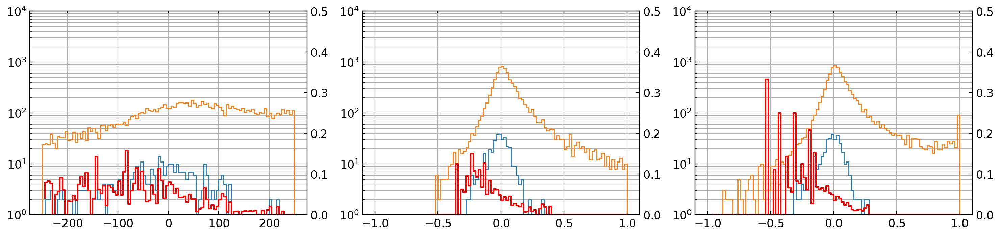

/tmp/ipykernel_14995/393409243.py:24: RuntimeWarning: invalid value encountered in true_divide
  axt.step(ibins[1:],n1/n2,color="r")
/tmp/ipykernel_14995/393409243.py:34: RuntimeWarning: divide by zero encountered in true_divide
  axt.step(ibins[1:],n1/n2,color="r")
/tmp/ipykernel_14995/393409243.py:34: RuntimeWarning: invalid value encountered in true_divide
  axt.step(ibins[1:],n1/n2,color="r")


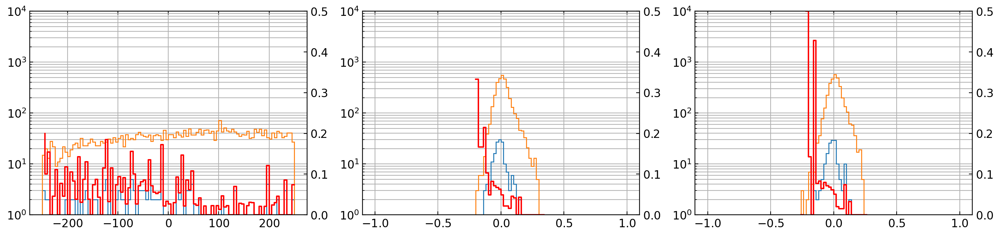

In [36]:
for layer in range(2,7):
    hist(dss_rel_r[mask_sametrack&mask_abs&(dlayer==layer)], range=(-1,1),histtype="step")
show()

for layer in range(2,7):
    fig,axs = subplots(1,3,figsize=(18,4))
    sca(axs[0])
    n1,ibins,p=hist(dss_abs[mask_sametrack&mask_abs&(dlayer==layer)], range=(-250,250),histtype="step")
    n2,ibins,p=hist(dss_abs[~mask_sametrack&mask_abs&(dlayer==layer)], range=(-250,250),histtype="step")
    ylim(1,1e4)
    grid(which="both")
    yscale("log")
    axt = gca().twinx()
    axt.step(ibins[1:],n1/n2,color="r")
    axt.set_ylim(0,0.5)
    
    sca(axs[1])
    n1,ibins,p=hist(dss_rel[mask_sametrack&mask_abs&(dlayer==layer)], range=(-1,1),histtype="step")
    n2,ibins,p=hist(dss_rel[~mask_sametrack&mask_abs&(dlayer==layer)], range=(-1,1),histtype="step")
    ylim(1,1e4)
    grid(which="both")
    yscale("log")
    axt = gca().twinx()
    axt.step(ibins[1:],n1/n2,color="r")
    axt.set_ylim(0,0.5)    
    
    sca(axs[2])
    n1,ibins,p=hist(dss_rel_r[mask_sametrack&mask_abs&(dlayer==layer)], range=(-1,1),histtype="step")
    n2,ibins,p=hist(dss_rel_r[~mask_sametrack&mask_abs&(dlayer==layer)], range=(-1,1),histtype="step")
    ylim(1,1e4)
    grid(which="both")
    yscale("log")
    axt = gca().twinx()
    axt.step(ibins[1:],n1/n2,color="r")
    axt.set_ylim(0,0.5)    
    
    show()

findfont: Font family ['san-serif'] not found. Falling back to DejaVu Sans.


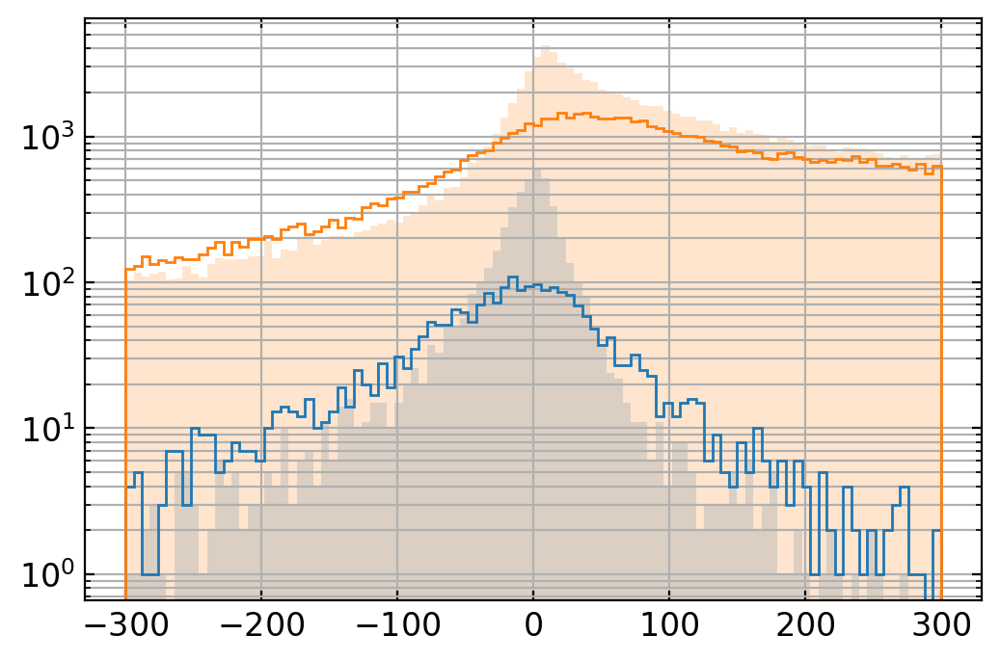

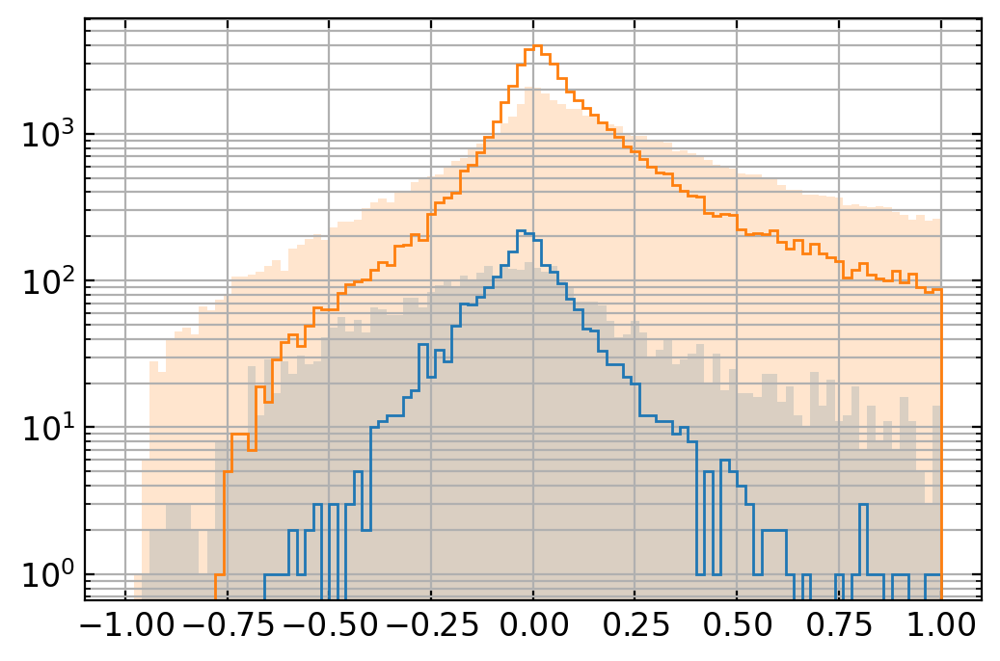

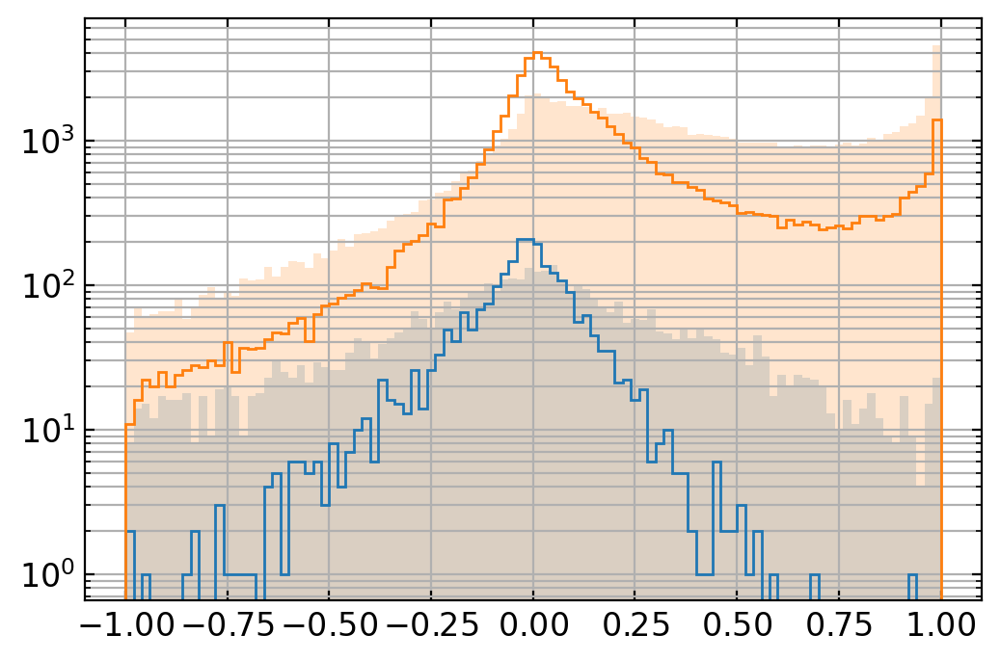

In [6]:
mask_layer =  (dlayer>2)&(dlayer<8)
mask_layer_1 =  (dlayer<=2)
mask_abs = (dss_abs<250)&(dss_abs>-250) 
# mask_abs = (dss_abs<-25)|(dss_abs>25) 


n1,ibins,p = hist(dss_abs[mask_sametrack&mask_layer],range=(-300,300),histtype="step");
n1,ibins,p = hist(dss_abs[mask_sametrack&mask_layer_1],range=(-300,300),alpha=0.2,color="C0");
n2,ibins,p = hist(dss_abs[~mask_sametrack&mask_layer],range=(-300,300),histtype="step");
n2,ibins,p = hist(dss_abs[~mask_sametrack&mask_layer_1],range=(-300,300),alpha=0.2,color="C1");
yscale("log")
grid(which="both")
show()

n1,ibins,p = hist(dss_rel[mask_sametrack&mask_layer&mask_abs],range=(-1,1),histtype="step");
n1,ibins,p = hist(dss_rel[mask_sametrack&mask_layer_1&mask_abs],range=(-1,1),alpha=0.2,color="C0");
n2,ibins,p = hist(dss_rel[~mask_sametrack&mask_layer&mask_abs],range=(-1,1),histtype="step");
n2,ibins,p = hist(dss_rel[~mask_sametrack&mask_layer_1&mask_abs],range=(-1,1),alpha=0.2,color="C1");
yscale("log")
grid(which="both")
show()

n1,ibins,p = hist(dss_rel_r[mask_sametrack&mask_layer&mask_abs],range=(-1,1),histtype="step");
n1,ibins,p = hist(dss_rel_r[mask_sametrack&mask_layer_1&mask_abs],range=(-1,1),alpha=0.2,color="C0");
n2,ibins,p = hist(dss_rel_r[~mask_sametrack&mask_layer&mask_abs],range=(-1,1),histtype="step");
n2,ibins,p = hist(dss_rel_r[~mask_sametrack&mask_layer_1&mask_abs],range=(-1,1),alpha=0.2,color="C1");
yscale("log")
grid(which="both")
show()




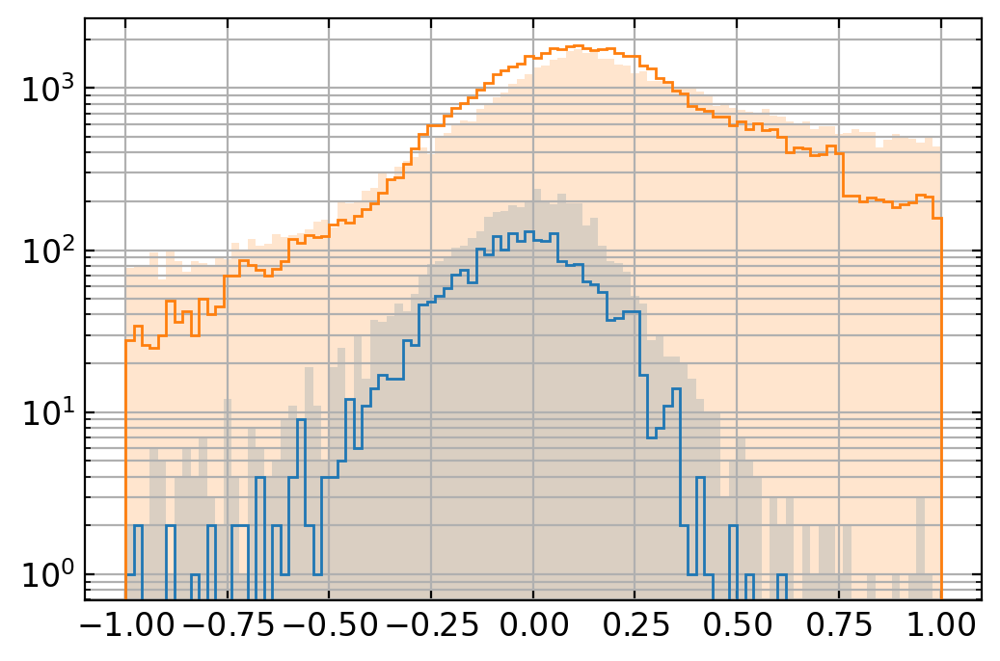

In [9]:
n1,ibins,p = hist((dss_abs/dys)[mask_sametrack&mask_layer&mask_abs],range=(-1,1),histtype="step");
n1,ibins,p = hist((dss_abs/dys)[mask_sametrack&mask_layer_1&mask_abs],range=(-1,1),alpha=0.2,color="C0");
n2,ibins,p = hist((dss_abs/dys)[~mask_sametrack&mask_layer&mask_abs],range=(-1,1),histtype="step");
n2,ibins,p = hist((dss_abs/dys)[~mask_sametrack&mask_layer_1&mask_abs],range=(-1,1),alpha=0.2,color="C1");
yscale("log")
grid(which="both")
show()

In [33]:
sum(mask_layer&mask_abs), sum(mask_layer&mask_abs&(abs(dss_rel)<0.25)), sum(mask_layer&mask_abs&(abs(dss_rel_r)<0.25))

(62273, 41838, 43476)

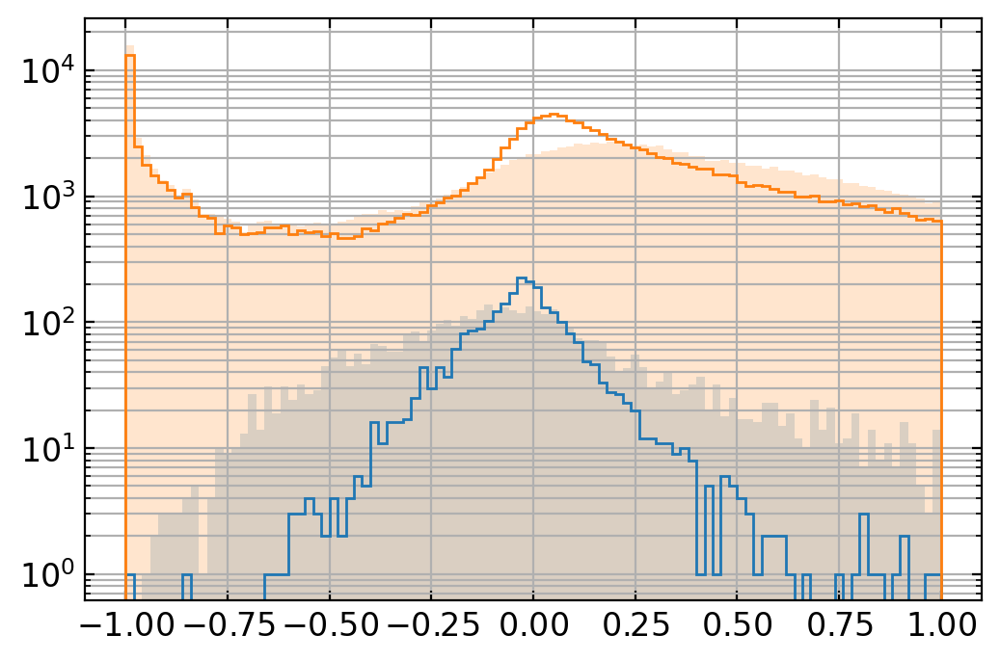

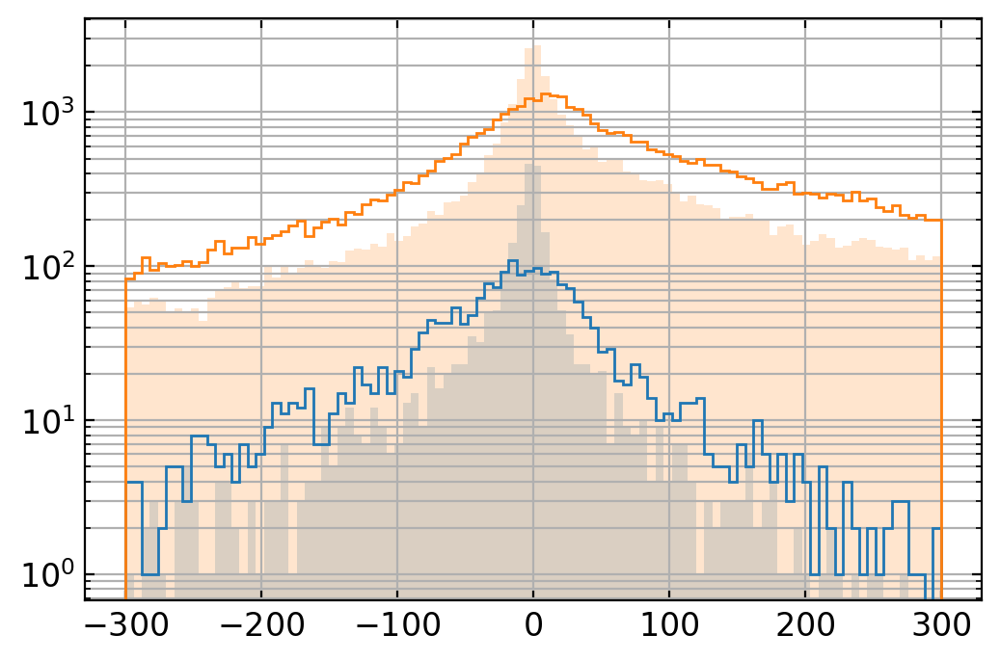

In [29]:
mask_layer =  (dlayer>2)&(dlayer<8)
mask_layer_1 =  (dlayer<=2)
mask_rel = (dss_rel<0.25)&(dss_rel>-0.25) 
# mask_abs = (dss_abs<-25)|(dss_abs>25) 


n1,ibins,p = hist(dss_rel[mask_sametrack&mask_layer],range=(-1,1),histtype="step");
n1,ibins,p = hist(dss_rel[mask_sametrack&mask_layer_1],range=(-1,1),alpha=0.2,color="C0");
n2,ibins,p = hist(dss_rel[~mask_sametrack&mask_layer],range=(-1,1),histtype="step");
n2,ibins,p = hist(dss_rel[~mask_sametrack&mask_layer_1],range=(-1,1),alpha=0.2,color="C1");
yscale("log")
grid(which="both")
show()

n1,ibins,p = hist(dss_abs[mask_sametrack&mask_layer&mask_rel],range=(-300,300),histtype="step");
n1,ibins,p = hist(dss_abs[mask_sametrack&mask_layer_1&mask_rel],range=(-300,300),alpha=0.2,color="C0");
n2,ibins,p = hist(dss_abs[~mask_sametrack&mask_layer&mask_rel],range=(-300,300),histtype="step");
n2,ibins,p = hist(dss_abs[~mask_sametrack&mask_layer_1&mask_rel],range=(-300,300),alpha=0.2,color="C1");
yscale("log")
grid(which="both")
show()



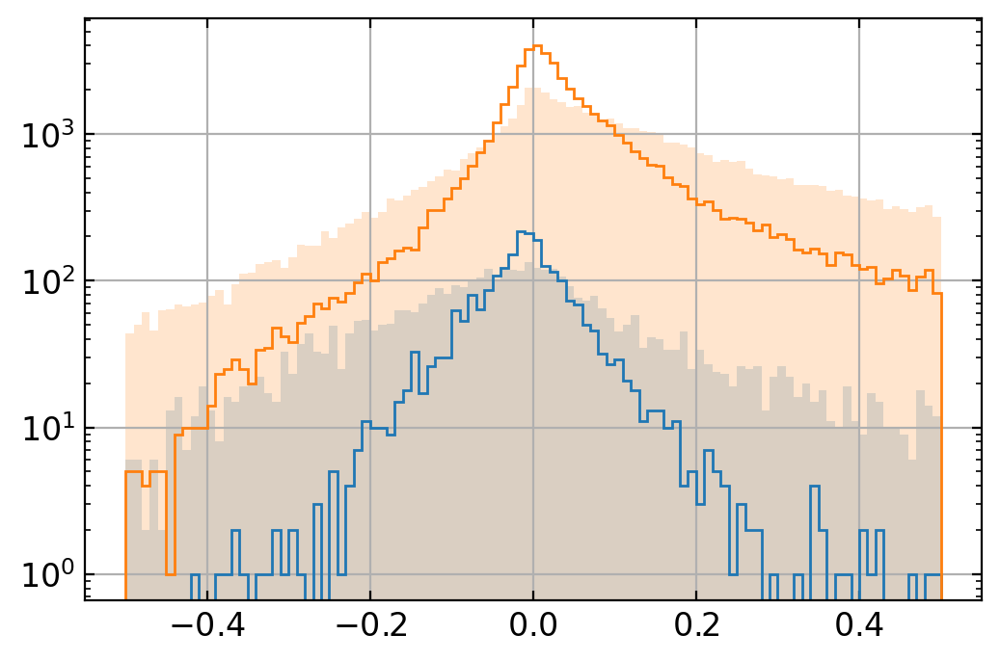

In [26]:
n1,ibins,p = hist(dss_c[mask_sametrack&mask_layer&mask_abs],range=(-0.5,0.5),histtype="step");
n1,ibins,p = hist(dss_c[mask_sametrack&mask_layer_1&mask_abs],range=(-0.5,0.5),alpha=0.2,color="C0");
n2,ibins,p = hist(dss_c[~mask_sametrack&mask_layer&mask_abs],range=(-0.5,0.5),histtype="step");
n2,ibins,p = hist(dss_c[~mask_sametrack&mask_layer_1&mask_abs],range=(-0.5,0.5),alpha=0.2,color="C1");
yscale("log")
grid()
show()

### Adaptive weight

In [ ]:
def calc_adaptive_weight(chi2):
    a = np.exp(-chi2/(2*adaptive_temperature));
    b = np.exp(-adaptive_chi2_cutoff/(2*adaptive_temperature));
    return (a/(a+b));

adaptive_temperature = 15
adaptive_chi2_cutoff=30
chi2_list = np.linspace(0,100,100)
plot(chi2_list, calc_adaptive_weight(chi2_list))

adaptive_temperature = 3
adaptive_chi2_cutoff=30
chi2_list = np.linspace(0,100,100)
plot(chi2_list, calc_adaptive_weight(chi2_list))

# Inspect result

In [5]:
filename = "scripts/data/20230614/235929/stat0.root"
filename = "~/mathusla/data/fit_study_6layer/LLP_debug/stat0.root"
# filename = "scripts/data/20230614/235929/stat_original.root"
# filename="/project/def-mdiamond/tomren/mathusla/data/LLP/LLP_test_bb_20/20230617/213934/stat0.root"

tfile = root.TFile.Open(filename)
tree_name = tfile.GetListOfKeys()[0].GetName()

ev = event.Event(filename, 0, tree_name=tree_name)

ev.EventNumber=9
ev.Tree.GetEntry(ev.EventNumber)

367722

In [6]:
reload(vis)

<module 'visualization' from '/project/6035200/tomren/jupyter/tracker_6layers/visualization.py'>

[[5.0, 8.0, 9.0, 1.0, 7.0, 6.0, 0.0, 2.0, 3.0]]


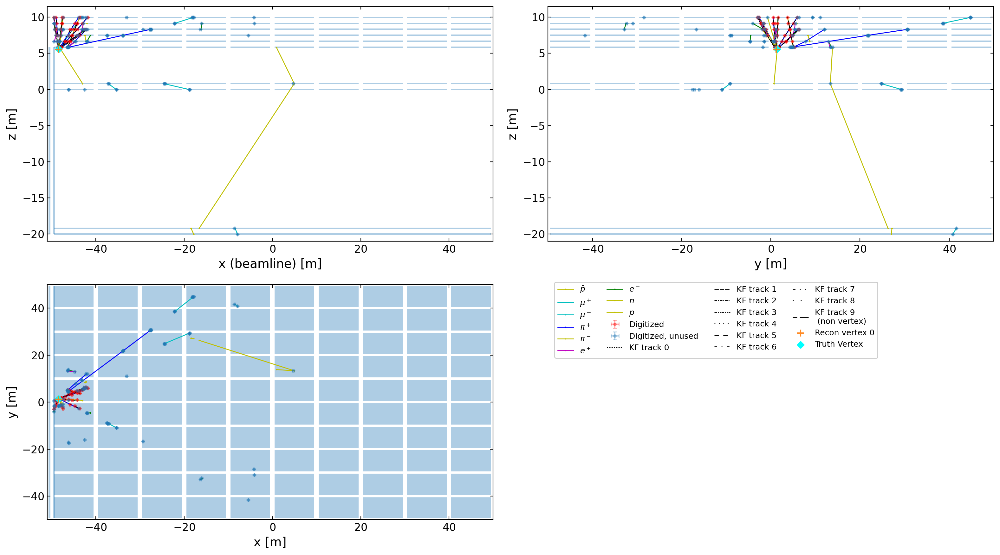

In [12]:
ev = event.Event(filename, 0, tree_name=tree_name)


ev.EventNumber=0
ev.Tree.GetEntry(ev.EventNumber)

fig,axs=plt.subplots(2,2,figsize=(16,9))
fig = vis.plot_truth(ev,fig=fig, disp_det_view=True, disp_filereader_vertex=True, disp_first_hit=False,make_legend=False);
fig = vis.plot_recon(ev,fig=fig, disp_det_view=True, disp_recon_vertex=True,force_limit=True,make_legend=True, disp_vertex_track_extension=True);
axs = fig.axes

print(util.unzip(ev.Tree.Vertex_k_m_trackIndices))
# plt.savefig("test.jpg")
# axs[0].set_xlim(-50,-40)
# axs[0].set_ylim(-0,10)
# axs[1].set_xlim(-0,10)
# axs[1].set_ylim(-0,10)
# axs[2].set_xlim(-50,-40)
# axs[2].set_ylim(-0,10)

In [24]:
Digi_track_id = np.sort(util.c2list(ev.Tree.Digi_track_id))
Digi_track_id_unique = np.unique(Digi_track_id)
for id in Digi_track_id_unique:
    if sum(Digi_track_id==id)>=4:
        print(f"{id}\t {sum(Digi_track_id==id)} \t {sum(Digi_track_id==id)>=4}")

7	 9 	 True
10	 7 	 True
13	 4 	 True
14	 9 	 True
16	 4 	 True
17	 6 	 True
11156	 4 	 True
459472	 4 	 True
492471	 5 	 True
503371	 10 	 True
537964	 6 	 True
537969	 6 	 True
547880	 4 	 True
547882	 5 	 True
547885	 5 	 True
547886	 4 	 True
547888	 6 	 True
725418	 4 	 True
918783	 5 	 True
918784	 4 	 True
1039319	 4 	 True
1058209	 5 	 True
1075331	 5 	 True
1096740	 8 	 True
1096741	 4 	 True
1484604	 7 	 True
1499217	 5 	 True
1513459	 4 	 True
1556924	 5 	 True
1558500	 4 	 True
1613688	 4 	 True


In [18]:
track_km_inds = np.array(util.unzip(util.c2list(ev.Tree.Track_k_m_ids)),dtype=object)
track_km_g4inds = np.array([min(i) for i in track_km_inds])
vertex_track_inds=util.unzip(np.array(util.c2list(ev.Tree.Vertex_k_m_trackIndices),dtype=int))
vertex_track_g4inds = [np.sort(track_km_g4inds[ind]) for ind in vertex_track_inds]
print("Geant4 index of particles in vertex\n", vertex_track_g4inds)
print("Geant4 index of particles in each track\n", track_km_inds)

Geant4 index of particles in vertex
 [array([      1,       7,       8,      10,      12,      12,      14,
            17,      17,  503371,  547886, 1039319, 1096740, 1096740,
       1486279]), array([537969, 547880, 918783, 918783]), array([    16, 482836]), array([1484604, 1484604]), array([1058209, 1096740]), array([16, 16])]
Geant4 index of particles in each track
 [list([12, 537964, 537964, 537964, 537964, 537964])
 list([1096740, 1096740, 1273125, 1321123])
 list([1096740, 1096741, 1273124, 1273124, 1139517, 1096741])
 list([8, 1075331, 1075331, 1075331, 1075331, 1075331])
 list([16, 1572618, 459342, 1571225])
 list([1499217, 1486279, 1499217, 1499217, 1499217])
 list([17, 17, 10618, 11156])
 list([918783, 918784, 918784, 918784, 918784])
 list([537969, 537969, 537969, 537969, 537969])
 list([14, 14, 14, 14, 14, 14, 14, 14])
 list([237640, 237639, 237639, 10618])
 list([547886, 547886, 547886, 547886])
 list([10, 1058209, 10, 10, 10, 10, 10])
 list([503371, 503371, 503371, 5033

===========================Event 0==============================
[[5.0, 6.0, 9.0, 8.0, 7.0, 1.0, 4.0, 0.0], [2.0, 3.0]]


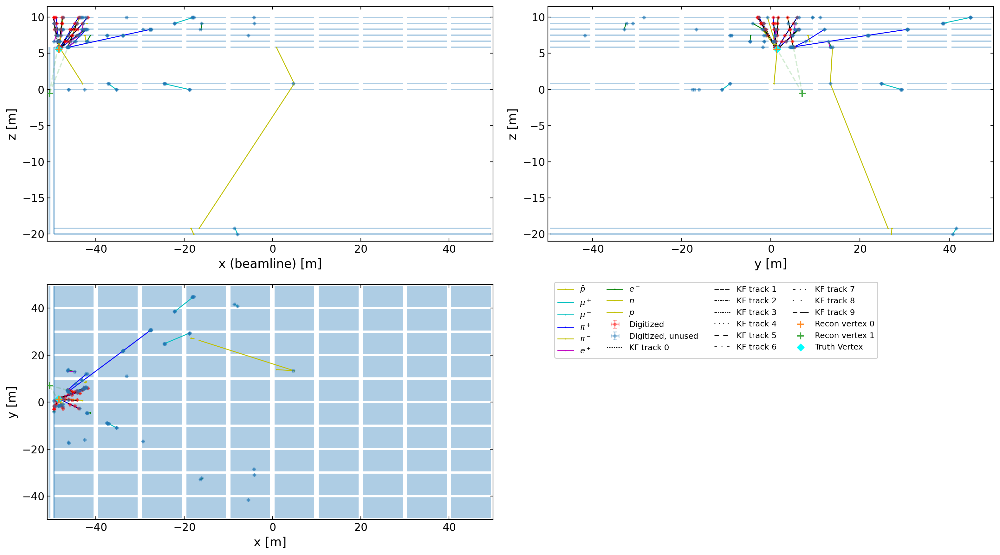

Geant4 index of particles in vertex
 [array([    2,     8,    12,    12,    19,    22,    25, 55312]), array([   30, 14563])]
Geant4 index of particles in each track
 [list([22, 86482, 86481, 86481, 86481]) list([8, 8, 8, 162887])
 list([31, 30, 30, 30]) list([14563, 14564, 14564, 14564, 14564])
 list([2, 72322, 72322, 72322]) list([25, 25, 25, 25, 25, 25])
 list([55312, 55312, 55312, 55312]) list([12, 14, 14, 14])
 list([25, 12, 12, 12, 12]) list([19, 72321, 38338, 72322])]
===========================Event 1==============================
[]


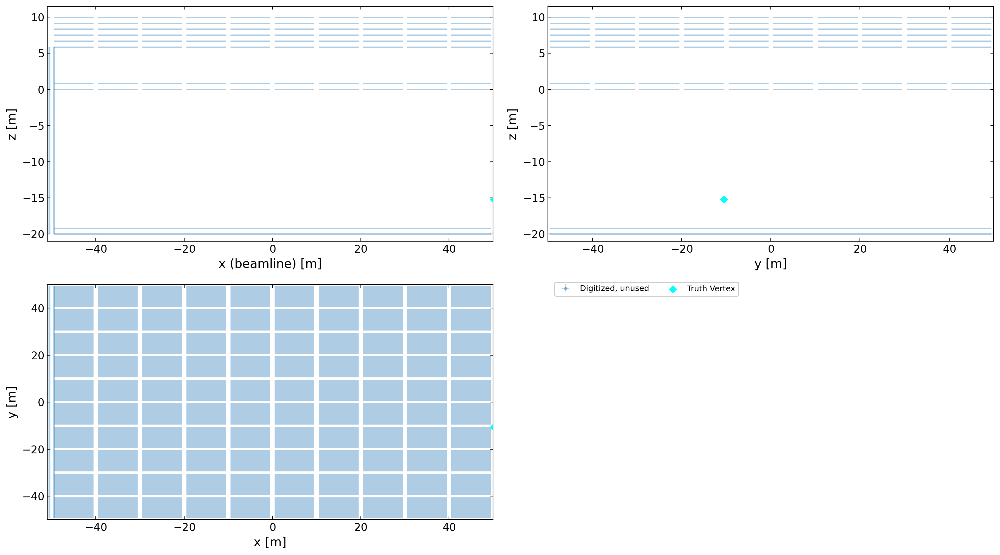

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 2==============================
[[2.0, 5.0, 0.0, 22.0, 11.0, 4.0, 16.0, 10.0, 8.0, 6.0, 17.0, 9.0, 15.0, 7.0], [1.0, 12.0], [14.0, 18.0], [3.0, 19.0], [13.0, 21.0]]


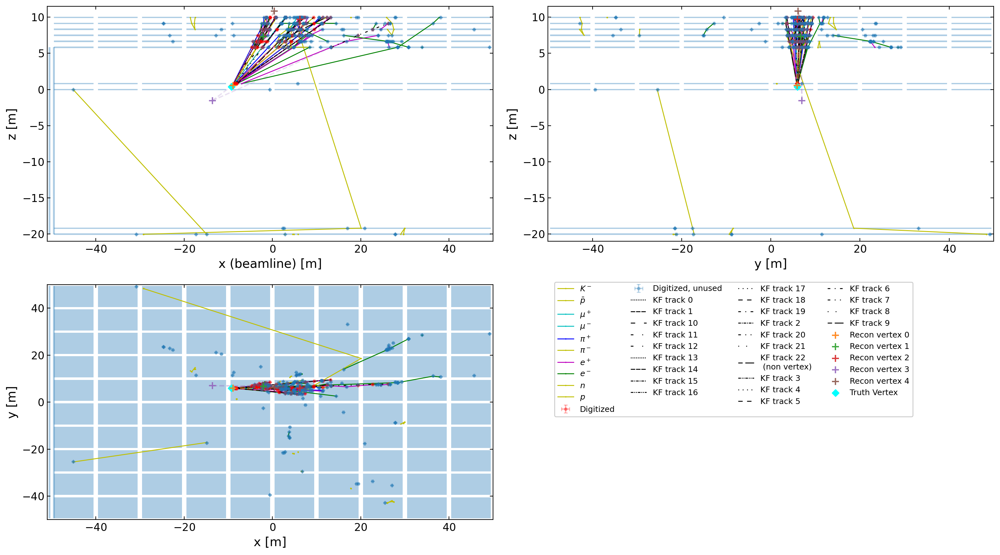

Geant4 index of particles in vertex
 [array([     1,      4,      4,     10,     10,     18,     30,  64771,
        98847,  98847,  98848, 627716, 689716, 772229]), array([ 5, 30]), array([18, 18]), array([     8, 229144]), array([    5, 64770])]
Geant4 index of particles in each track
 [list([913387, 627716, 635385, 635386]) list([64770, 5, 5, 570411])
 list([18, 304106, 304107, 304106, 304106, 304106, 304107])
 list([8, 8, 8, 8, 797685]) list([10, 17, 17, 17, 17, 17])
 list([1, 206336, 206336, 206336, 206336, 227968, 206336])
 list([875846, 98847, 98847, 98847, 98847])
 list([64771, 64771, 64771, 64771]) list([4, 5, 570411, 570412, 579952])
 list([98847, 304106, 304106, 366364])
 list([10, 627716, 913387, 627716, 627716, 913387])
 list([4, 4, 4, 4, 935362, 935355]) list([30, 234411, 570411, 595687])
 list([98, 30, 5, 596433]) list([18, 689785, 700207, 700208])
 list([206335, 30, 30, 30])
 list([1006032, 772229, 1005941, 1005941, 1005941])
 list([771543, 689716, 689716, 722050])
 lis

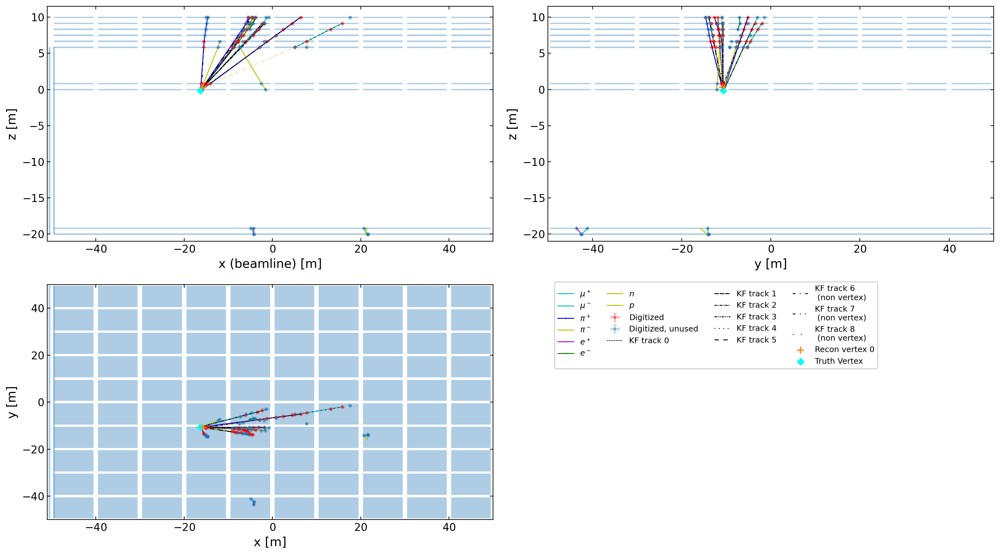

Geant4 index of particles in vertex
 [array([     5,      6,      6,      8,     13, 269854])]
Geant4 index of particles in each track
 [list([8, 5, 5, 5]) list([6, 14, 14, 14]) list([14, 6, 6, 6, 6, 6, 6])
 list([17, 13, 13, 13, 13, 13, 13]) list([16, 55719, 55719, 55719, 55719])
 list([13, 16, 15, 15, 15, 15, 15]) list([269854, 269854, 269854, 269854])
 list([11, 8, 8, 8]) list([5, 86, 86, 86])]
===========================Event 4==============================
[[0.0, 1.0]]


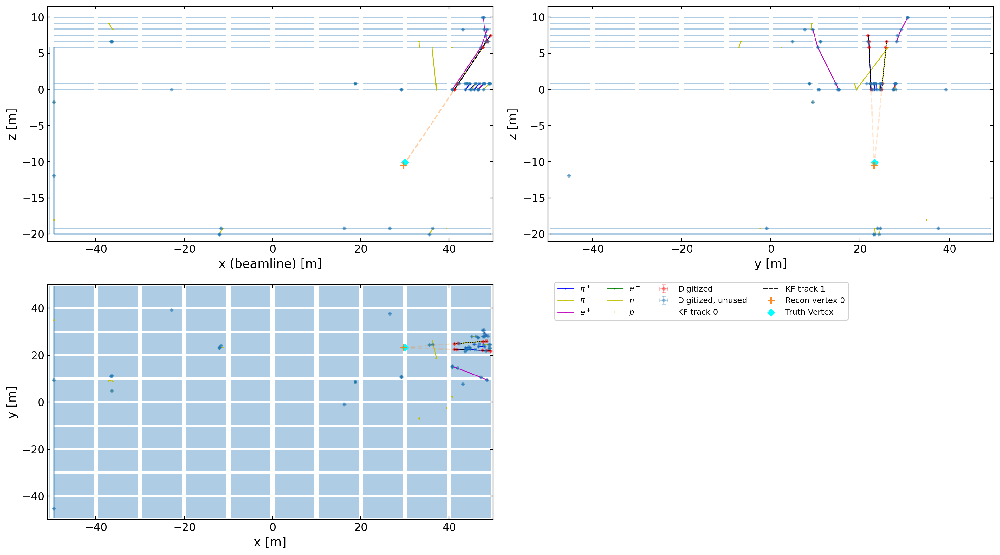

Geant4 index of particles in vertex
 [array([ 4, 24])]
Geant4 index of particles in each track
 [list([24, 24, 24, 24]) list([4, 4, 4, 4, 4])]
===========================Event 5==============================
[[12.0, 17.0, 4.0, 24.0, 6.0, 22.0, 2.0, 10.0, 13.0, 9.0, 19.0, 5.0, 7.0, 0.0], [1.0, 15.0, 20.0, 21.0], [8.0, 14.0]]


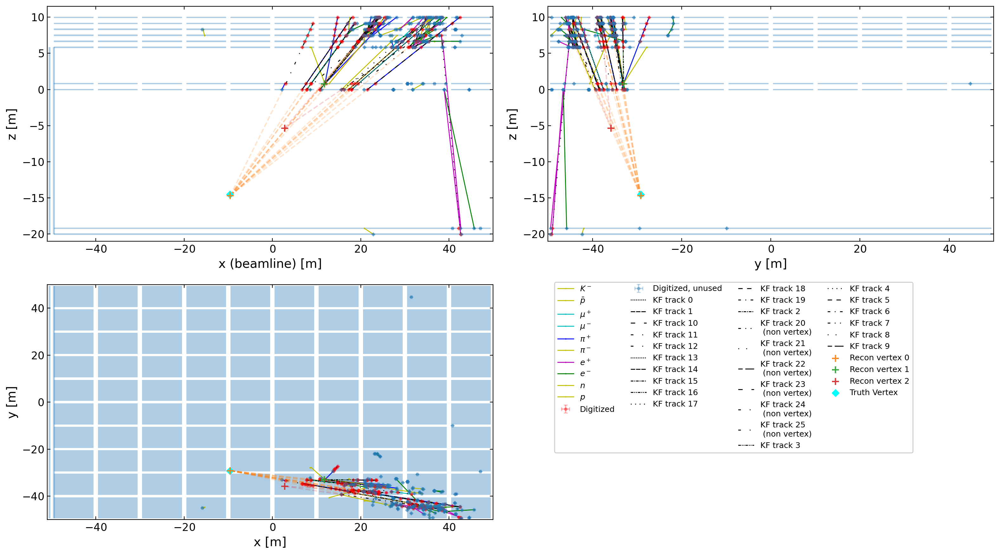

Geant4 index of particles in vertex
 [array([      1,       7,       8,      10,      10,      14,      17,
        503371,  547885, 1096740, 1096740, 1096741, 1484604, 1486281]), array([    12,     12, 537969, 918783]), array([    16, 547881])]
Geant4 index of particles in each track
 [list([1484604, 1484604, 1484604, 1484604])
 list([12, 537964, 725418, 547882, 725418, 827579])
 list([1096741, 1096741, 1273124, 1273124, 1096741])
 list([1273124, 1273125, 1273125, 1274880]) list([17, 17, 17, 17, 10616])
 list([8, 1075331, 1075331, 1075331, 1075331, 1075331])
 list([10, 1058209, 10, 1058209, 10, 10])
 list([547885, 547885, 547886, 547886])
 list([1096740, 1096740, 1096740, 547881, 1343549])
 list([1096740, 1096740, 1139517, 1096740])
 list([1277023, 1096741, 1096740, 1163151])
 list([237639, 237640, 238196, 238196])
 list([503371, 503371, 503371, 503371, 503371, 503371, 503371, 503371])
 list([1, 1, 1613688, 1613688, 1613688])
 list([16, 1572618, 459342, 1558500])
 list([12, 918783, 91

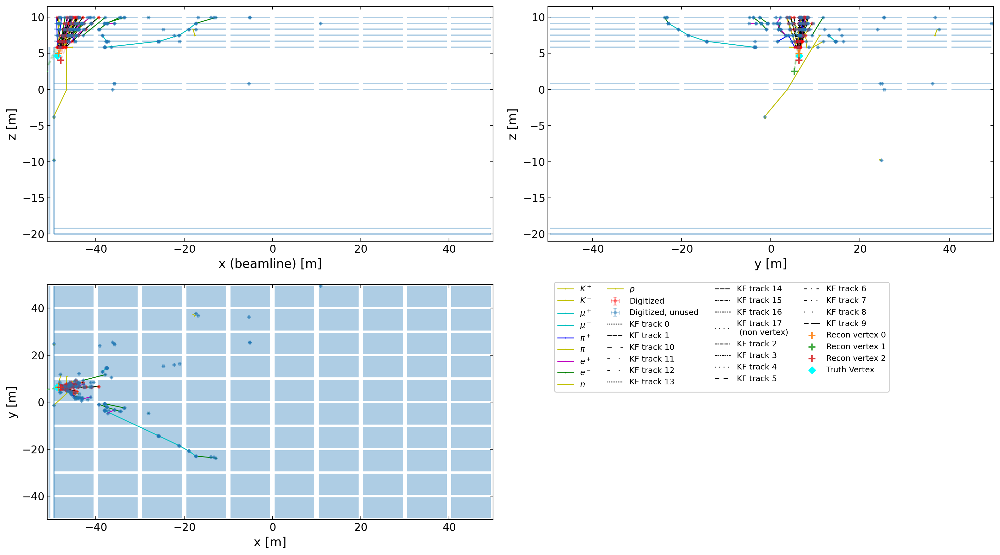

Geant4 index of particles in vertex
 [array([    7,     7,     8,    10,    14,    14,    14,    17,    17,
          20,    32, 67050]), array([ 1, 17, 31]), array([ 7, 11])]
Geant4 index of particles in each track
 [list([10, 67050, 10, 10, 10]) list([17, 32, 18, 311843, 311843, 311844])
 list([11, 96702, 295031, 295031, 295031]) list([31, 31, 31, 14])
 list([17, 17, 53206, 375775]) list([11, 8, 26, 26, 26])
 list([437574, 311843, 437580, 437580, 437580]) list([375775, 17, 17, 17])
 list([7, 96702, 96702, 96702, 96702]) list([32, 32, 32, 32])
 list([1, 15, 406975, 406975]) list([14, 406975, 406974, 375775])
 list([67051, 67947, 67050, 67050, 67050, 67050])
 list([20, 196920, 20, 20]) list([67050, 20, 7, 7])
 list([18, 14, 14, 437536]) list([437535, 375775, 31, 315967])
 list([7, 17, 53217, 18])]
===========================Event 7==============================
[]


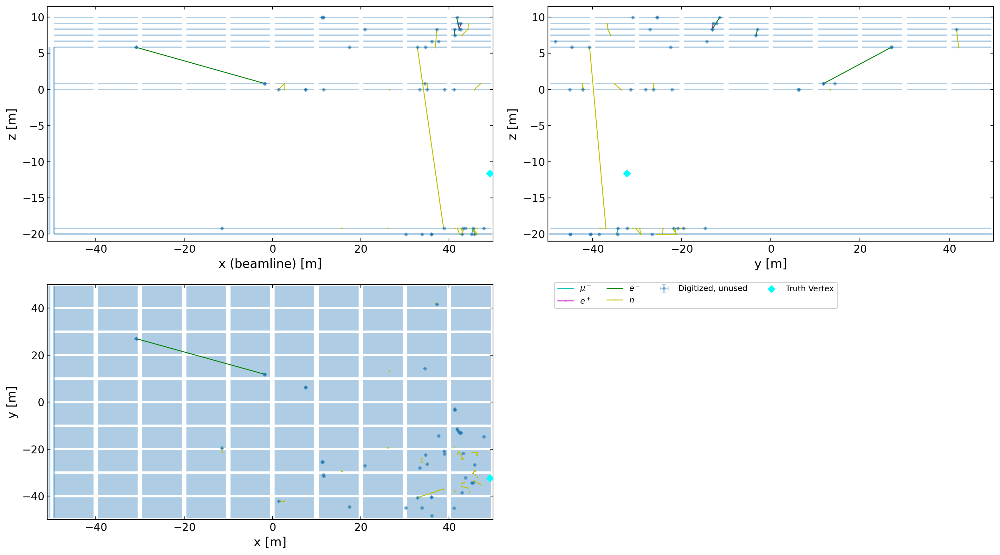

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 8==============================
[]


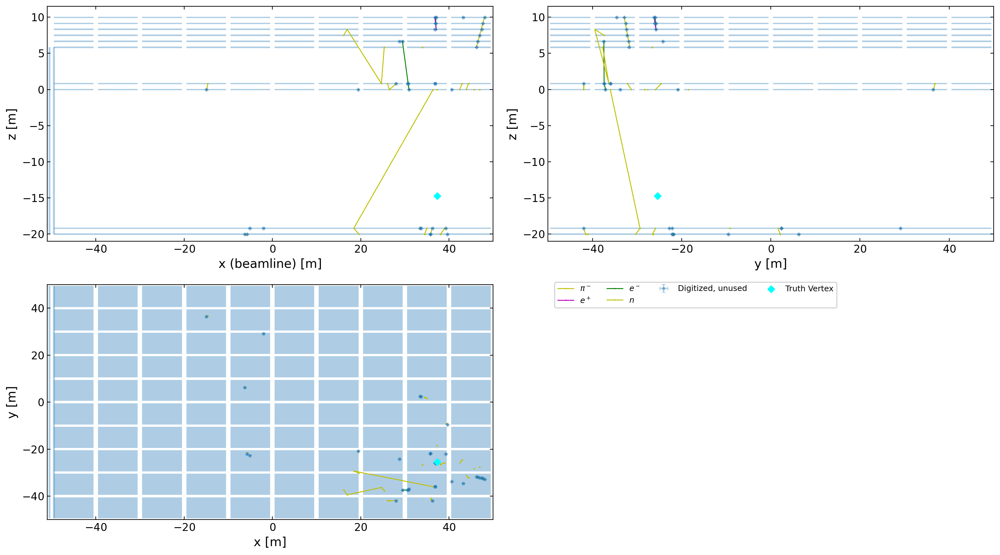

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 9==============================
[[16.0, 19.0, 14.0, 12.0, 2.0, 9.0, 11.0, 8.0, 0.0, 18.0], [5.0, 22.0, 17.0, 7.0, 21.0], [1.0, 6.0, 3.0], [10.0, 15.0, 25.0]]


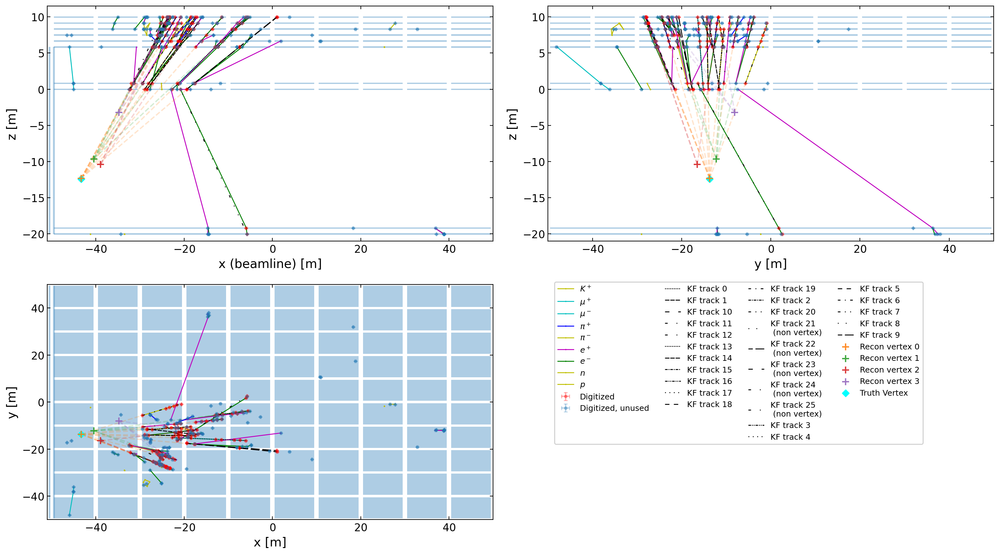

Geant4 index of particles in vertex
 [array([     7,      9,     11,     12,     17,     17,     19,     24,
       212530, 428235]), array([    11,     22,     22, 266842, 774649]), array([    17,     17, 608023]), array([   18,    31, 98270])]
Geant4 index of particles in each track
 [list([561181, 429054, 428235, 429054])
 list([605709, 604234, 17, 17, 429054])
 list([212530, 212530, 212530, 212530, 212530, 212530])
 list([17, 561180, 607640, 561181, 561181])
 list([561158, 428620, 605709, 605709])
 list([22, 205624, 31, 98034, 79512])
 list([660898, 608023, 608023, 608023, 608023])
 list([266843, 266842, 275621, 266842]) list([19, 19, 19, 19, 19, 309766])
 list([17, 561181, 561181, 561181]) list([98269, 98270, 31, 39876])
 list([17, 17, 581204, 17]) list([11, 11, 11, 11, 11])
 list([9, 9, 9, 714516]) list([24, 24, 24, 24, 24, 24])
 list([18, 319968, 337359, 319968, 319968]) list([7, 7, 7, 7, 7, 7, 7])
 list([774649, 774650, 774650, 774792]) list([9, 752300, 9, 732544])
 list([12, 1

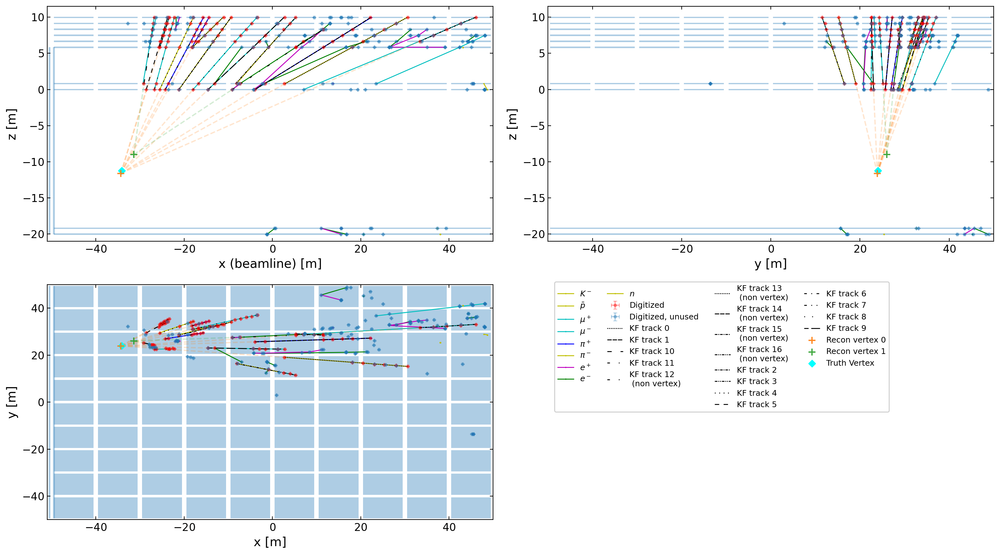

Geant4 index of particles in vertex
 [array([     3,     13,     22,     26,     31,     33,  13766, 189827,
       257536, 270575]), array([ 98997, 106918])]
Geant4 index of particles in each track
 [list([98997, 98997, 98997, 98997, 98997]) list([3, 3, 3, 3, 3, 3])
 list([301243, 301243, 301243, 301243, 301243, 301243, 301243, 301243])
 list([292411, 292410, 292410, 292410, 292410, 292410])
 list([22, 22, 22, 22, 22, 22, 22]) list([31, 31, 31, 31, 31, 31, 31])
 list([257536, 257536, 257536, 257536, 257536, 257536, 257536])
 list([106918, 106918, 106918, 144084])
 list([26, 89827, 89827, 89827, 89827, 89827, 89827])
 list([28, 28, 28, 28, 28]) list([13, 13, 13, 13])
 list([270575, 270575, 270575, 270575, 270575])
 list([106918, 106919, 106918, 106918]) list([33, 33, 33, 33, 33, 33, 33])
 list([13766, 13766, 13766, 13766, 13766, 13766, 13766])
 list([9, 9, 244380, 244380, 244380])
 list([189827, 189827, 189827, 189827, 189827, 189827])]
===========================Event 11==============

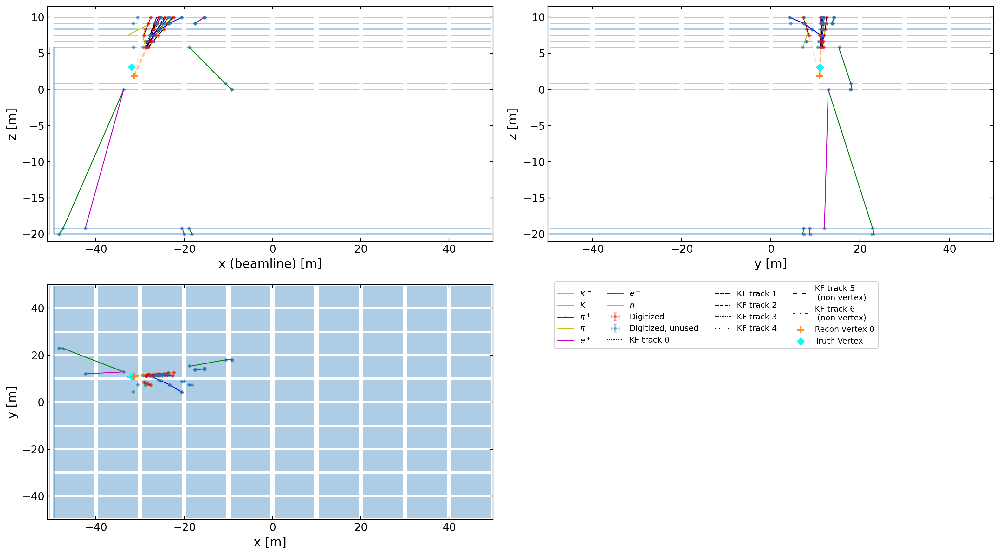

Geant4 index of particles in vertex
 [array([ 3,  5,  5,  9, 10])]
Geant4 index of particles in each track
 [list([5, 12, 38217, 38217, 38221]) list([11, 5, 5, 5])
 list([10, 11, 38217, 150393]) list([10, 10, 10, 10, 10, 10])
 list([3, 38219, 38219, 38219]) list([9, 9, 9, 9])
 list([3, 11, 318325, 318325])]
===========================Event 12==============================
[[0.0, 1.0, 8.0], [14.0, 17.0, 13.0, 10.0, 12.0, 6.0, 4.0, 15.0, 3.0, 7.0, 16.0, 18.0, 5.0], [2.0, 11.0, 9.0]]


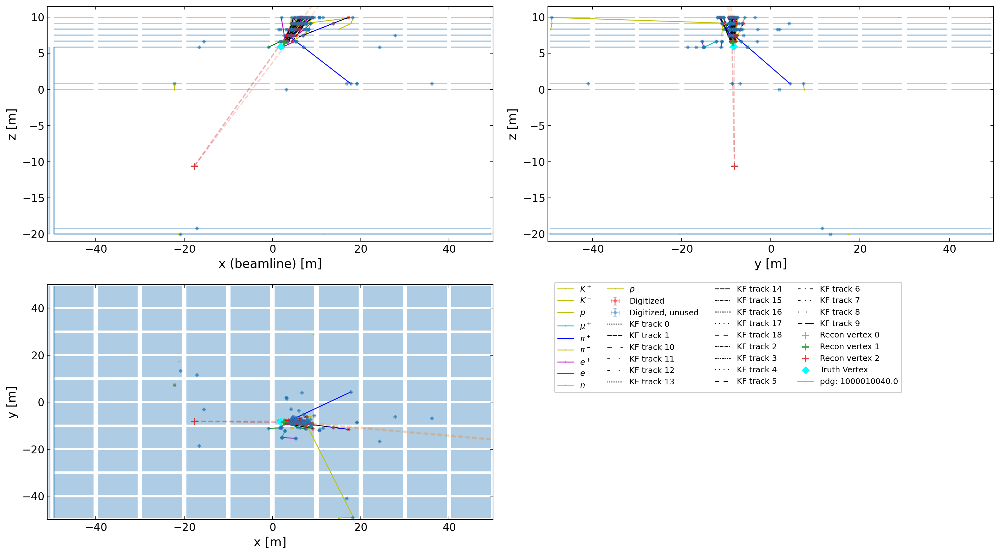

Geant4 index of particles in vertex
 [array([ 4, 18, 26]), array([ 1,  1,  3,  4,  5,  5,  8,  8,  9,  9, 18, 18, 27]), array([ 5,  5, 13])]
Geant4 index of particles in each track
 [list([26, 471938, 338966, 912594, 356444])
 list([4, 981065, 471938, 912593, 356543])
 list([537643, 13, 20, 20, 778908]) list([40, 34, 39, 356443, 27])
 list([12, 1044246, 5, 339681]) list([530495, 8, 18, 721963])
 list([5, 24, 26, 26]) list([25, 1, 1, 1053570])
 list([21, 1004058, 18, 721963]) list([27, 5, 356443, 471939])
 list([18, 21, 732943, 732943]) list([1044246, 5, 27, 27])
 list([20, 4, 4, 4]) list([23, 18, 778908, 778908])
 list([9, 20, 912594, 471938, 941008]) list([1, 997127, 1, 1])
 list([25, 3, 3, 3, 3]) list([8, 8, 8, 8]) list([12, 9, 23, 23])]
===========================Event 13==============================
[[0.0, 2.0, 4.0, 3.0, 1.0]]


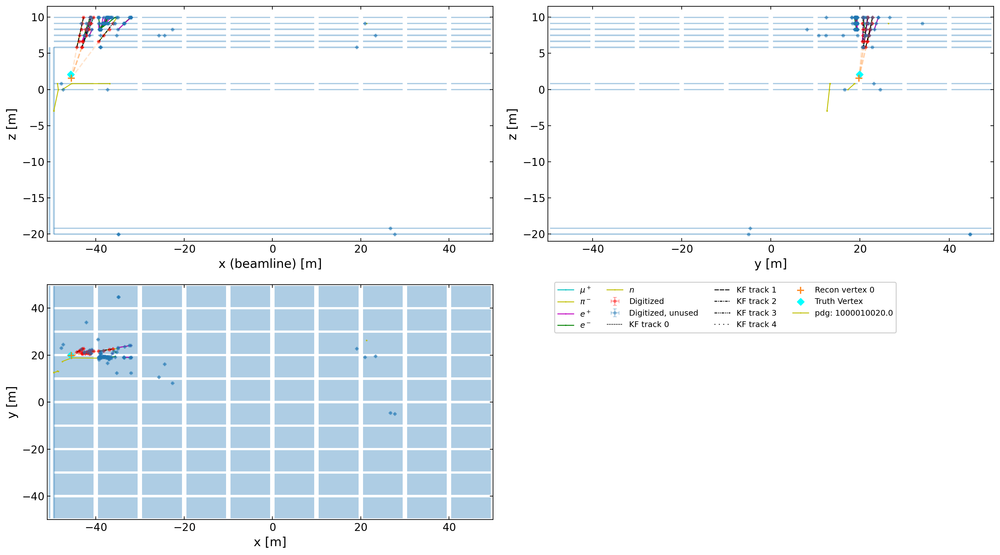

Geant4 index of particles in vertex
 [array([   10,    12,    12,    16, 38510])]
Geant4 index of particles in each track
 [list([38510, 38510, 38510, 38510, 38510, 38510])
 list([12, 12, 531253, 531243, 531244]) list([16, 16, 16, 16, 16, 16])
 list([38510, 12, 12, 531253]) list([10, 10, 10, 270855])]
===========================Event 14==============================
[[2.0, 4.0, 1.0, 0.0, 5.0, 3.0]]


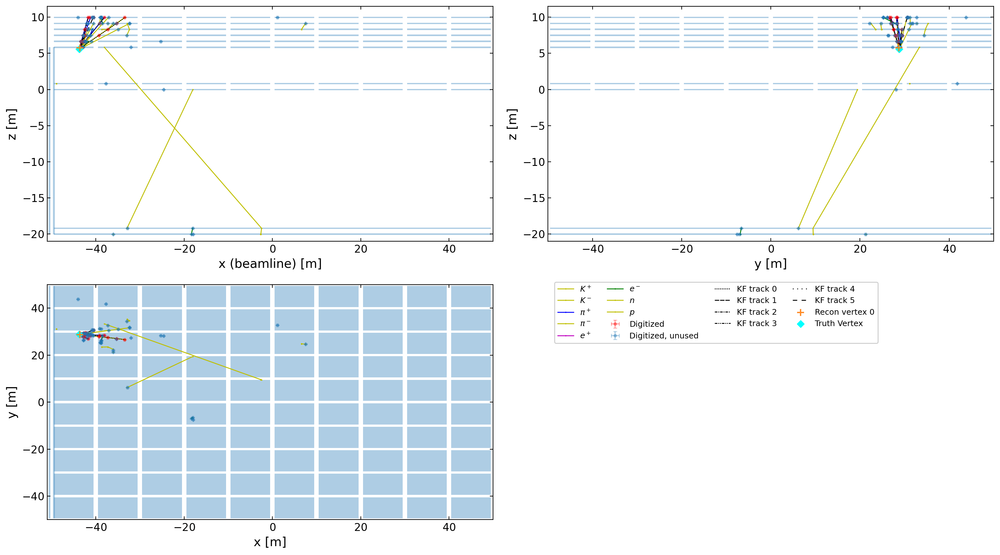

Geant4 index of particles in vertex
 [array([2, 2, 2, 6, 7, 8])]
Geant4 index of particles in each track
 [list([2, 8, 8, 8]) list([6, 6, 6, 6]) list([7, 9, 9, 9, 9])
 list([27, 2, 16, 30275]) list([16, 26, 2, 2]) list([8, 27, 10, 10])]
===========================Event 15==============================
[[0.0, 3.0], [1.0, 2.0]]


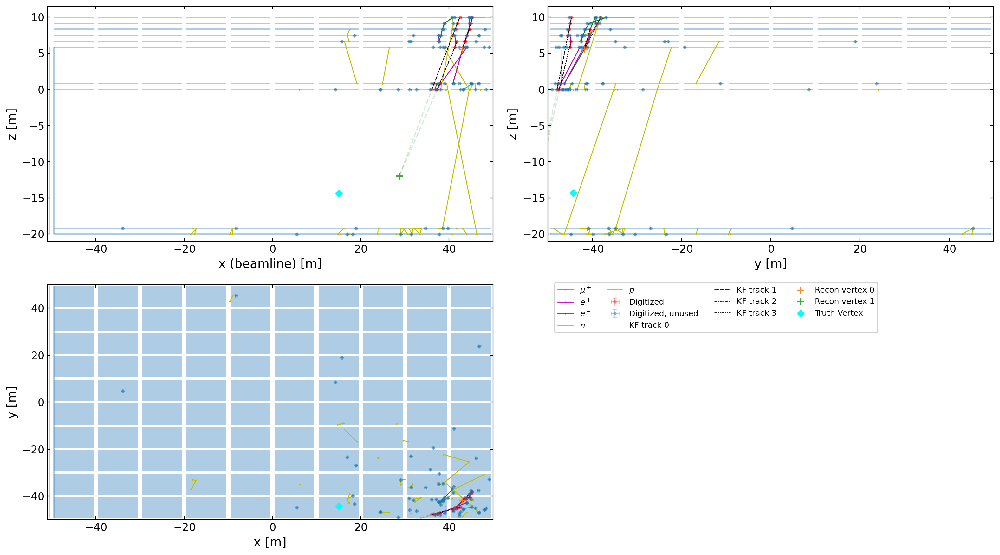

Geant4 index of particles in vertex
 [array([43698, 43698]), array([71363, 96651])]
Geant4 index of particles in each track
 [list([43698, 43698, 43699, 43699])
 list([71363, 71363, 86501, 86501, 86501, 86501])
 list([96651, 96651, 99134, 99134]) list([43699, 43699, 43698, 43698])]
===========================Event 16==============================
[]


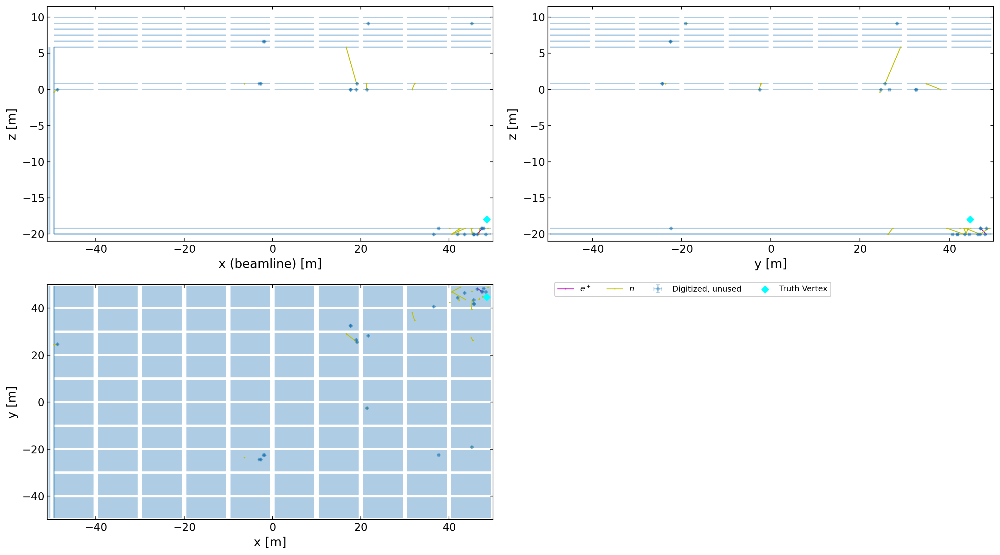

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 17==============================
[[1.0, 17.0, 10.0, 11.0, 14.0, 8.0, 15.0, 12.0, 19.0, 3.0, 13.0, 18.0], [7.0, 20.0, 0.0], [5.0, 21.0], [22.0, 23.0], [4.0, 16.0]]


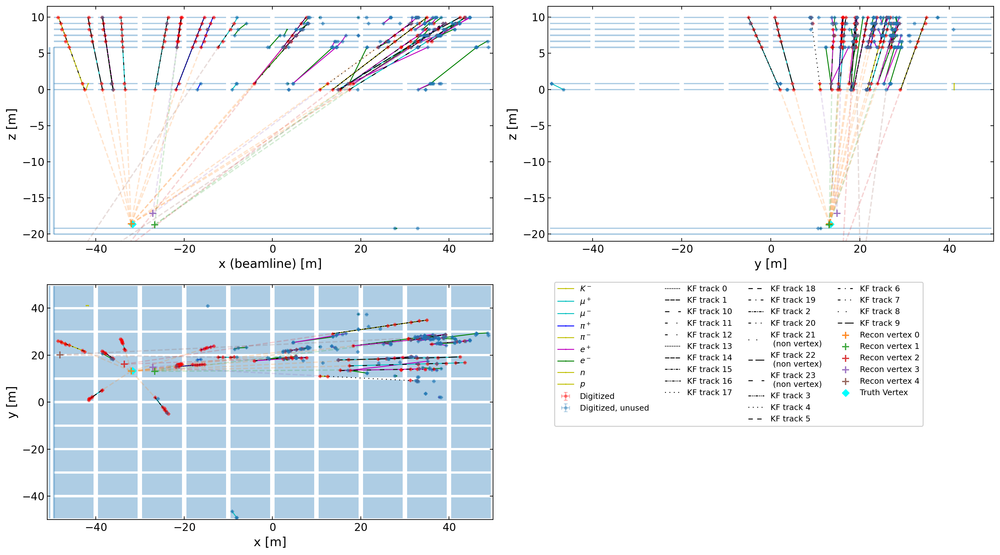

Geant4 index of particles in vertex
 [array([    13,     23, 117828, 201337, 244206, 281037, 339218, 369654,
       456597, 467468, 495253, 553909]), array([103060, 244207, 475363]), array([201338, 350715]), array([    24, 475363]), array([244206, 395867])]
Geant4 index of particles in each track
 [list([244207, 248733, 249787, 249788])
 list([467468, 467468, 467468, 467468, 467468, 467468, 467468, 467468])
 list([35, 36, 35, 34228])
 list([456597, 456597, 456597, 456597, 456597, 456597, 456597])
 list([395867, 395867, 395867, 395867])
 list([350715, 350715, 350715, 350715, 350715, 350715])
 list([325694, 325694, 325694, 325694, 325694, 325694])
 list([103060, 114273, 103060, 104651])
 list([117828, 117829, 117829, 117829, 140551])
 list([103059, 103059, 103060, 103060, 103060])
 list([281037, 281037, 281037, 281037, 289985])
 list([495253, 495253, 495253, 495253, 495253, 495253, 495253])
 list([13, 13, 13, 13, 13, 13, 13, 13])
 list([339218, 339218, 339218, 339218, 339218, 339218, 339

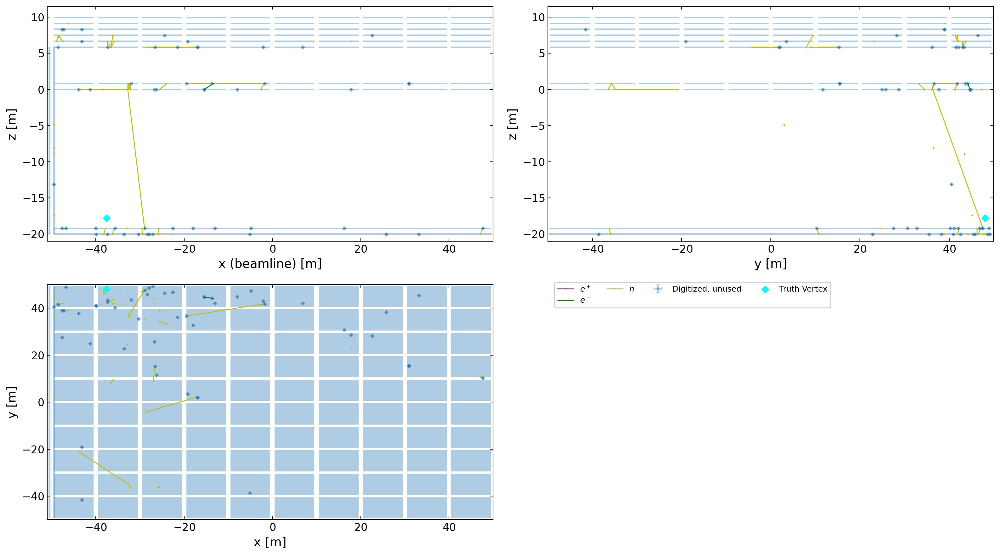

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 19==============================
[[1.0, 2.0, 5.0, 3.0, 0.0]]


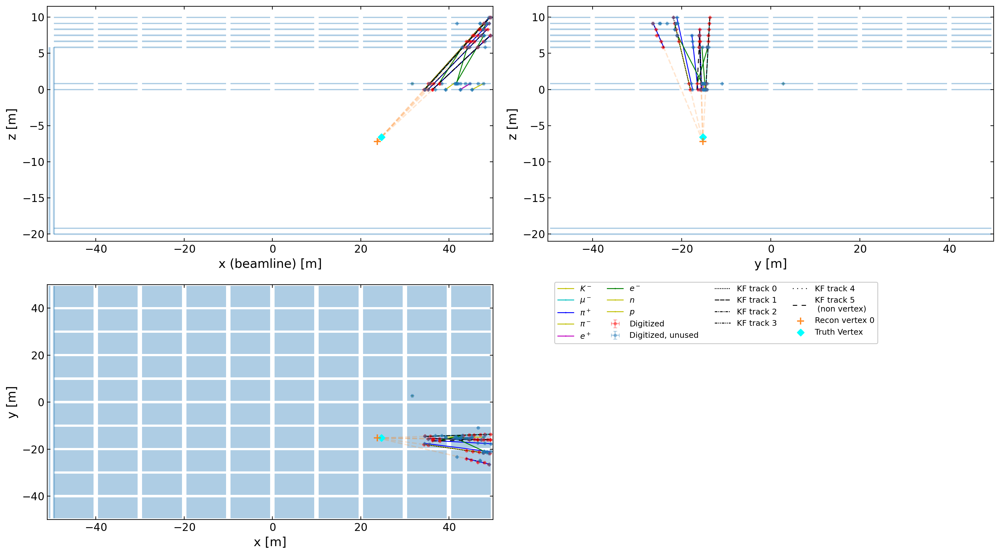

Geant4 index of particles in vertex
 [array([ 1,  4,  7, 13, 21])]
Geant4 index of particles in each track
 [list([13, 13, 13, 13, 13]) list([21, 21, 21, 21, 21, 21, 194307])
 list([7, 7, 7, 7, 7, 7, 7, 7]) list([1, 1, 1, 1, 1, 1])
 list([10, 10, 4, 4, 4]) list([4, 4, 4, 4])]
===========================Event 20==============================
[[2.0, 3.0, 4.0, 7.0, 1.0, 5.0], [6.0, 8.0]]


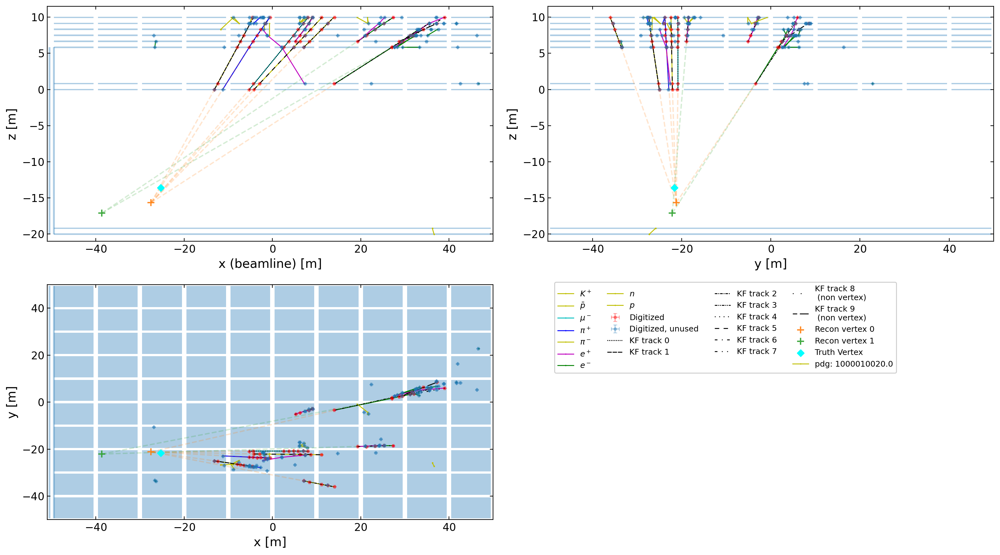

Geant4 index of particles in vertex
 [array([     6,      7,      8,     10,     96, 710736]), array([682593, 710736])]
Geant4 index of particles in each track
 [list([700882, 700882, 700883, 704731]) list([7, 7, 7, 7, 7, 7])
 list([96, 96, 96, 96, 96, 96, 96, 96]) list([6, 6, 6, 6, 6, 603768])
 list([10, 10, 10, 10, 10]) list([8, 8, 8, 8, 8, 8, 8])
 list([682593, 682593, 682593, 682593, 682593])
 list([710736, 710736, 710736, 718937])
 list([710736, 710736, 718688, 718937])
 list([723704, 718937, 716693, 719078])]
===========================Event 21==============================
[]


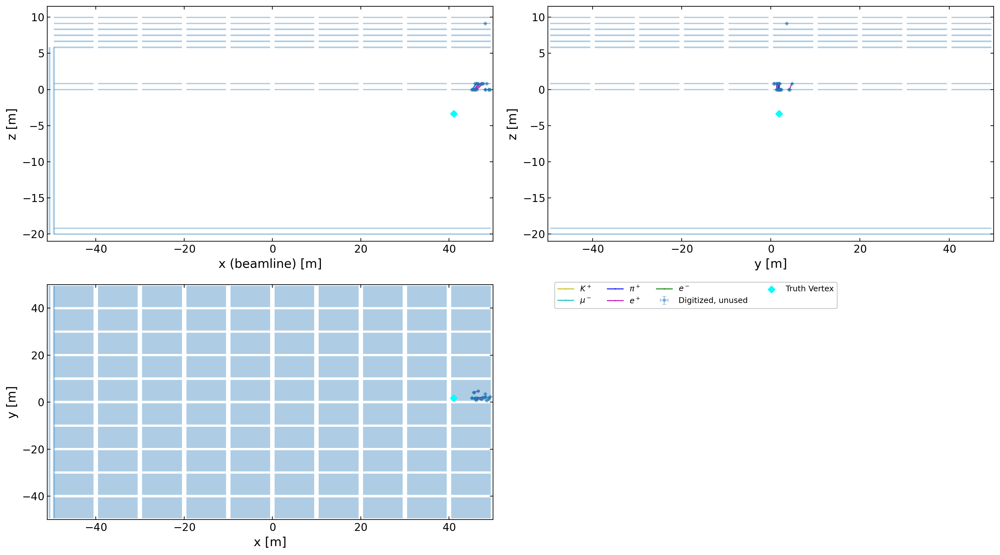

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 22==============================
[[0.0, 3.0, 20.0, 14.0], [16.0, 6.0, 7.0, 1.0, 21.0, 27.0, 24.0, 13.0, 8.0, 17.0, 28.0], [4.0, 22.0, 26.0], [18.0, 25.0], [15.0, 29.0], [2.0, 12.0]]


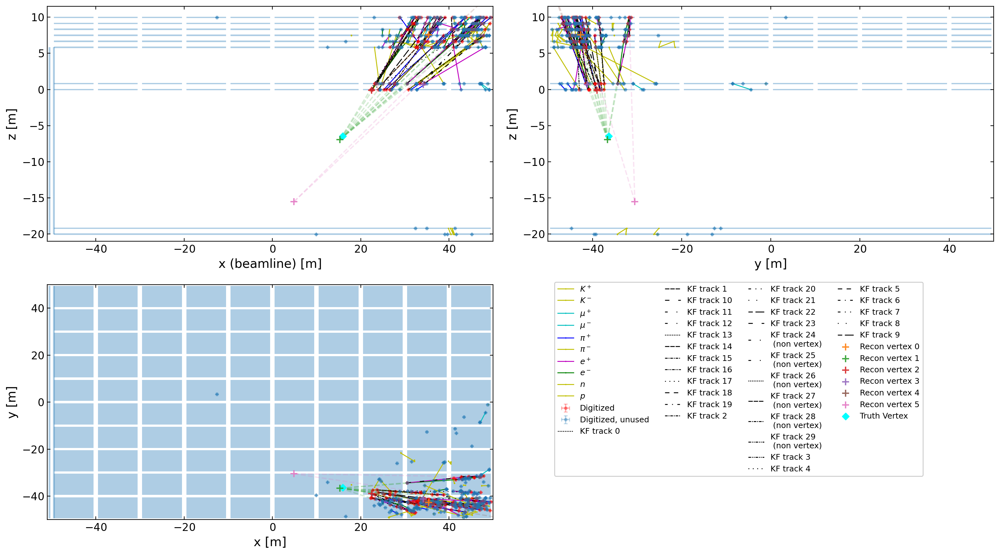

Geant4 index of particles in vertex
 [array([    16, 425530, 480231, 707825]), array([     2,      5,     16,     28,     29,  16947,  61141, 635238,
       635239, 698554, 698554]), array([ 2, 10, 10]), array([   27, 61142]), array([     9, 596258]), array([    21, 698554])]
Geant4 index of particles in each track
 [list([425530, 425531, 425531, 425531, 425531, 425531])
 list([61141, 61141, 61141, 61141, 61141])
 list([698555, 698555, 698554, 698554])
 list([16, 707825, 480231, 425532, 425532, 425532])
 list([10, 249, 16947, 16947]) list([28, 467079, 467079, 467079, 467079])
 list([29, 29, 29, 29, 29, 29]) list([635239, 655950, 655950, 655950])
 list([698554, 698554, 698554, 698554])
 list([557683, 557683, 557683, 557683]) list([32129, 16661, 16947, 26895])
 list([225988, 291173, 291173, 291173]) list([21, 169061, 169061, 169139])
 list([635239, 635238, 635238, 635238, 635238])
 list([707825, 707826, 707825, 707825, 707825])
 list([9, 776540, 776540, 776540, 776540, 776540, 776540, 77

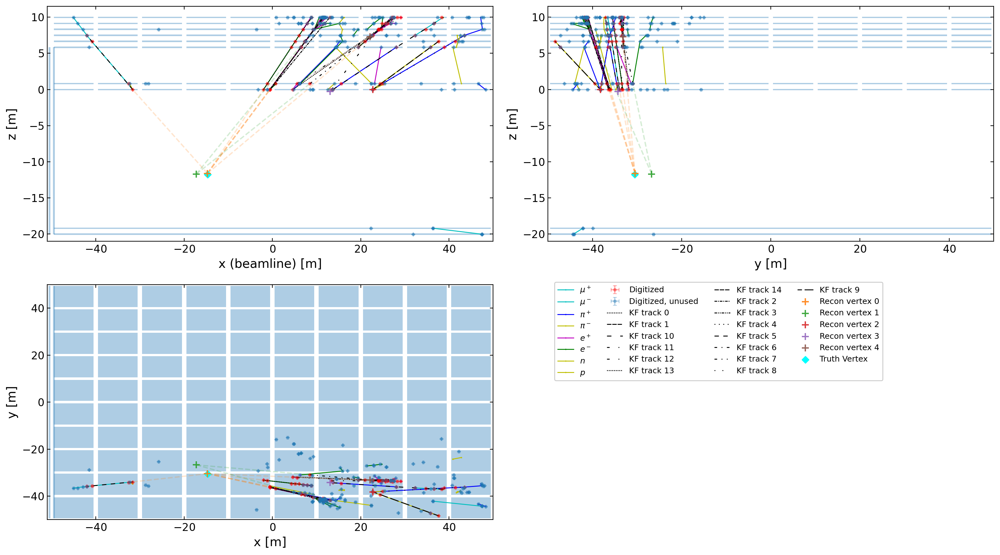

Geant4 index of particles in vertex
 [array([     7,      9,     21,  73823,  73868, 169585]), array([ 59665, 169586]), array([    13, 575680]), array([   11, 57820]), array([55295, 55295, 73868])]
Geant4 index of particles in each track
 [list([21, 169585, 260078, 171776])
 list([73868, 73868, 113445, 74964, 74138])
 list([73868, 73868, 98410, 78360]) list([59665, 113333, 73868, 75023])
 list([7, 7, 7, 7, 7, 7, 770107, 771955]) list([9, 9, 9, 9])
 list([169585, 370839, 546392, 546393])
 list([13, 575679, 575679, 575679, 589790])
 list([575709, 575680, 575680, 575680])
 list([11, 11, 11, 616355, 616355, 616355, 616355])
 list([55295, 73869, 75314, 75647]) list([169585, 73823, 273719, 171775])
 list([55295, 113446, 73869, 83480])
 list([370840, 169586, 264526, 264526])
 list([57820, 73869, 102454, 74051])]
===========================Event 24==============================
[[1.0, 4.0, 14.0, 17.0, 9.0, 0.0, 5.0, 19.0, 7.0], [2.0, 8.0, 6.0, 18.0, 11.0], [3.0, 12.0], [13.0, 15.0], [10.0, 16.

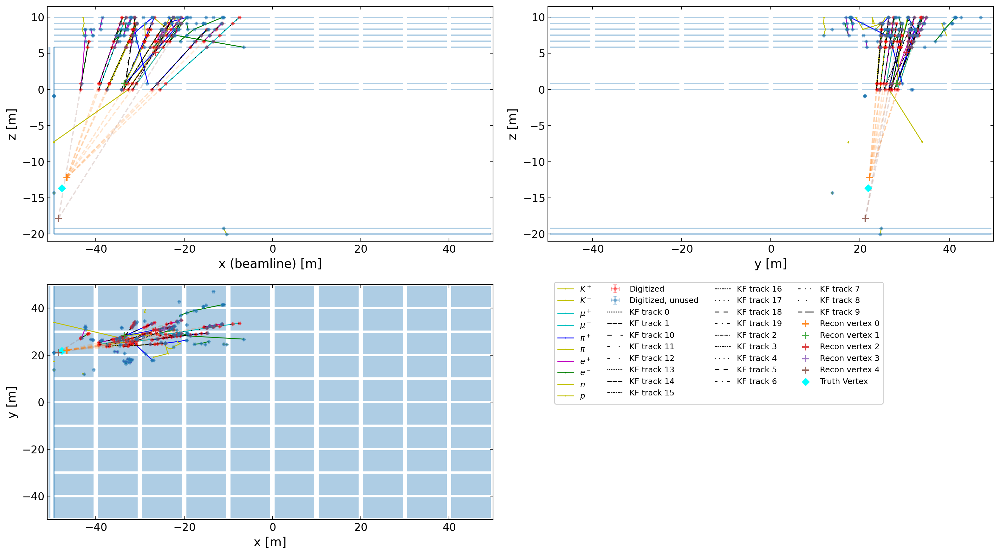

Geant4 index of particles in vertex
 [array([     4,     17,     18,     19,     21,     22,     31, 693383,
       756211]), array([    16, 433090, 447982, 524620, 562807]), array([     2, 498199]), array([     2, 498199]), array([ 64358, 130095])]
Geant4 index of particles in each track
 [list([693383, 693383, 693383, 693384, 693384, 693384, 693384])
 list([18, 18, 18, 18, 18, 18, 18])
 list([562807, 597829, 597828, 597828, 602968])
 list([498199, 518324, 498200, 498200])
 list([22, 22, 22, 22, 22, 22, 177170]) list([4, 4, 4, 4, 4, 4, 4])
 list([433090, 597828, 597828, 597828])
 list([756211, 756211, 756211, 756440, 756211, 756211, 756211])
 list([16, 524619, 524619, 524619, 524619, 524619])
 list([17, 17, 17, 17, 321898, 271706])
 list([130095, 130096, 130095, 130095])
 list([524620, 524620, 524620, 524620]) list([2, 2, 433090, 433090])
 list([19, 19, 2, 498200]) list([21, 21, 21, 21, 21, 232072])
 list([498199, 498200, 498199, 745674]) list([64358, 64359, 67120, 70372])
 list([19, 

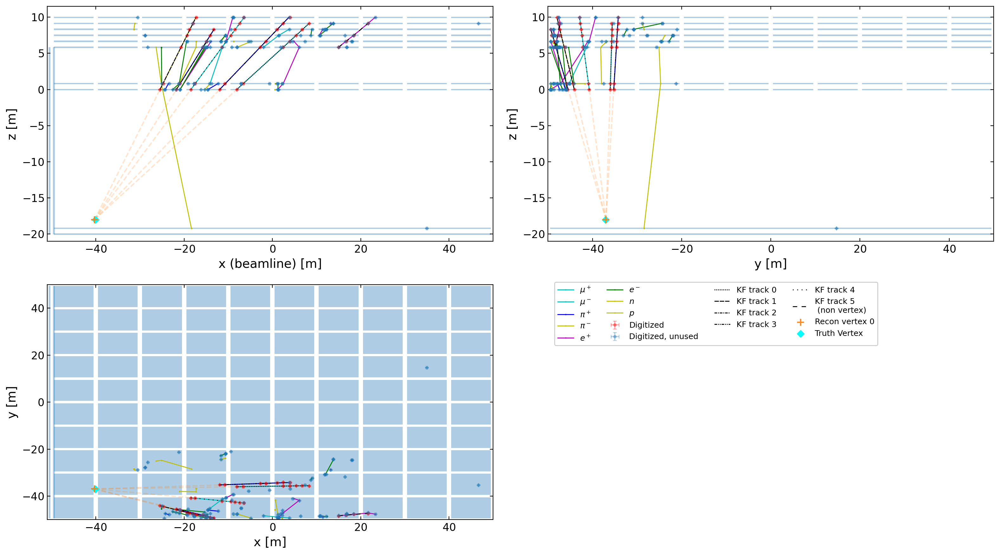

Geant4 index of particles in vertex
 [array([     1,      6,     16, 202996, 319233])]
Geant4 index of particles in each track
 [list([202996, 202996, 202996, 202996, 202996, 202996, 202996])
 list([16, 16, 16, 16, 16, 16, 214441]) list([1, 1, 1, 1, 1, 1])
 list([11022, 11023, 11023, 11023])
 list([319233, 319233, 319233, 319233, 319233, 319233, 319233])
 list([6, 6, 6, 6, 6, 6, 6])]
===========================Event 26==============================
[[5.0, 10.0, 12.0, 6.0, 14.0, 16.0, 13.0, 4.0, 3.0, 18.0, 11.0], [0.0, 9.0, 17.0]]


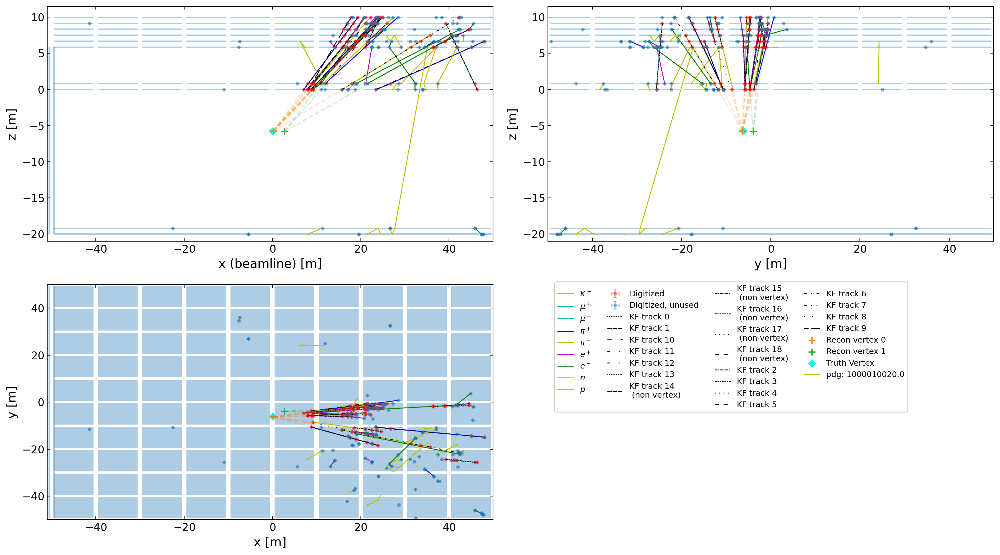

Geant4 index of particles in vertex
 [array([     4,      4,      5,      6,     13,     14,     19,  75478,
        75479, 358284, 358284]), array([    12,     15, 686890])]
Geant4 index of particles in each track
 [list([15, 358285, 395202, 394983]) list([15, 13, 411501, 394983])
 list([12, 12, 75479, 75479, 75479]) list([4, 695536, 695537, 695536])
 list([358284, 358284, 358284, 358284, 358284])
 list([5, 5, 5, 5, 5, 5, 5, 5]) list([4, 4, 4, 4, 4])
 list([24654, 36992, 37015, 36992, 36992, 36992])
 list([686890, 687699, 689583, 689584]) list([443894, 443894, 12, 12])
 list([19, 19, 19, 19, 19, 19])
 list([75478, 75478, 75478, 75478, 75478, 75478])
 list([13, 13, 13, 129991]) list([6, 6, 6, 6, 6, 627315])
 list([358284, 358285, 403588, 358285, 411502, 358285])
 list([18, 18, 18, 18]) list([14, 14, 14, 14])
 list([686890, 686890, 689584, 692930])
 list([75479, 262071, 262071, 262071])]
===========================Event 27==============================
[[1.0, 2.0, 3.0]]


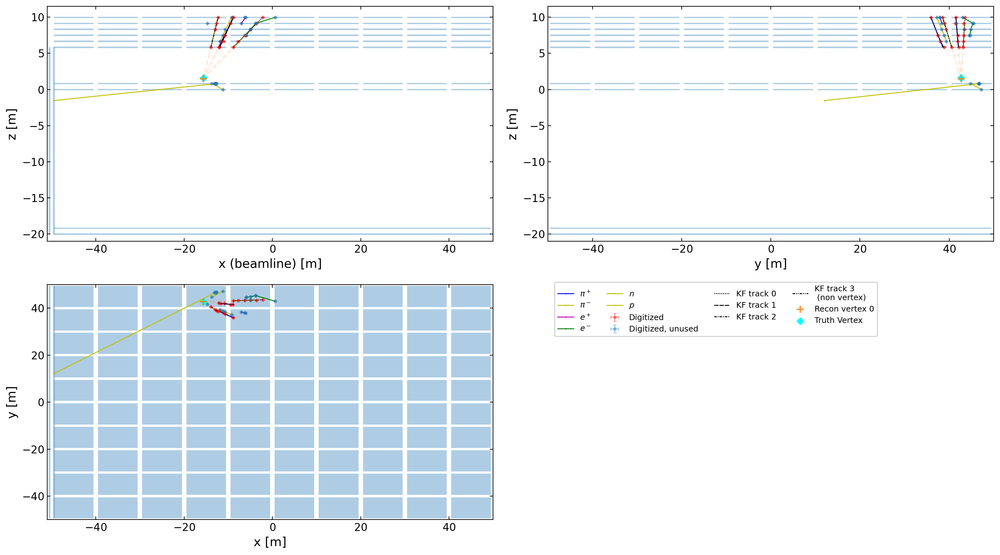

Geant4 index of particles in vertex
 [array([1, 2, 3])]
Geant4 index of particles in each track
 [list([8, 8, 8, 8]) list([2, 2, 2, 2, 2, 187753]) list([3, 3, 3, 3, 3])
 list([1, 1, 1, 1])]
===========================Event 28==============================
[[4.0, 6.0, 12.0, 1.0, 10.0, 13.0, 15.0, 7.0, 2.0, 8.0, 9.0, 0.0, 3.0]]


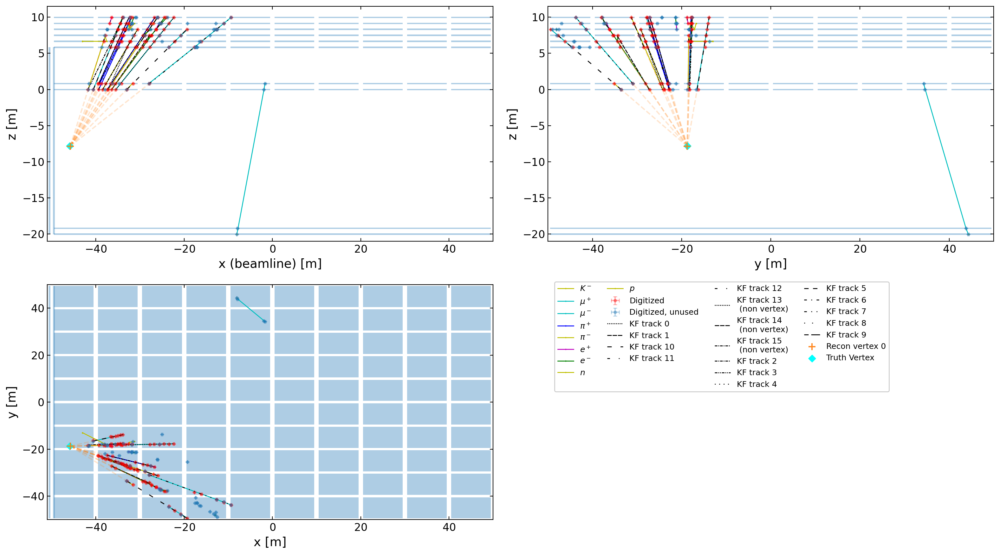

Geant4 index of particles in vertex
 [array([    1,     7,     8,     9,    10,    11,    12,    13,    15,
          18,    18,    25, 16378])]
Geant4 index of particles in each track
 [list([8, 8, 8, 8, 8, 295041, 295041, 295041])
 list([11, 11, 11, 11, 11, 11, 11]) list([18, 18, 119536, 18])
 list([15, 15, 149155, 149156]) list([7, 7, 7, 7, 7, 7, 7, 7])
 list([12, 12, 10, 10]) list([9, 9, 9, 9, 9, 9, 9])
 list([16378, 16378, 16378, 16378, 16378, 16378]) list([12, 12, 12, 12])
 list([25, 25, 303, 303, 445, 303]) list([1, 1, 1, 1, 1, 1, 343676])
 list([18, 18, 52874, 119388]) list([10, 10, 10, 10, 10])
 list([176245, 13, 13, 13, 13, 13, 13])
 list([15, 120152, 120152, 120152, 128292]) list([18, 18, 18, 18, 18])]
===========================Event 29==============================
[]


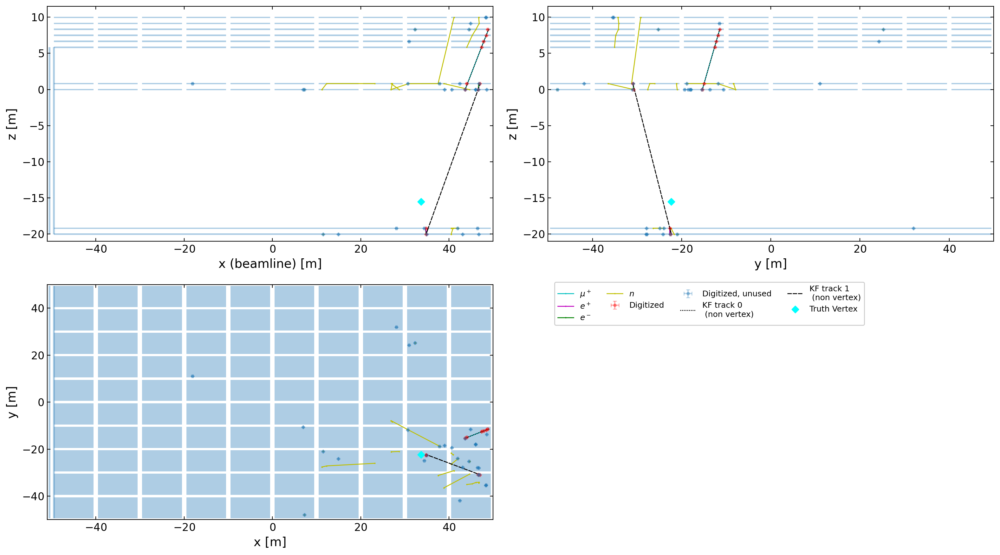

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 [list([122426, 122426, 122426, 122426, 122426, 122426])
 list([115717, 115717, 70043, 70043])]
===========================Event 30==============================
[[0.0, 4.0, 11.0, 8.0, 12.0, 17.0, 15.0, 13.0, 9.0, 6.0, 3.0, 2.0, 16.0], [1.0, 14.0, 5.0, 18.0]]


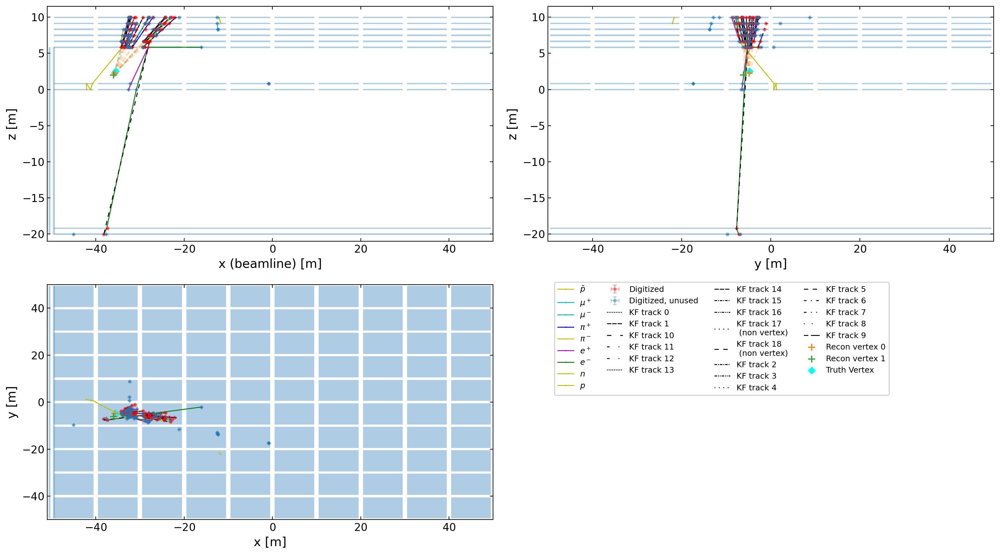

Geant4 index of particles in vertex
 [array([     1,      2,      4,      5,      7,     12,     14,     14,
           16,     20,     20, 116226, 311026]), array([     9,     14,     15, 103831])]
Geant4 index of particles in each track
 [list([5, 5, 5, 5, 5, 5]) list([15, 15, 15, 103832])
 list([329250, 329250, 329250, 329251, 116226])
 list([298263, 298263, 20, 298263]) list([7, 7, 7, 7, 7])
 list([9, 321162, 15, 15]) list([26, 26, 26, 14, 26])
 list([283453, 12, 117894, 2]) list([12, 12, 12, 12, 12])
 list([20, 20, 20, 20]) list([13, 273786, 273786, 273786])
 list([14, 14, 236313, 14]) list([16, 16, 16, 16, 16])
 list([4, 4, 4, 401103]) list([103831, 103831, 103831, 329251])
 list([1, 1, 428330, 428330]) list([311026, 311026, 311026, 311026])
 list([2, 2, 2, 2]) list([14, 27, 273657, 273657])]
===========================Event 31==============================
[[1.0, 2.0, 3.0], [4.0, 6.0]]


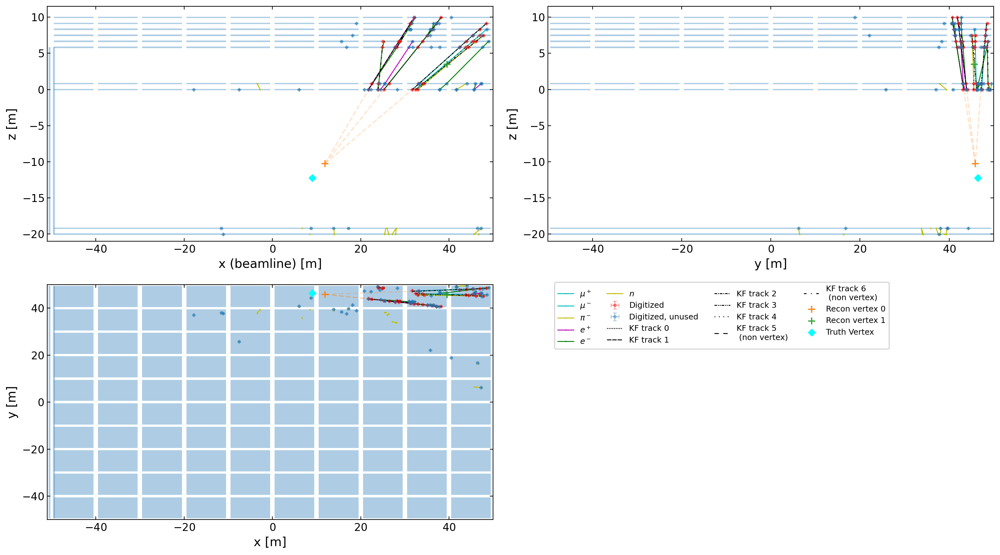

Geant4 index of particles in vertex
 [array([ 6910, 38440, 79071]), array([20, 20])]
Geant4 index of particles in each track
 [list([38440, 38440, 38441, 38441])
 list([6910, 6910, 6910, 6910, 6910, 33782, 34221, 6910])
 list([38441, 38440, 38441, 38441, 38441])
 list([79071, 79137, 79071, 79071, 79071, 79071, 79071])
 list([89774, 89774, 20, 20, 20]) list([127358, 127250, 127250, 127250])
 list([20, 20, 89774, 89774, 89774])]
===========================Event 32==============================
[]


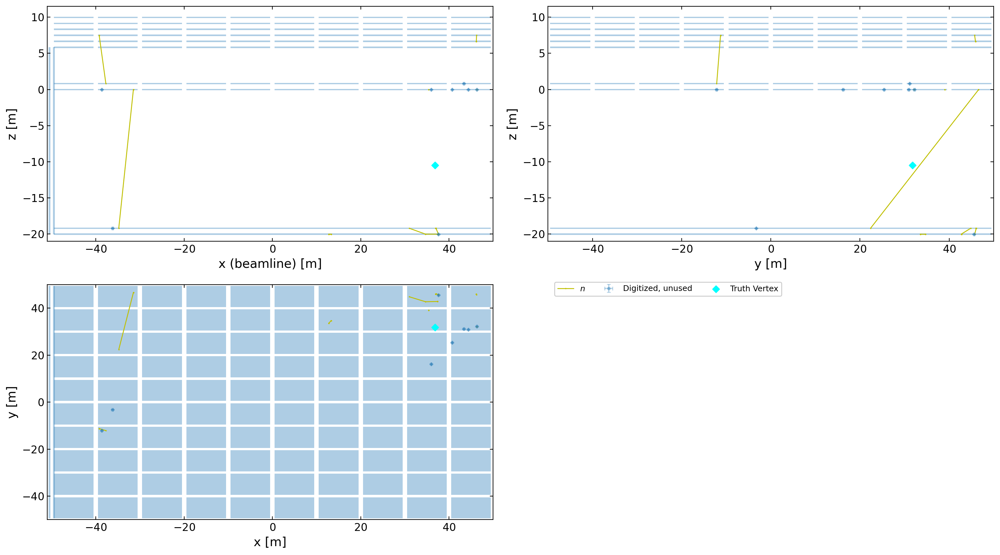

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 33==============================
[]


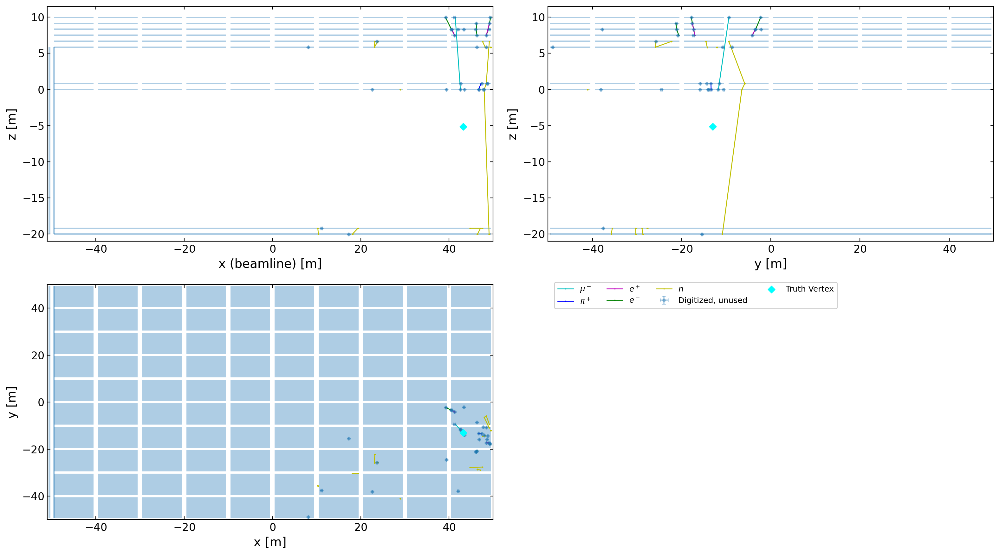

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 34==============================
[]


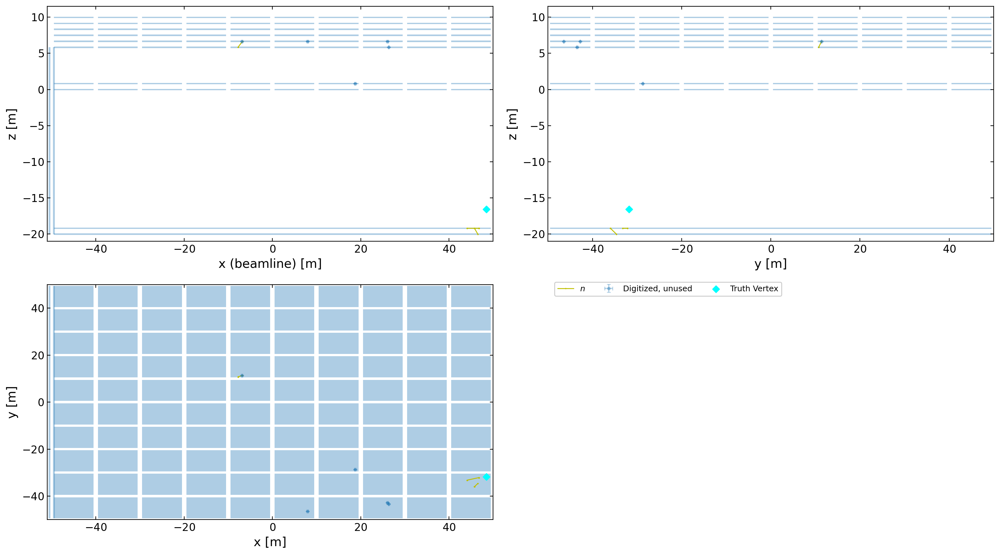

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 35==============================
[[0.0, 2.0, 10.0, 3.0, 6.0, 14.0, 8.0], [1.0, 18.0], [4.0, 7.0, 12.0, 9.0]]


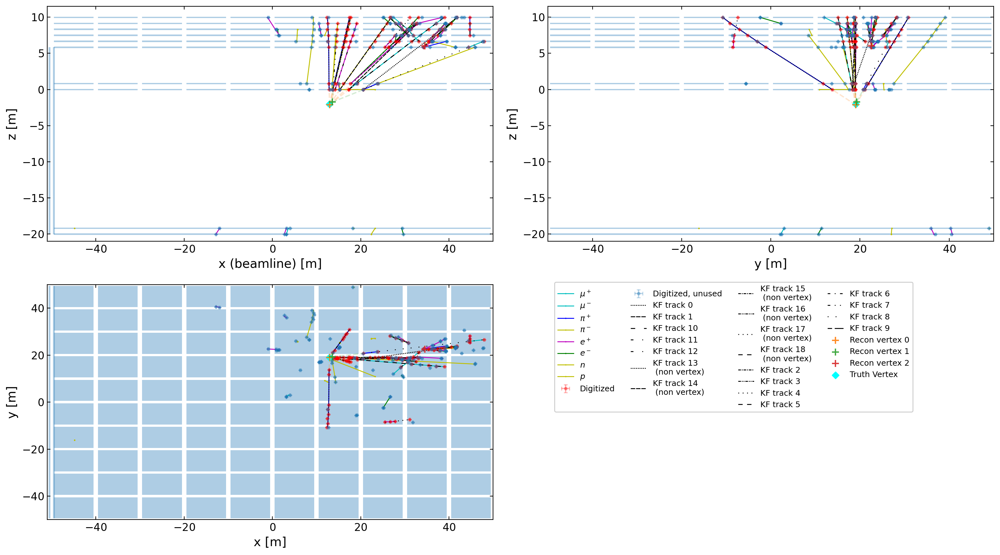

Geant4 index of particles in vertex
 [array([    1,    10,    14,    17, 43779, 63482, 69090]), array([ 1, 13]), array([142874, 142874, 228205, 269829])]
Geant4 index of particles in each track
 [list([10, 10, 10, 10, 10, 10, 10, 10])
 list([1, 69092, 69092, 69092, 69092, 69092])
 list([63482, 63482, 63482, 63482, 63482, 63482, 63482, 63482])
 list([1, 1, 1, 1, 1, 1, 1]) list([228202, 228202, 142874, 156230])
 list([11, 278557, 228202, 145152])
 list([43779, 43779, 43779, 43779, 43779, 43779, 43779])
 list([228205, 278557, 278557, 278557])
 list([69090, 69090, 69090, 69090, 69090, 69090])
 list([142875, 142874, 145152, 145152]) list([17, 17, 17, 17, 17, 17, 17])
 list([14, 43780, 44321, 43780]) list([269829, 269829, 269829, 269829])
 list([43779, 367042, 372964, 367042]) list([14, 14, 14, 14, 14, 14])
 list([244770, 244770, 244770, 244770]) list([68201, 68201, 68201, 68433])
 list([232668, 232668, 232668, 232668]) list([13, 13, 217250, 217250])]
===========================Event 36=====

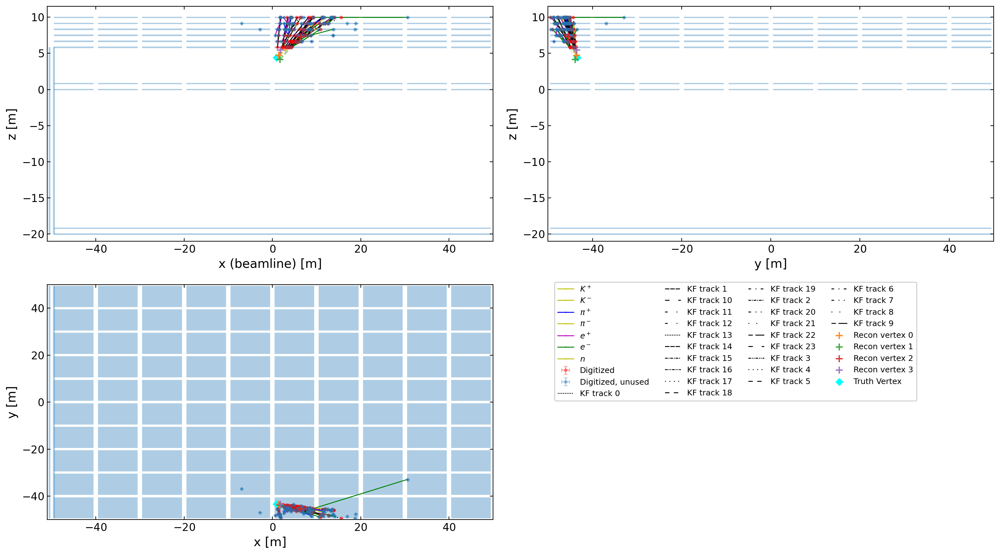

Geant4 index of particles in vertex
 [array([     2,      2,      3,      8,      9,      9,     10,     13,
           19,     20,     21,     22,     35,     36, 158912]), array([     3,      9,  18690, 189655]), array([3, 3, 3]), array([    19, 189656])]
Geant4 index of particles in each track
 [list([189655, 260596, 689028, 628492, 628492])
 list([14, 9, 14, 14, 14, 14]) list([19, 20, 35, 35, 35])
 list([3, 11, 688705, 189656, 189656]) list([9, 9, 9, 10, 21])
 list([22, 260597, 260597, 260597, 260597, 260597])
 list([21, 679550, 679551, 679551, 628493]) list([13, 13, 189656, 13, 13])
 list([3, 18597, 189655, 260596])
 list([20, 135288, 135288, 102872, 102872]) list([10, 10, 21, 21])
 list([3, 53801, 18547, 54289]) list([18546, 3, 189655, 222168])
 list([36, 36, 36, 36, 36, 36]) list([2, 18547, 18546, 18691])
 list([623939, 623939, 158912, 158912])
 list([623939, 624037, 18690, 18690]) list([35, 135289, 135288, 302851])
 list([8, 8, 8, 8, 8, 8]) list([19, 19, 19, 312072])
 list([2, 

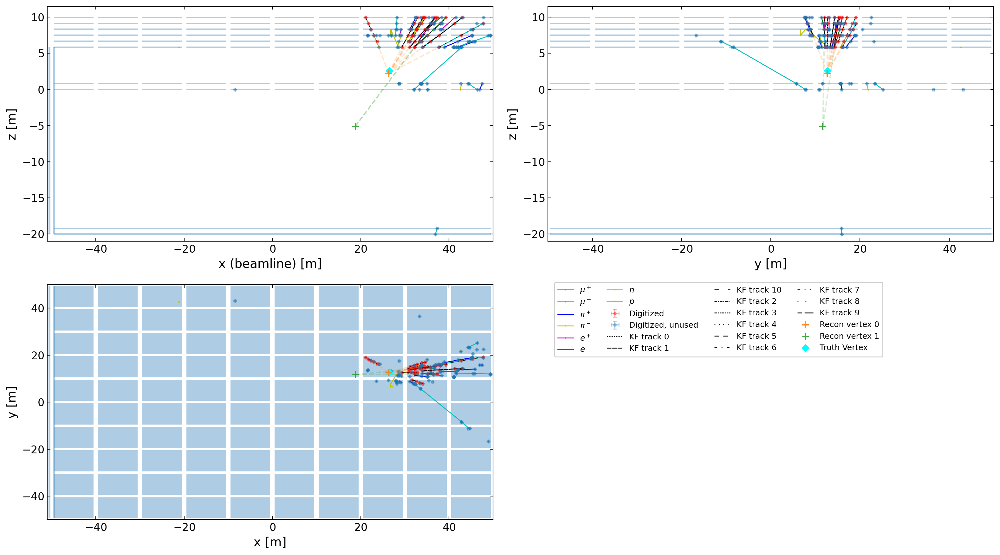

Geant4 index of particles in vertex
 [array([     1,      3,     30,     31,     34, 299417, 325053, 332227,
       344310]), array([ 1, 43])]
Geant4 index of particles in each track
 [list([344310, 344310, 344310, 344310, 344310])
 list([299417, 304328, 1, 1]) list([3, 3, 349953, 349953, 349953])
 list([299417, 299417, 314510, 299417]) list([34, 34, 34, 34, 34])
 list([43, 244563, 244563, 244563]) list([332227, 332227, 332227, 332227])
 list([325053, 325053, 325053, 325053, 325180]) list([31, 31, 31, 31])
 list([30, 30, 175655, 30, 30]) list([1, 1, 1, 1])]
===========================Event 38==============================
[[1.0, 2.0]]


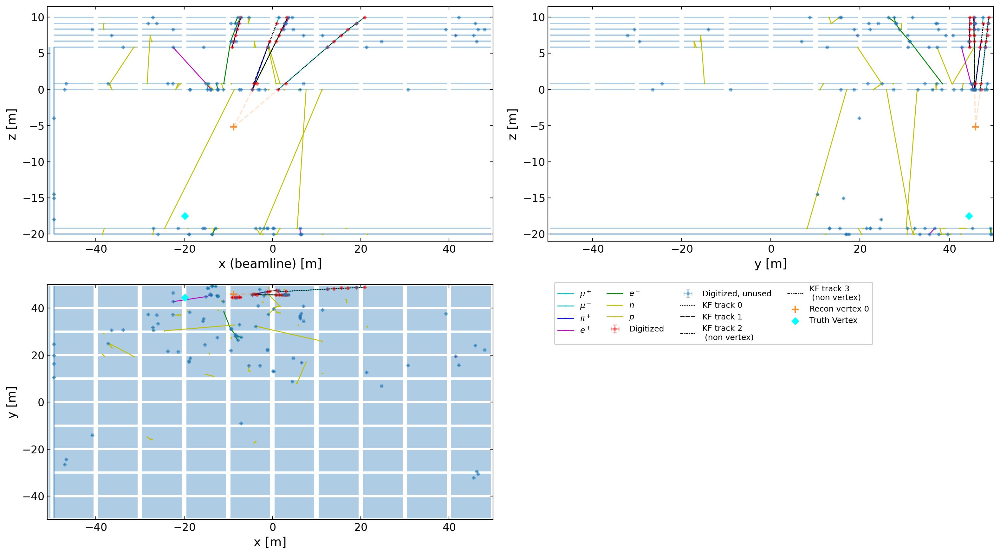

Geant4 index of particles in vertex
 [array([20994, 80465])]
Geant4 index of particles in each track
 [list([20996, 20996, 20996, 21079])
 list([80465, 80465, 80465, 80465, 80465, 80465, 80465, 80465])
 list([20994, 20994, 20994, 20994, 20994, 20994, 20994])
 list([138128, 138129, 138129, 138129, 138129, 138129])]
===========================Event 39==============================
[[8.0, 14.0, 3.0, 6.0, 10.0, 13.0, 12.0], [2.0, 4.0, 9.0, 5.0], [0.0, 7.0, 15.0]]


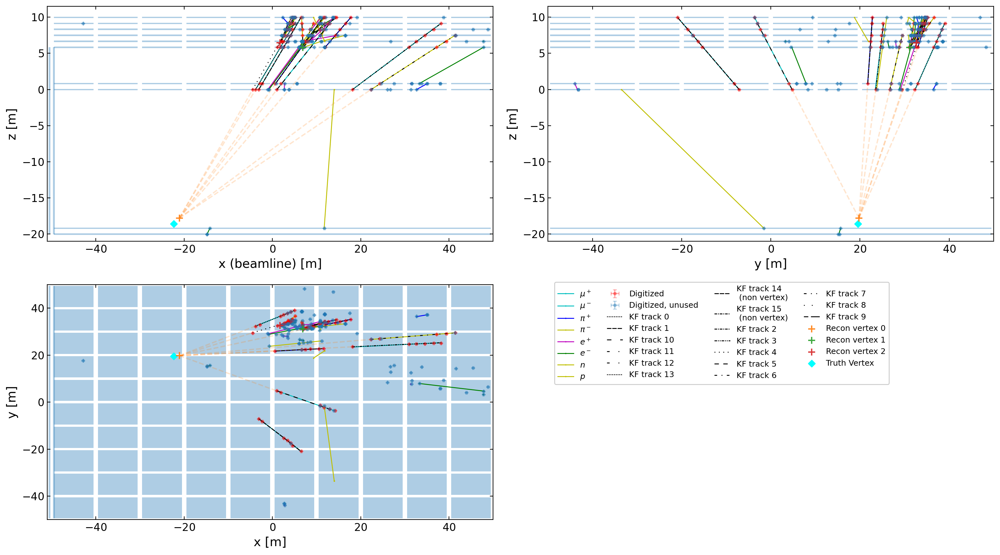

Geant4 index of particles in vertex
 [array([     6,      7,      8,     10,  96958, 182749, 374168]), array([   18,    21, 40198, 40202]), array([     8, 190706, 190707])]
Geant4 index of particles in each track
 [list([190707, 190709, 190709, 190709, 190709])
 list([118648, 118648, 118648, 118648, 118648, 118648, 118648])
 list([18, 21, 40201, 40201, 40201]) list([7, 7, 7, 7, 7])
 list([40198, 40207, 40207, 40207]) list([43184, 40202, 40202, 40202])
 list([6, 6, 6, 6, 6, 6]) list([190706, 190710, 240149, 240150])
 list([96958, 96958, 96958, 96958, 96958, 96958, 96958])
 list([40200, 8380, 21, 21]) list([8, 190707, 190707, 240150, 240150])
 list([21, 21, 54289, 21]) list([182749, 182749, 182749, 182749, 182749])
 list([374168, 374168, 374168, 374168, 374168, 374168])
 list([10, 10, 10, 10, 10, 10]) list([8, 240150, 190707, 240150])]
===========================Event 40==============================
[]


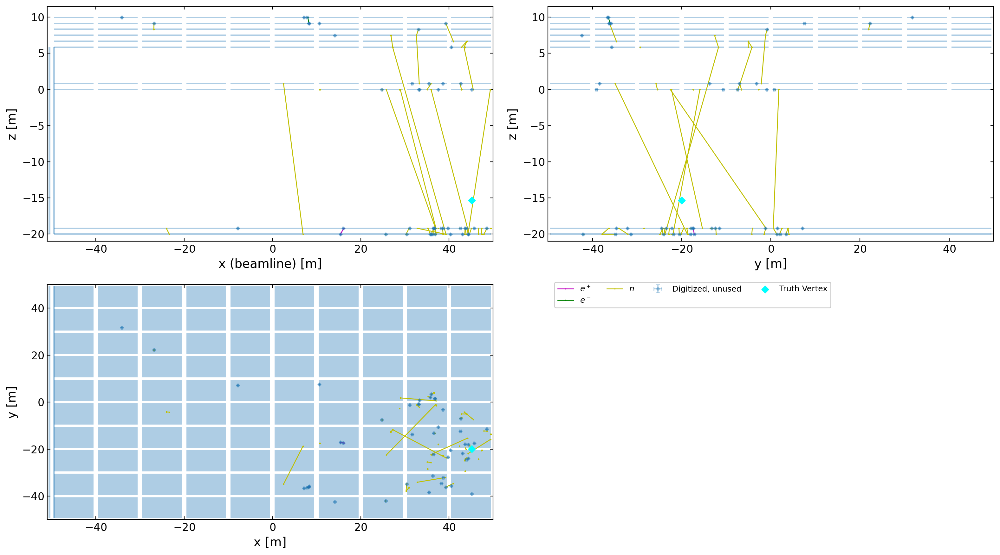

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 41==============================
[[6.0, 7.0, 9.0, 8.0], [2.0, 4.0, 11.0, 5.0, 10.0], [14.0, 15.0, 17.0, 0.0, 16.0, 1.0], [12.0, 13.0]]


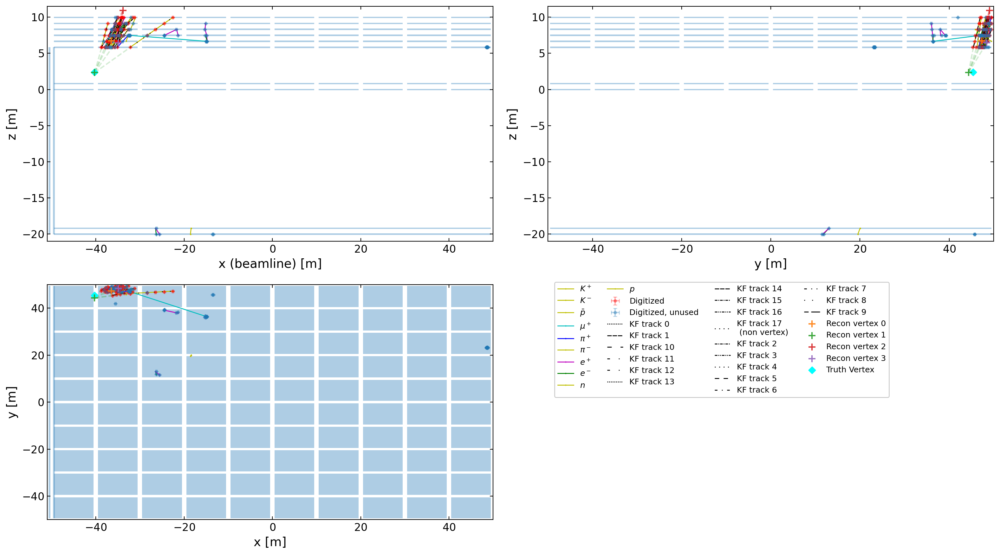

Geant4 index of particles in vertex
 [array([ 1,  1,  5, 17]), array([ 3,  5,  9, 11, 24]), array([ 1,  3,  3,  5,  9, 12]), array([6, 6])]
Geant4 index of particles in each track
 [list([28, 12, 17, 18]) list([21, 21, 17, 3]) list([3, 3, 3, 466030])
 list([10, 181985, 21, 21]) list([24, 24, 24, 24, 24, 24])
 list([437368, 9, 9, 9]) list([181985, 17, 462503, 22, 22])
 list([1, 17, 1, 466030, 1]) list([1, 3, 18, 18])
 list([5, 631203, 170481, 122412]) list([11, 11, 11, 11, 11])
 list([5, 5, 181985, 10]) list([6, 469423, 462502, 466029])
 list([6, 469423, 6, 6]) list([22, 192516, 466030, 3])
 list([49182, 181985, 10, 5]) list([9, 10, 10, 17])
 list([27, 22, 462503, 1])]
===========================Event 42==============================
[]


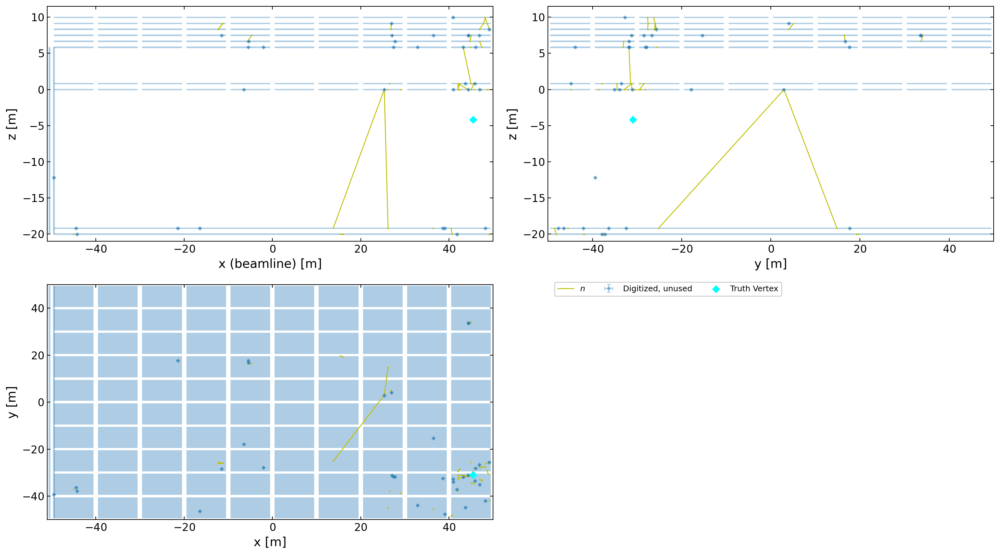

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 43==============================
[]


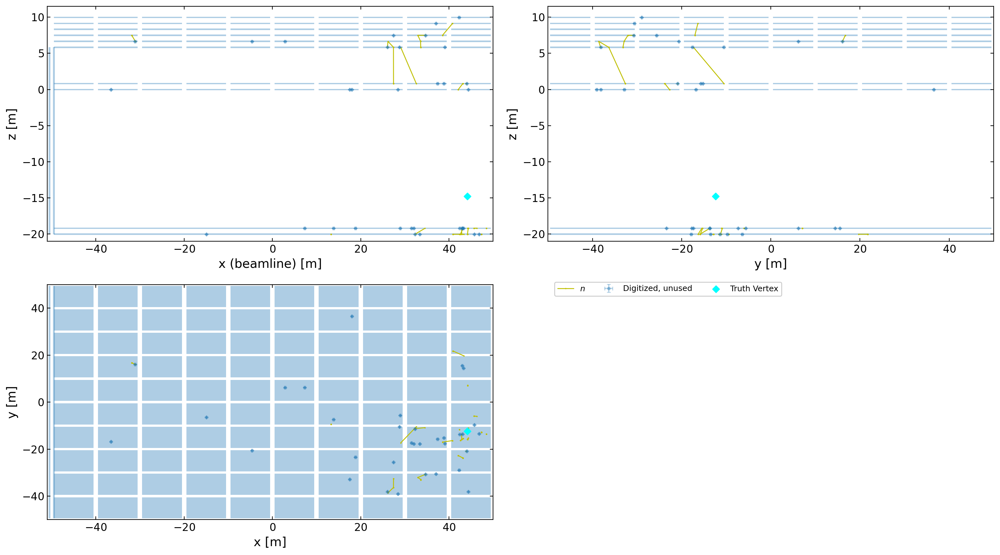

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 44==============================
[]


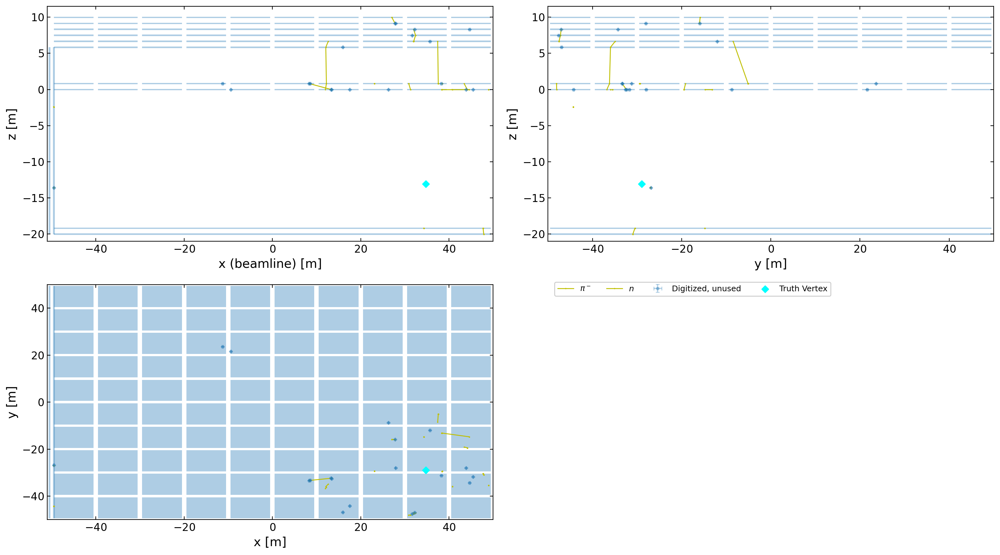

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 45==============================
[[1.0, 5.0, 3.0, 0.0, 6.0, 2.0]]


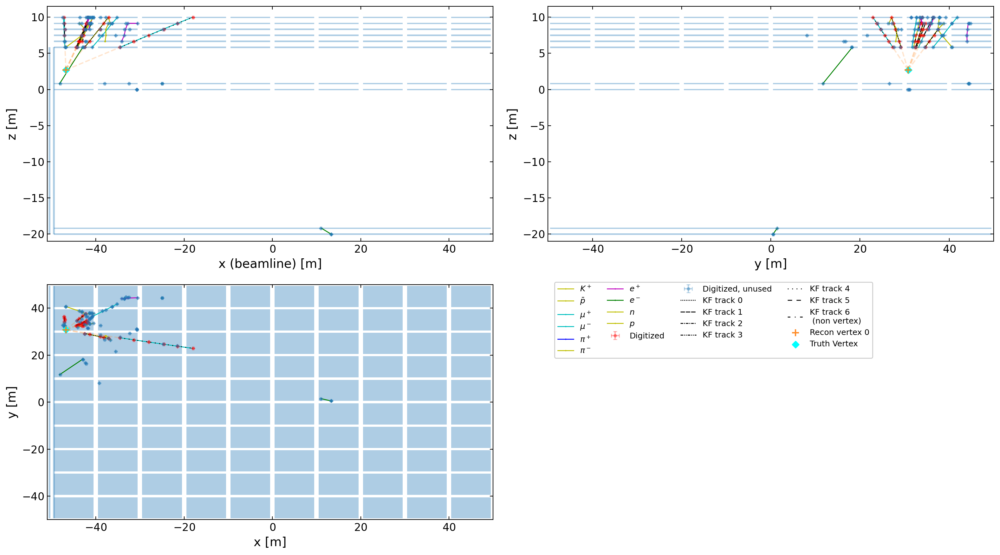

Geant4 index of particles in vertex
 [array([    1,     2,     5,     9,    12, 16359])]
Geant4 index of particles in each track
 [list([12, 12, 12, 12, 12]) list([1, 1, 1, 1, 1])
 list([16359, 16359, 16359, 16359]) list([215533, 5, 5, 215570])
 list([13, 13, 33184, 33185]) list([2, 2, 2, 2, 2])
 list([9, 9, 9, 9, 9, 9])]
===========================Event 46==============================
[]


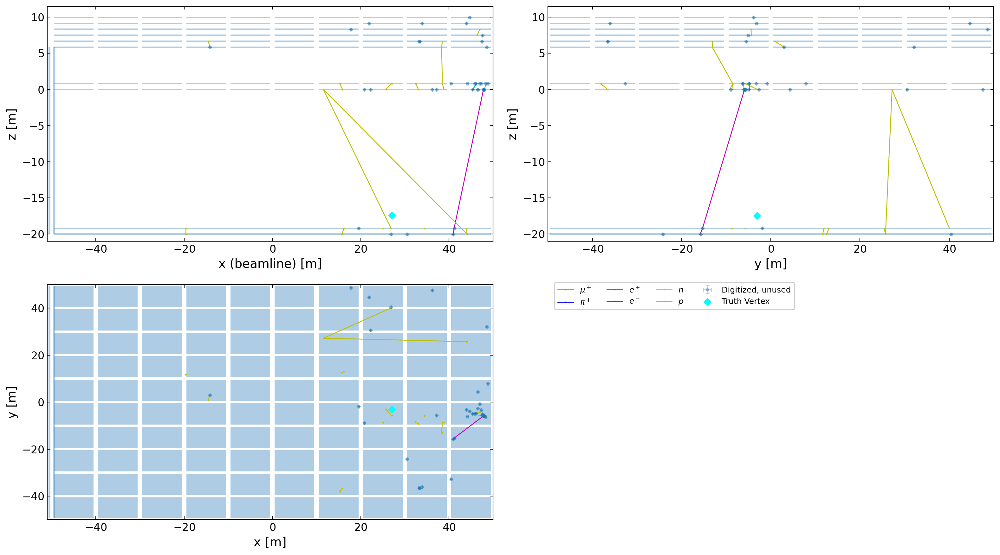

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 47==============================
[[10.0, 23.0, 15.0], [1.0, 17.0, 14.0, 5.0], [2.0, 4.0], [0.0, 3.0, 11.0], [6.0, 20.0, 8.0], [7.0, 22.0], [13.0, 19.0], [12.0, 18.0, 9.0, 16.0]]


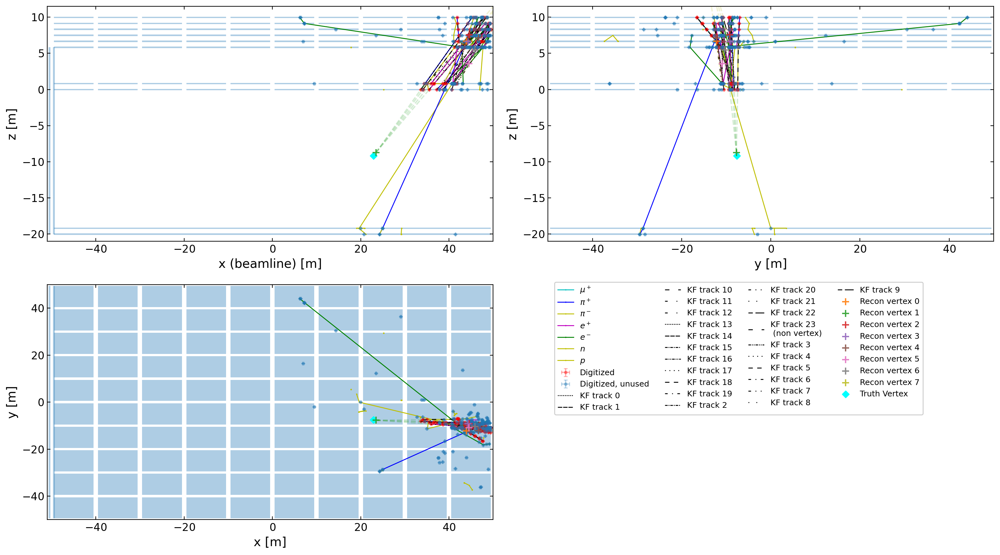

Geant4 index of particles in vertex
 [array([229736, 229737, 229795]), array([     8,     14, 438974, 713926]), array([438975, 603627]), array([ 55328, 438974, 474614]), array([    7, 29050, 29050]), array([    6, 29050]), array([ 1, 23]), array([170538, 229792, 713926, 978447])]
Geant4 index of particles in each track
 [list([772230, 474614, 474731, 768246]) list([14, 14, 14, 14, 14, 14, 14])
 list([829200, 823082, 825018, 603627])
 list([438974, 474597, 438974, 486940])
 list([438975, 481581, 823082, 824115])
 list([438974, 438974, 641435, 486940, 768287]) list([7, 7, 29050, 29051])
 list([1001089, 29051, 38959, 29051, 29050])
 list([55327, 796783, 29050, 40910])
 list([438975, 229792, 253853, 723835])
 list([229756, 229736, 238141, 238141, 238141, 238141])
 list([55328, 641434, 772230, 655994])
 list([978447, 1004379, 1004379, 1004379]) list([1, 6, 898223, 895085])
 list([8, 8, 8, 896386]) list([978896, 978908, 229737, 231992])
 list([641435, 438975, 641435, 170538])
 list([713926, 

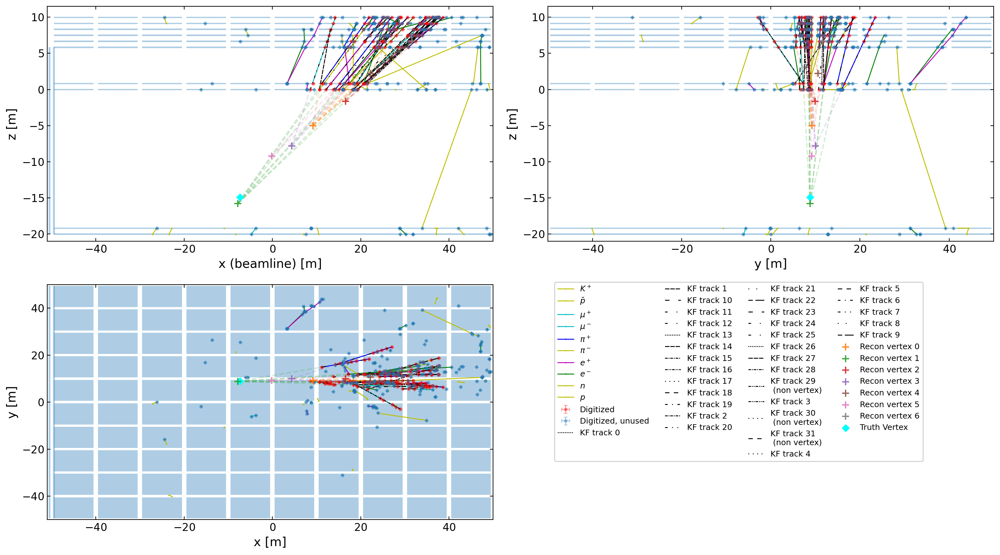

Geant4 index of particles in vertex
 [array([     3,     14,     21, 203046, 312835, 324522, 793845, 924371]), array([      2,       3,   74059,  324522,  649402,  793845, 1033593]), array([203032, 203038, 238546, 405520]), array([   21, 92765, 92769]), array([    21, 203037]), array([ 70423, 203035]), array([ 78251,  85104, 312907])]
Geant4 index of particles in each track
 [list([203038, 1033594, 1033593, 1058450])
 list([203037, 203037, 203037, 203037, 203037, 203037])
 list([3, 124155, 124155, 124155]) list([476885, 476885, 476379, 405520])
 list([203046, 424331, 405520, 405521, 421300])
 list([238546, 238546, 238546, 238546, 238546, 238546])
 list([793845, 793845, 793845, 793845, 793845])
 list([324522, 324522, 324522, 324522])
 list([92769, 124155, 124155, 124155, 124155])
 list([649402, 649402, 312835, 312835])
 list([1033593, 1033593, 1033593, 1033593]) list([3, 3, 3, 3, 3, 3, 3])
 list([793846, 793845, 871168, 871168])
 list([649402, 649402, 649403, 649403, 649403, 649403, 649

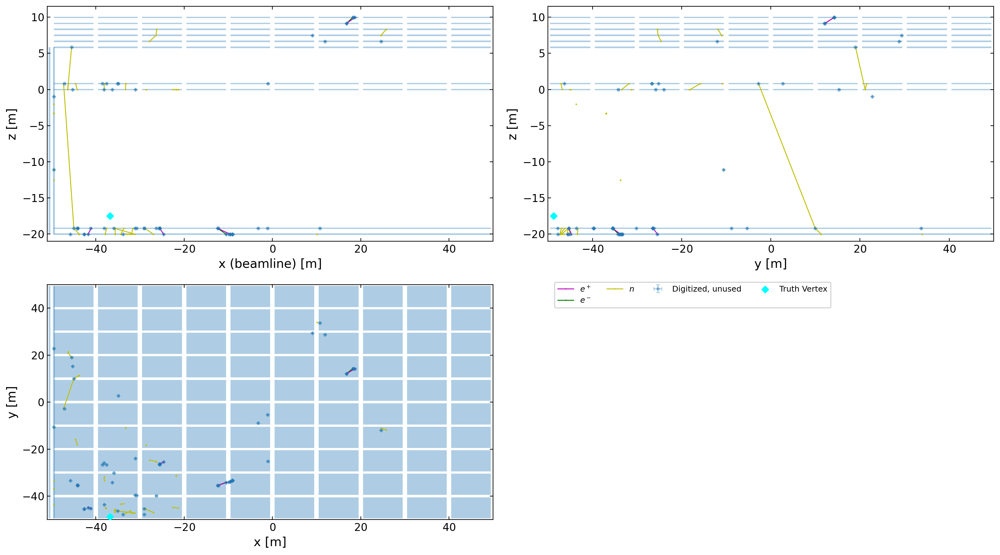

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 50==============================
[[3.0, 26.0, 29.0, 31.0, 30.0, 20.0, 0.0, 4.0, 17.0, 18.0, 1.0, 23.0, 15.0, 9.0, 13.0], [25.0, 27.0, 32.0, 8.0, 2.0, 6.0], [12.0, 22.0], [21.0, 28.0, 14.0]]


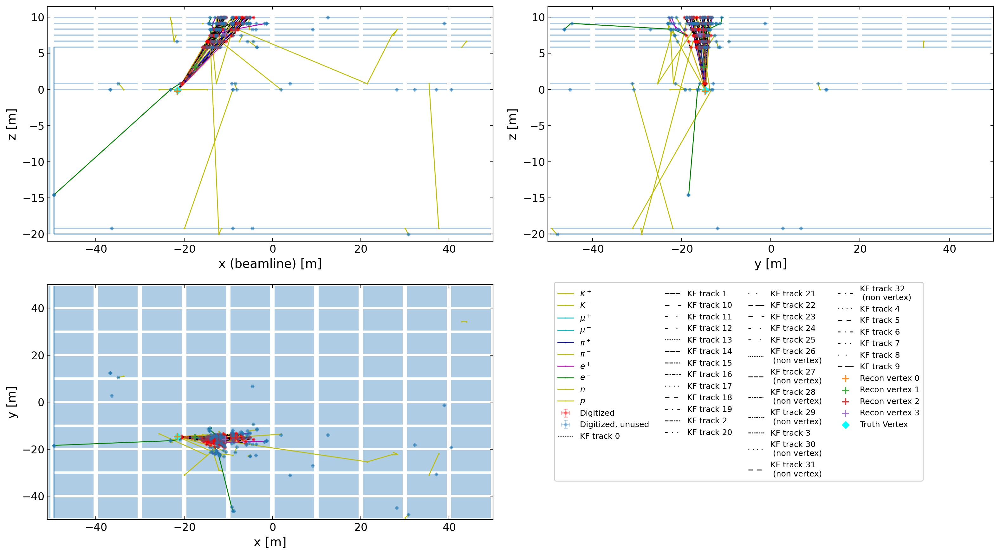

Geant4 index of particles in vertex
 [array([     1,      1,      2,      3,      7,      9,     14,     14,
           16,    106, 235900, 235901, 345546, 402838, 905752]), array([     5,      8,    106,    106, 316923, 345552]), array([7, 7]), array([ 1, 29, 29])]
Geant4 index of particles in each track
 [list([1215573, 1215573, 905756, 402838])
 list([345547, 1215833, 967583, 345546, 345546, 345546])
 list([345552, 905751, 910381, 910381]) list([1, 13, 13, 13, 13, 13])
 list([14, 15, 15, 862441, 15]) list([20, 579954, 579956, 579956])
 list([83581, 83581, 106, 106, 215029, 215029])
 list([579954, 83580, 579957, 579957, 579957, 579957]) list([5, 5, 6, 6])
 list([7, 345546, 345551, 345551, 345551, 345551])
 list([10, 995050, 905752, 345552, 345551]) list([1, 16, 349235, 349264])
 list([235900, 235901, 7, 7]) list([2, 10, 345546, 345551])
 list([83580, 29, 579954, 579954, 579954]) list([3, 6, 6, 580008])
 list([10, 345546, 345552, 345552])
 list([1215573, 1215573, 905752, 1215573])
 li

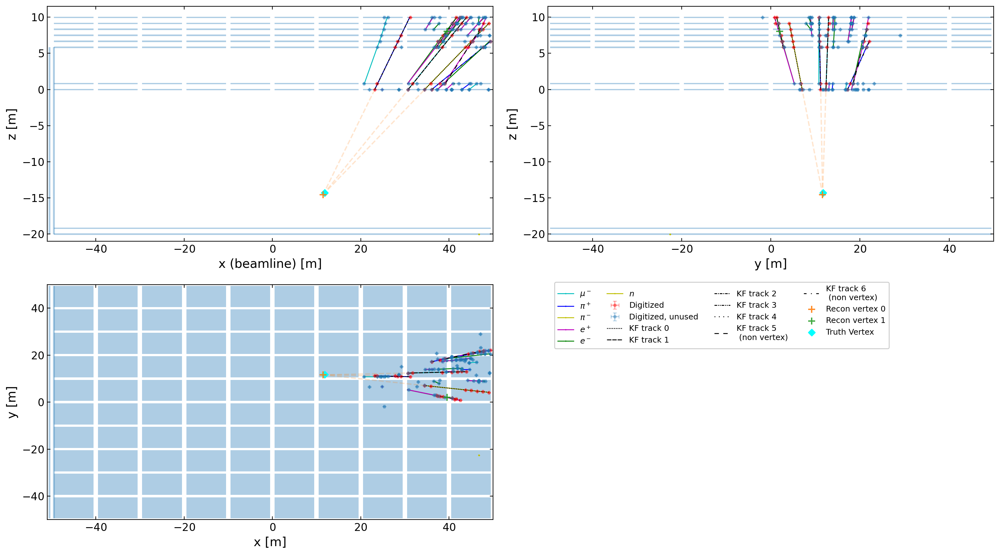

Geant4 index of particles in vertex
 [array([     1,     17, 359774]), array([359957, 359957])]
Geant4 index of particles in each track
 [list([375148, 359958, 359957, 359957])
 list([297050, 297050, 297050, 297187, 297050])
 list([1, 1, 1, 1, 1, 1, 1]) list([17, 17, 17, 17, 17, 17])
 list([359774, 359774, 359774, 359774, 359774, 359774, 359774])
 list([2, 2, 2, 2]) list([359957, 359957, 359958, 359958])]
===========================Event 52==============================
[[4.0, 6.0, 15.0, 17.0, 1.0, 12.0, 13.0], [3.0, 9.0, 8.0], [2.0, 5.0, 0.0], [14.0, 16.0]]


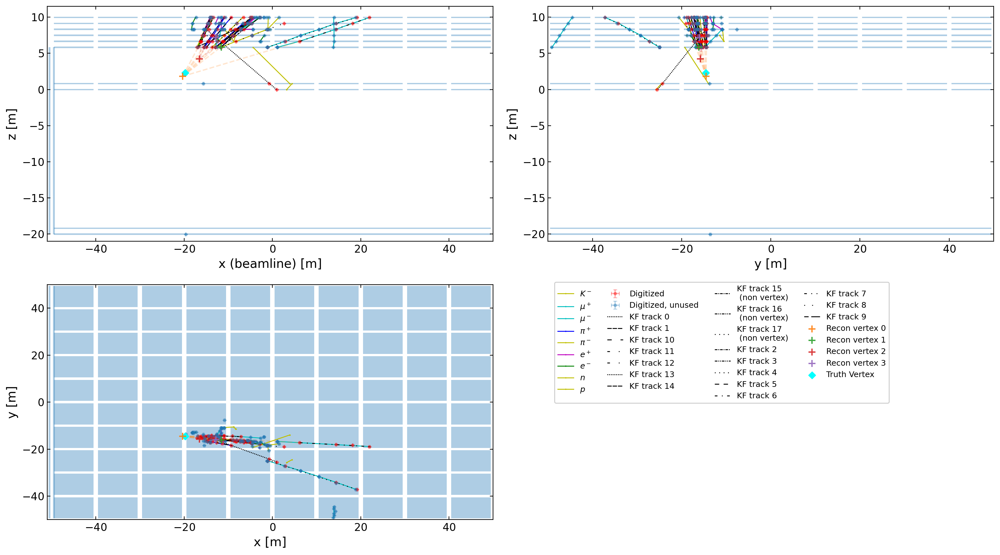

Geant4 index of particles in vertex
 [array([     4,      6,      7,     20,     24,  28963, 272927]), array([    6,     9, 68563]), array([ 1,  4, 23]), array([1, 1])]
Geant4 index of particles in each track
 [list([25, 4, 533963, 187544]) list([7, 7, 7, 7, 7, 7])
 list([23, 23, 68563, 107310])
 list([272933, 272929, 272929, 68563, 272929])
 list([24, 24, 24, 24, 24, 24]) list([1, 4, 4, 533967])
 list([6, 6, 6, 6, 6]) list([165214, 10, 258961, 258961])
 list([272934, 68563, 6, 18350]) list([9, 272935, 272935, 273135, 273142])
 list([3, 25, 25, 166552]) list([415063, 415063, 415063, 415063])
 list([20, 20, 20, 20, 20]) list([28963, 28963, 28963, 28963])
 list([3, 1, 327913, 327913]) list([272927, 328992, 328992, 328992])
 list([25, 1, 23, 107312]) list([4, 4, 4, 4])]
===========================Event 53==============================
[]


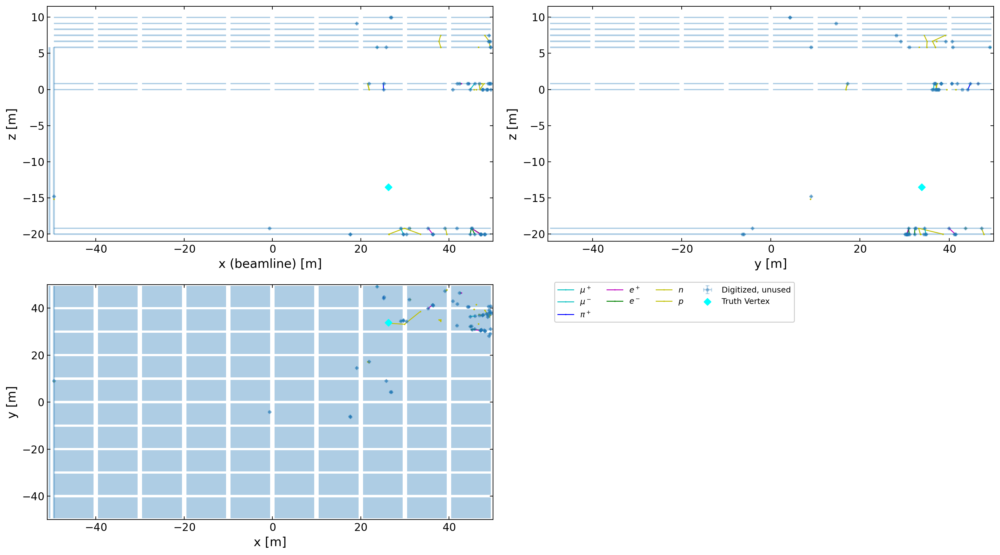

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 54==============================
[[2.0, 5.0, 10.0, 6.0, 3.0, 7.0, 0.0, 8.0, 9.0, 4.0, 1.0]]


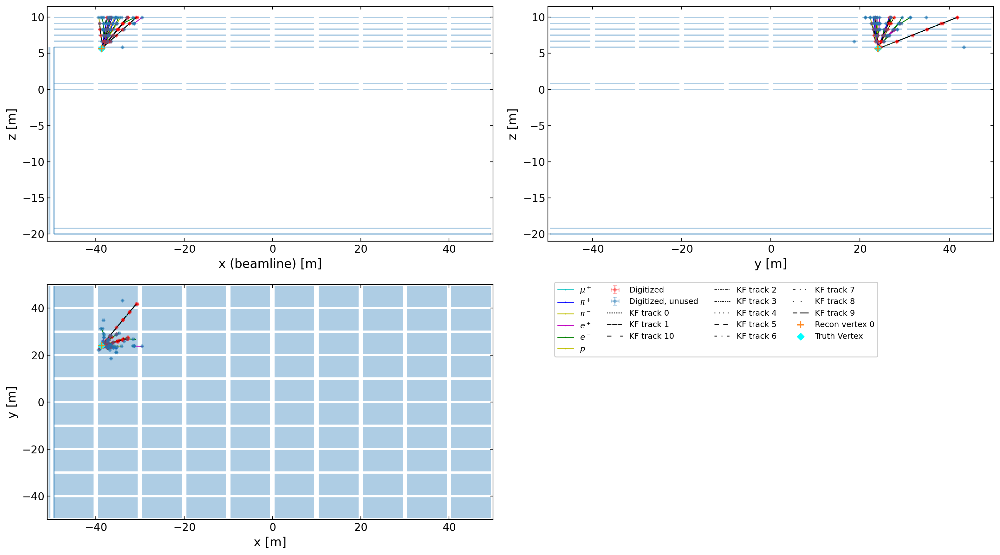

Geant4 index of particles in vertex
 [array([     1,      1,      4,      4,      6,      7,      9,      9,
       182592, 209104, 237894])]
Geant4 index of particles in each track
 [list([9, 1, 1, 1, 1]) list([1, 6, 8, 50534])
 list([470692, 9, 9, 9, 9, 9]) list([7, 8, 22, 50533, 50533])
 list([237900, 209104, 209104, 209104]) list([4, 4, 4, 4, 4, 4])
 list([4, 4, 4, 4]) list([9, 237894, 237895, 334330])
 list([7, 6, 6, 8, 103382]) list([182592, 182592, 182592, 188913])
 list([237894, 237894, 237895, 237894, 237895])]
===========================Event 55==============================
[]


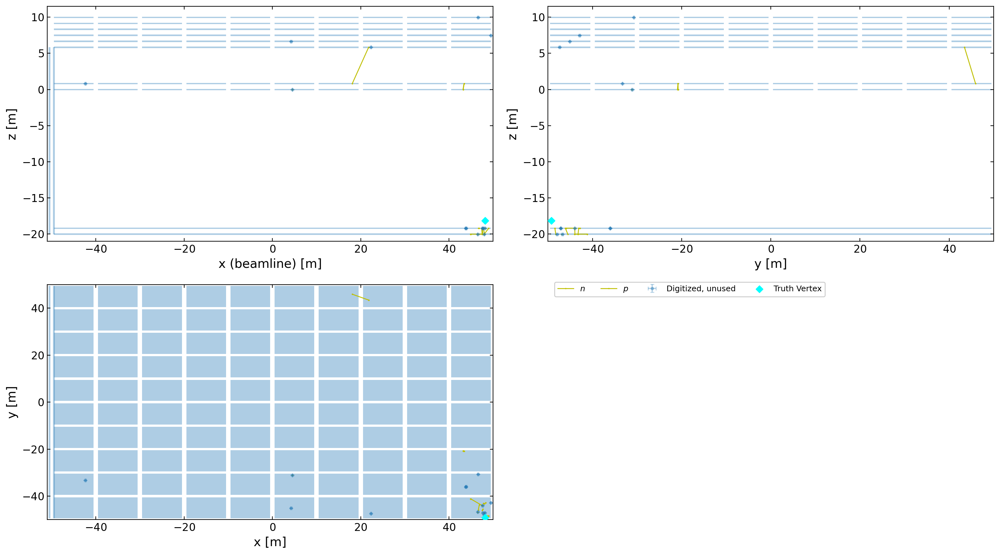

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 56==============================
[]


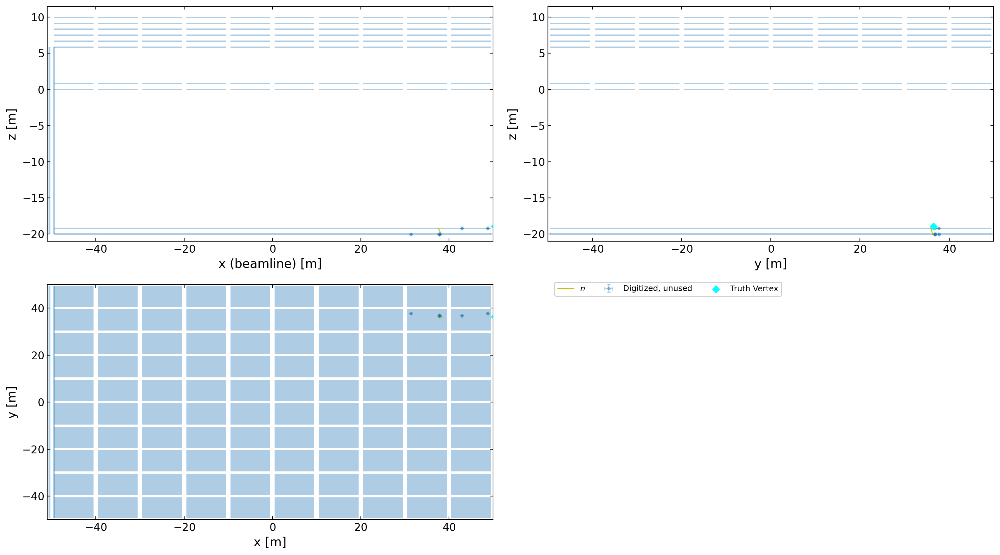

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 57==============================
[[3.0, 14.0, 15.0, 4.0, 21.0, 8.0, 1.0, 20.0, 11.0], [13.0, 16.0, 19.0], [6.0, 18.0, 12.0], [0.0, 7.0, 10.0], [5.0, 9.0], [2.0, 17.0]]


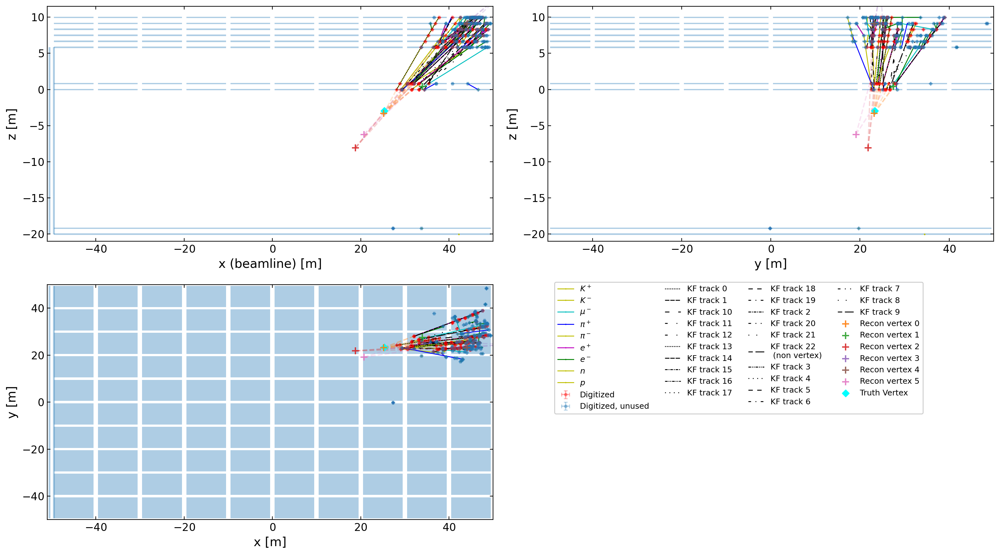

Geant4 index of particles in vertex
 [array([     9,     13,     19, 256486, 256486, 389797, 703583, 802953,
       802953]), array([11, 11, 11]), array([183493, 222394, 226284]), array([171659, 171953, 256486]), array([1, 1]), array([    13, 256487])]
Geant4 index of particles in each track
 [list([183493, 205251, 205251, 215124, 210711, 171953])
 list([703583, 703583, 751702, 751701])
 list([401794, 256595, 256487, 373680]) list([9, 9, 9, 9, 9, 9, 9, 9])
 list([256486, 256486, 256595, 256486]) list([1, 19, 205251, 172806])
 list([631173, 631173, 631173, 631173, 631173, 222394, 631173])
 list([256486, 256486, 256595, 412706]) list([19, 19, 19, 150275])
 list([1, 631177, 226210, 224454]) list([658497, 226210, 205252, 171659])
 list([401794, 256487, 256487, 256486, 360967, 256487])
 list([183493, 183493, 183493, 183493])
 list([11, 469431, 469431, 464827, 469431])
 list([802953, 802954, 802954, 803131, 803719, 812558, 812558])
 list([703582, 795532, 780906, 795532, 389797])
 list([11, 7

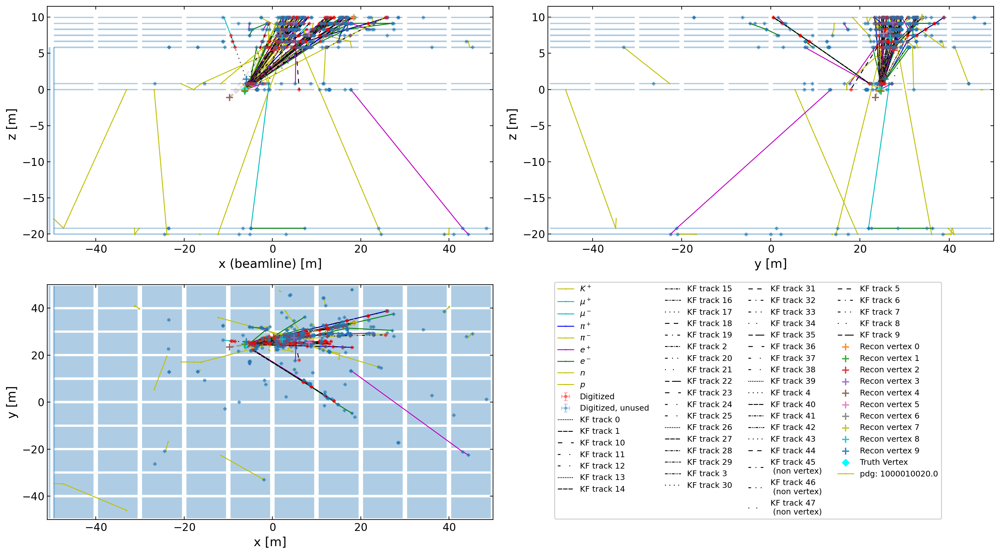

Geant4 index of particles in vertex
 [array([     1,      2,      2,      4,      4,      9,     10,     15,
           23,     24,     32, 157949, 489775, 489775, 826177, 826178]), array([     1,      5,      5,      9,     10,     70,  19967, 157949]), array([     5,     36, 437784, 847667]), array([     4,     12,     35, 929336]), array([    2, 51476, 92239]), array([4, 4]), array([11, 36]), array([351490, 811746]), array([    12, 626878]), array([   20, 20718])]
Geant4 index of particles in each track
 [list([20, 38, 9, 655275]) list([986710, 24, 626879, 626879])
 list([35, 37, 38, 12]) list([2, 41, 50, 50, 10422, 10422, 10422])
 list([745960, 20718, 20718, 20718])
 list([5, 92241, 92241, 92284, 92284, 92284])
 list([1, 655275, 11, 929336]) list([626877, 11, 929336, 699549])
 list([2, 811747, 45762, 45762]) list([12, 12, 38, 437286])
 list([15, 10, 11, 699549]) list([351471, 157950, 157950, 157949])
 list([20, 20, 986709, 986709]) list([24461, 4, 33, 37, 37])
 list([1, 16, 16, 16,

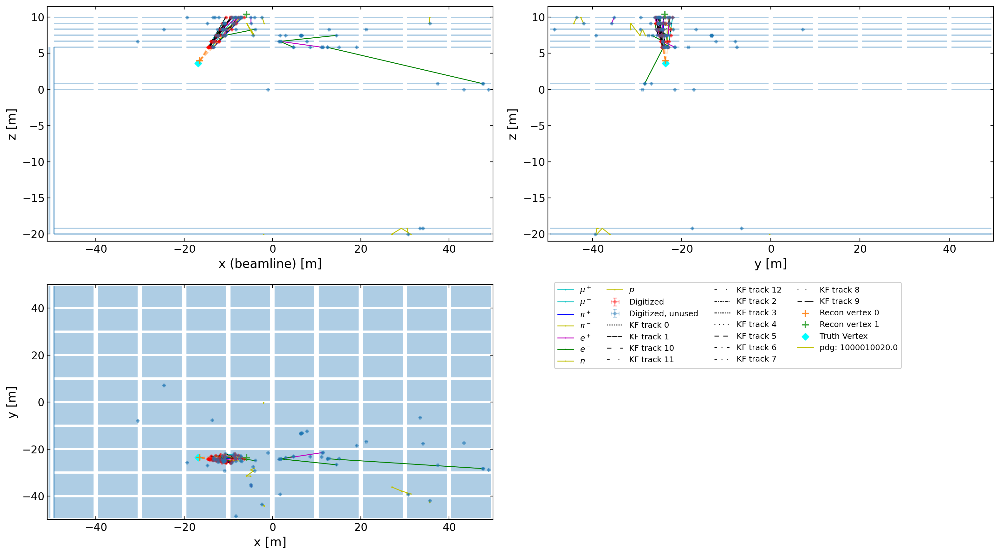

Geant4 index of particles in vertex
 [array([    4,     4,     6,     6,     6,     7,    10,    16,    17,
          17, 11354]), array([ 4, 29])]
Geant4 index of particles in each track
 [list([17, 22636, 22636, 379327]) list([21, 4, 747240, 747240])
 list([906511, 6, 906511, 906511, 918646])
 list([451881, 17, 693744, 693745, 726905]) list([6, 7, 22636, 626559])
 list([10, 693745, 4, 21]) list([18, 925441, 10, 10])
 list([11354, 11354, 11354, 11354, 11445]) list([16, 18, 18, 7])
 list([10, 6, 17, 22636]) list([4, 21, 21, 21])
 list([11354, 29, 29, 261520]) list([16, 506888, 379327, 22637])]
===========================Event 60==============================
[[3.0, 5.0, 0.0, 10.0, 7.0, 4.0, 6.0, 9.0], [1.0, 8.0]]


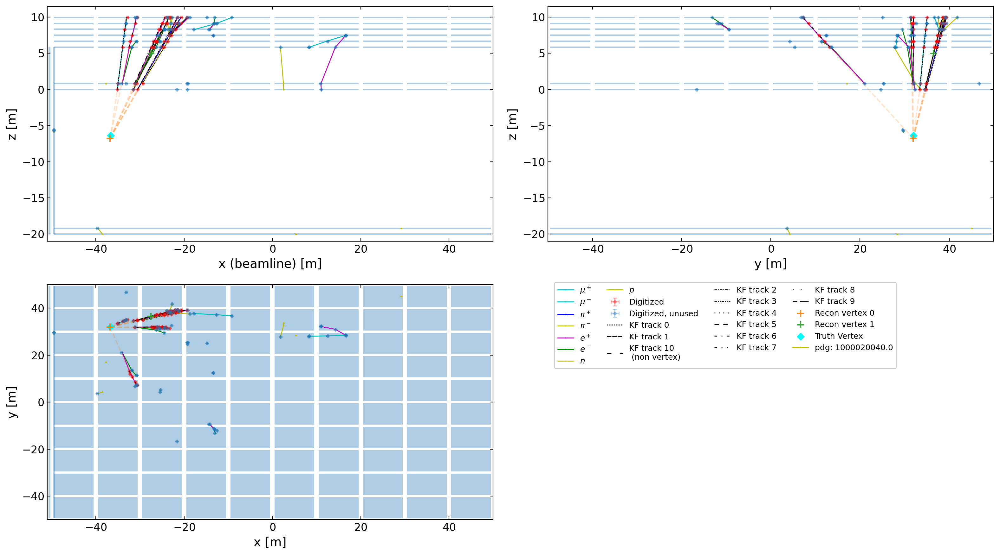

Geant4 index of particles in vertex
 [array([     4,     11,     13,     13,     14,  28749, 365943, 365943]), array([13, 14])]
Geant4 index of particles in each track
 [list([11, 11, 11, 11, 11]) list([14, 14, 69622, 69620])
 list([365944, 366037, 365943, 394602]) list([4, 4, 4, 4, 4, 4])
 list([365943, 365944, 365944, 398012, 365944])
 list([14, 14, 14, 14, 14, 14]) list([28749, 28749, 28749, 28749, 28749])
 list([13, 13, 69618, 69613, 69613, 69613])
 list([13, 192031, 192030, 207506]) list([365943, 365943, 398011, 365944])
 list([13, 69624, 69624, 250531])]
===========================Event 61==============================
[]


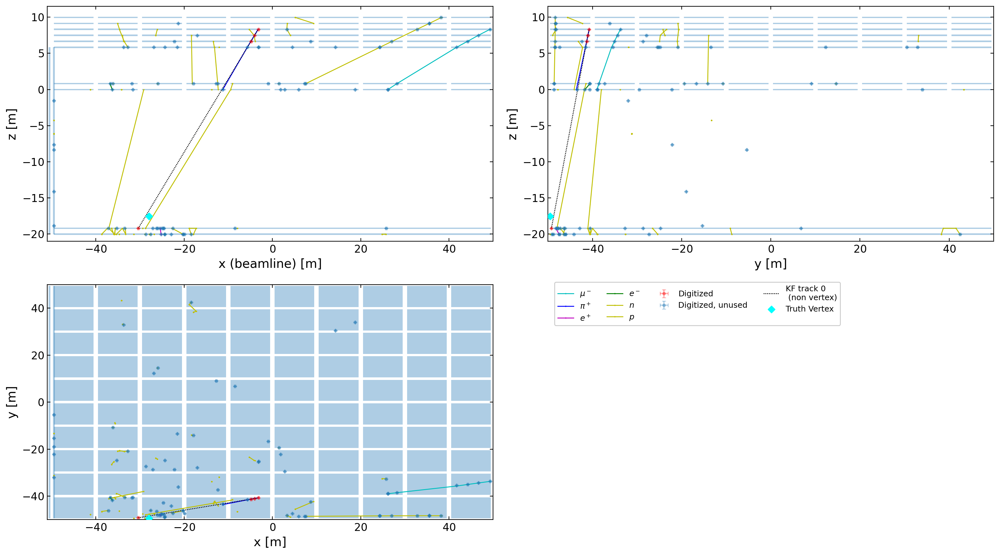

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 [[223735 86646 86646 86646]]
===========================Event 62==============================
[[3.0, 13.0, 0.0, 2.0, 11.0], [6.0, 10.0, 12.0], [9.0, 14.0, 1.0], [7.0, 8.0]]


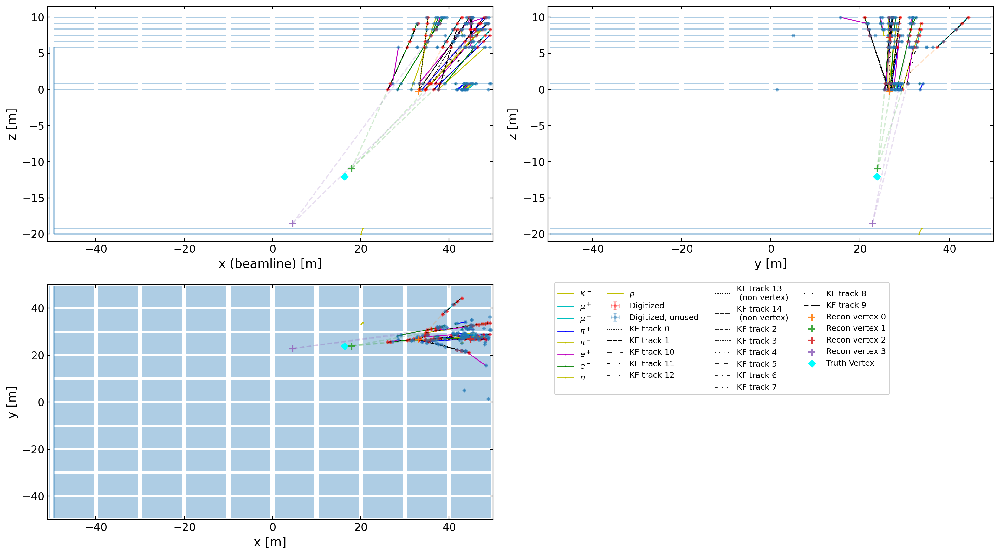

Geant4 index of particles in vertex
 [array([    12,     19,     20, 371206, 378817]), array([     3,     13, 647939]), array([    12, 426622, 449178]), array([     5, 651276])]
Geant4 index of particles in each track
 [list([19, 19, 426623, 426623]) list([426622, 464589, 464590, 464589])
 list([378817, 378817, 378817, 378817, 378817])
 list([20, 371208, 371208, 371208, 371208, 371208, 371208])
 list([12, 19, 415123, 415123]) list([953117, 13, 426540, 798304])
 list([647939, 647939, 647939, 647939, 647939, 651228])
 list([5, 5, 5, 850358]) list([651276, 839203, 839203, 839203, 839203])
 list([12, 12, 449178, 426623]) list([3, 651276, 3, 3, 3, 3])
 list([12, 489398, 489398, 489398]) list([13, 13, 13, 13])
 list([371206, 415123, 415123, 426159])
 list([449178, 454984, 454984, 464590])]
===========================Event 63==============================
[[11.0, 21.0, 18.0, 19.0, 30.0, 4.0, 14.0, 26.0, 24.0], [6.0, 22.0], [17.0, 27.0, 23.0, 5.0], [16.0, 25.0, 7.0], [20.0, 29.0], [12.0, 28.0]

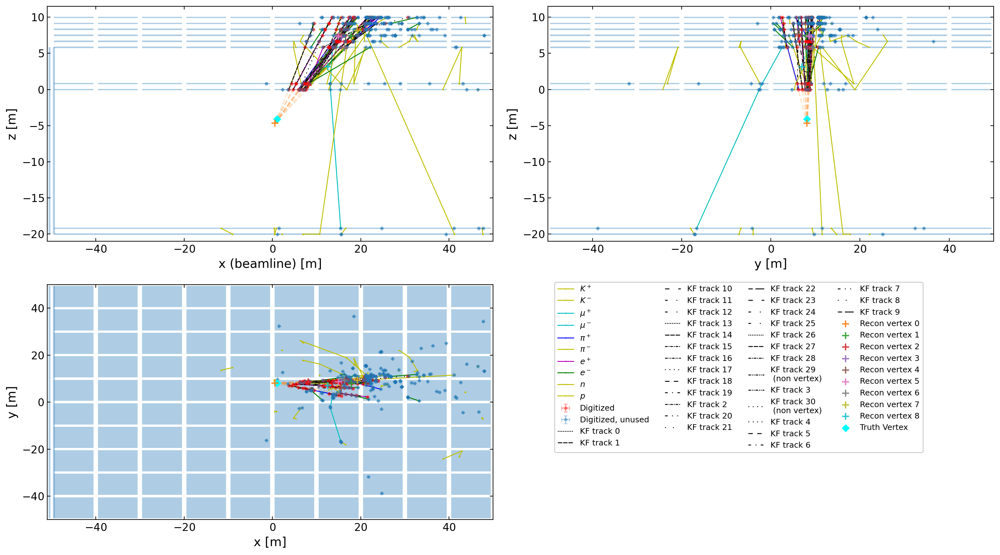

Geant4 index of particles in vertex
 [array([     13,      14,      28,  570616,  570617,  572746, 2139046,
       2521731, 2521731]), array([3, 3]), array([     2,     12,     12, 555658]), array([     2,     14, 621170]), array([ 3, 27]), array([15, 15]), array([12, 12]), array([   17, 20683]), array([12, 13, 14])]
Geant4 index of particles in each track
 [list([12, 26, 1076011, 1076011]) list([1076013, 12, 703389, 884330])
 list([27, 9547, 9547, 9547]) list([13, 13, 1076033, 20672])
 list([2139046, 2139047, 2232853, 2232852, 2232853, 2232853, 570617, 2242312])
 list([18, 12, 2329192, 14]) list([3, 2565630, 3, 1756305])
 list([14, 2329191, 2179600, 2138861])
 list([15, 2521731, 2521731, 2521835])
 list([2320395, 2438135, 17, 2438135, 1373403])
 list([12, 12, 1229484, 1229484])
 list([994624, 14, 994624, 994624, 994624, 994624, 994624, 994624])
 list([15, 15, 2232852, 2232853]) list([2521452, 2438135, 1881521, 20683])
 list([13, 1076007, 703407, 1882508]) list([2329192, 14, 15, 15])
 

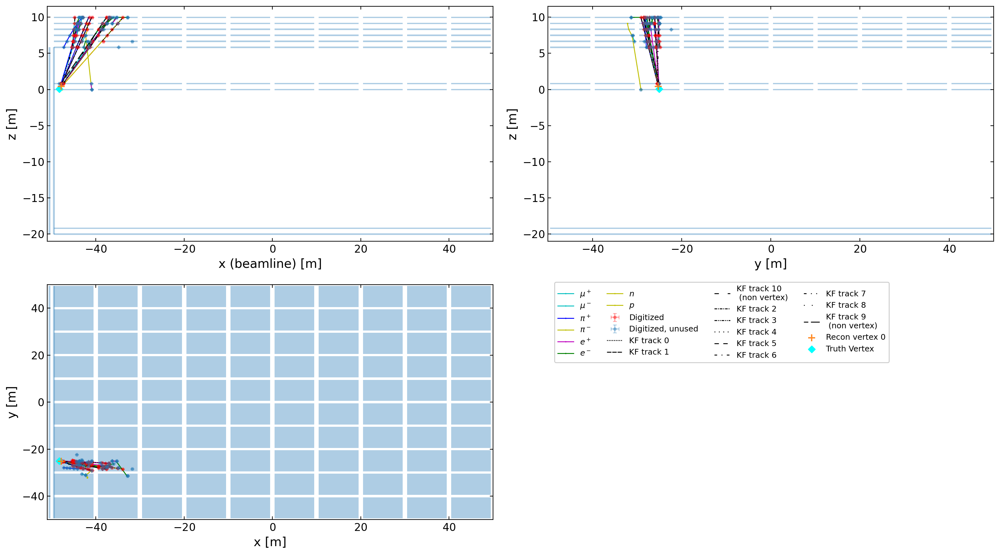

Geant4 index of particles in vertex
 [array([     1,      1,      5,      7,      7,     12,     14,  51846,
       151937])]
Geant4 index of particles in each track
 [list([1, 19, 19, 19, 19]) list([151937, 151937, 151938, 151938])
 list([7, 309731, 309731, 309731])
 list([151937, 51846, 51847, 51847, 51846, 51847]) list([13, 10, 5, 10])
 list([249056, 249056, 249056, 249056, 249056, 249056])
 list([12, 5, 5, 5, 5, 5]) list([14, 14, 14, 14, 14, 14, 14])
 list([20, 1, 9, 1, 9, 1, 9]) list([12, 12, 12, 12, 12])
 list([7, 7, 7, 7, 7])]
===========================Event 65==============================
[]


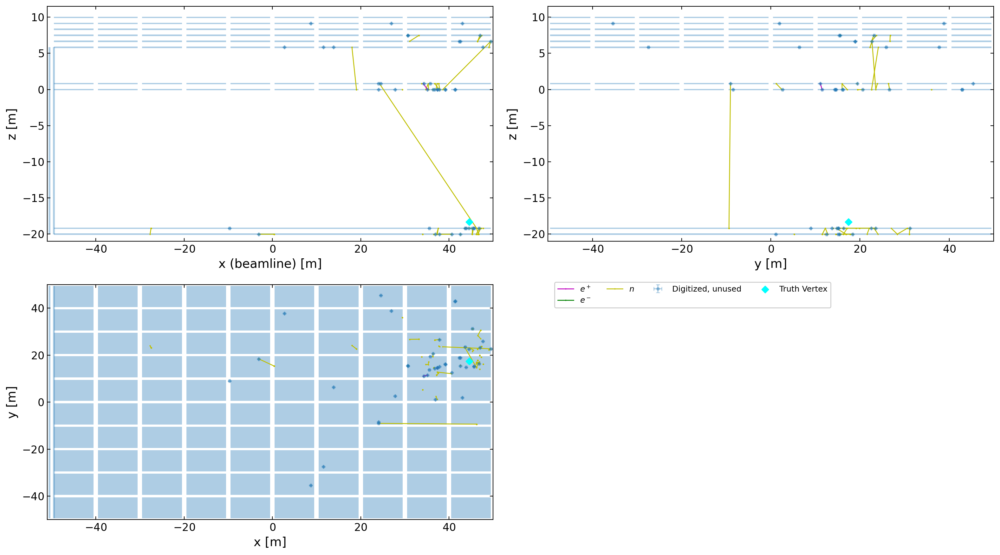

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 66==============================
[[0.0, 8.0, 12.0, 13.0, 10.0, 11.0, 4.0, 2.0, 14.0], [1.0, 7.0, 6.0], [5.0, 9.0]]


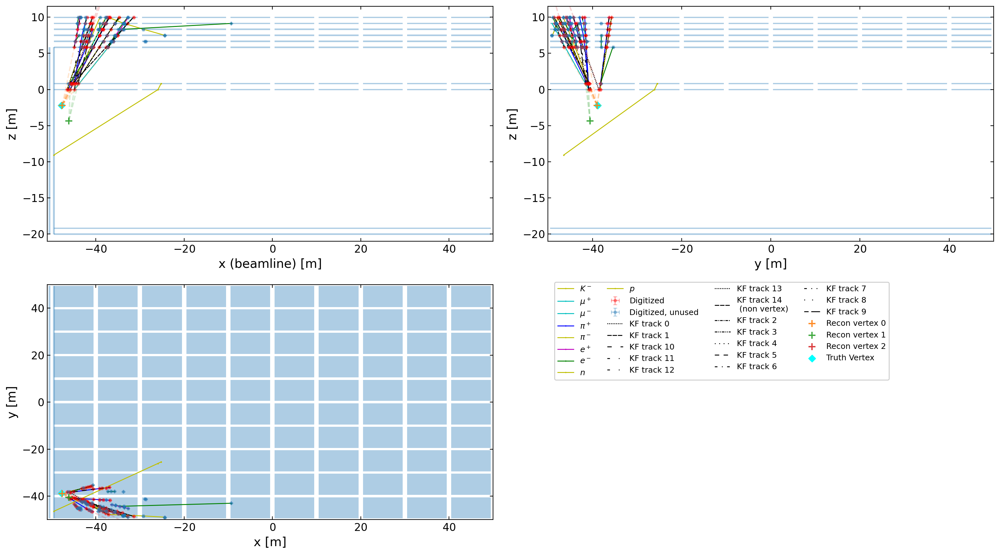

Geant4 index of particles in vertex
 [array([     2,      4,     12,     14,     15,     18,  11005, 530402,
       530404]), array([ 1, 13, 19]), array([ 4, 19])]
Geant4 index of particles in each track
 [list([12, 641718, 12, 12, 12, 12, 12, 12])
 list([15, 1, 1, 822057, 822057]) list([19, 2, 2, 2, 2])
 list([17, 530682, 530682, 530682, 530682])
 list([11005, 11006, 11006, 11006, 11006, 11006])
 list([19, 102296, 19, 19]) list([19, 530403, 822081, 822081])
 list([15, 13, 822081, 822081, 822081]) list([14, 14, 14, 14, 14, 14, 14])
 list([4, 822057, 822057, 822057]) list([18, 18, 310531, 310531, 310531])
 list([4, 4, 4, 4, 4, 4]) list([530402, 530402, 530402, 530402, 530402])
 list([15, 15, 15, 15]) list([530404, 530404, 530404, 530404])]
===========================Event 67==============================
[[1.0, 7.0, 5.0, 8.0, 3.0, 10.0, 9.0, 0.0, 2.0], [4.0, 6.0]]


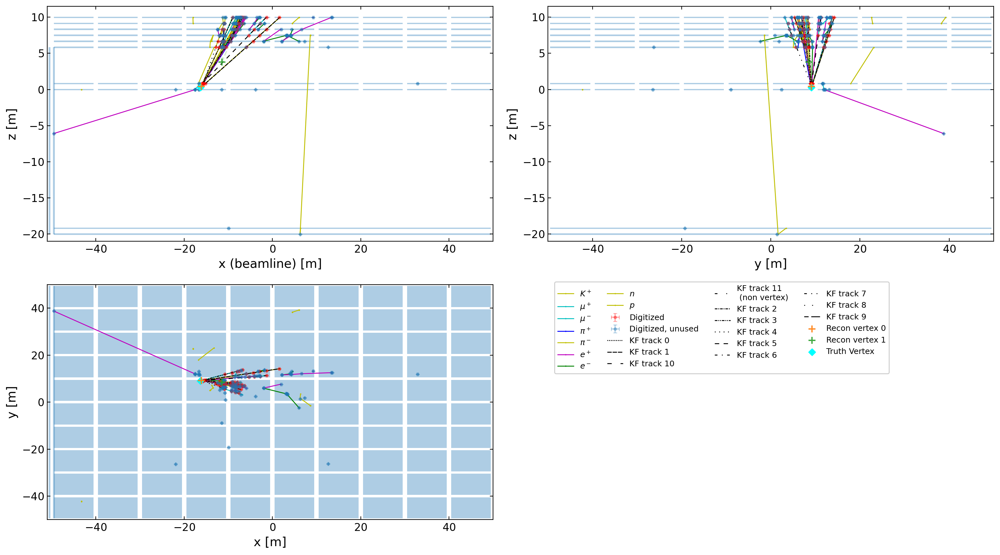

Geant4 index of particles in vertex
 [array([     5,      6,      9,     11,     12,     15,     16,     20,
       342145]), array([    24, 202299])]
Geant4 index of particles in each track
 [list([11, 342200, 342200, 342200, 342200]) list([5, 7, 7, 7, 7, 7])
 list([16, 202299, 202299, 202300, 202300, 202300])
 list([6, 272312, 272312, 272312, 272312, 272312])
 list([237416, 202299, 398403, 398403, 398403])
 list([12, 83190, 83190, 83190, 83190]) list([24, 272310, 289990, 290244])
 list([15, 15, 15, 15, 15, 15]) list([9, 9, 9, 9, 9, 9])
 list([342145, 342145, 342145, 342145])
 list([20, 321859, 321859, 321859, 321859])
 list([12, 499441, 202299, 237417])]
===========================Event 68==============================
[[1.0, 20.0, 7.0, 3.0, 6.0, 5.0, 9.0, 4.0, 23.0, 13.0, 18.0, 19.0, 22.0, 16.0, 8.0], [14.0, 15.0, 2.0], [11.0, 17.0], [0.0, 21.0], [10.0, 12.0]]


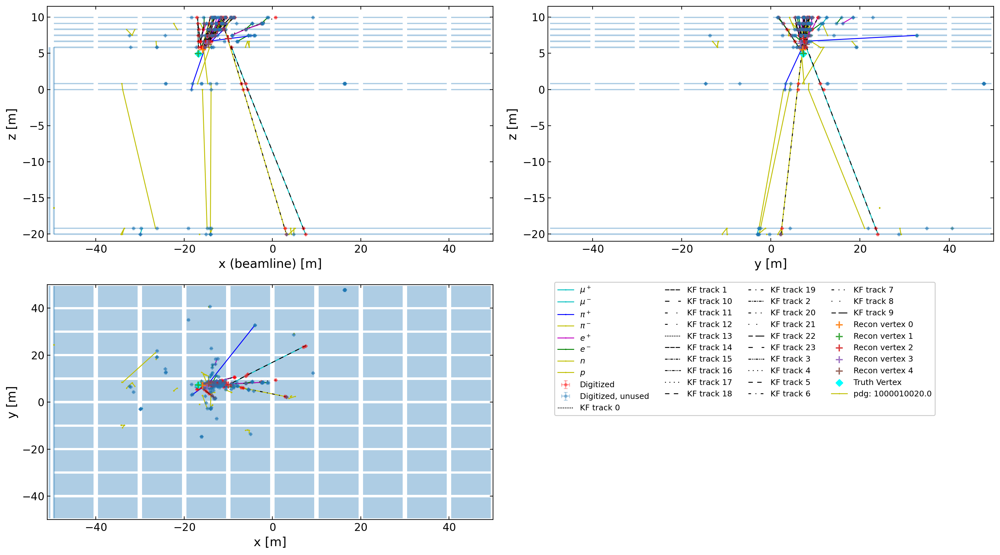

Geant4 index of particles in vertex
 [array([     3,      4,      4,      8,     15,     15,     19,     29,
           30,     34,  17850,  44654, 150641, 172056, 515608]), array([ 4,  7, 13]), array([ 3, 19]), array([     3, 177450]), array([ 5, 19])]
Geant4 index of particles in each track
 [list([490718, 504725, 204863, 177450])
 list([29, 19, 436793, 228695, 15, 504725])
 list([4, 134922, 684414, 30, 43002])
 list([150641, 490718, 490718, 490717, 525103]) list([3, 8, 8, 684415])
 list([150528, 504726, 174356, 44654]) list([684413, 490717, 30, 30])
 list([15, 134922, 134922, 134922]) list([5, 17849, 4, 4])
 list([29, 34, 134922, 134922]) list([5, 30, 17850, 17850])
 list([3, 773391, 773391, 773391, 773391, 773391])
 list([178530, 19, 684411, 44745]) list([4, 774249, 7, 7])
 list([7, 7, 7, 7]) list([13, 13, 13, 13, 13, 13])
 list([8, 30, 17849, 684414, 684414])
 list([19, 642012, 642012, 642012, 642012])
 list([17850, 684418, 684450, 684415])
 list([172056, 172056, 174589, 174590])


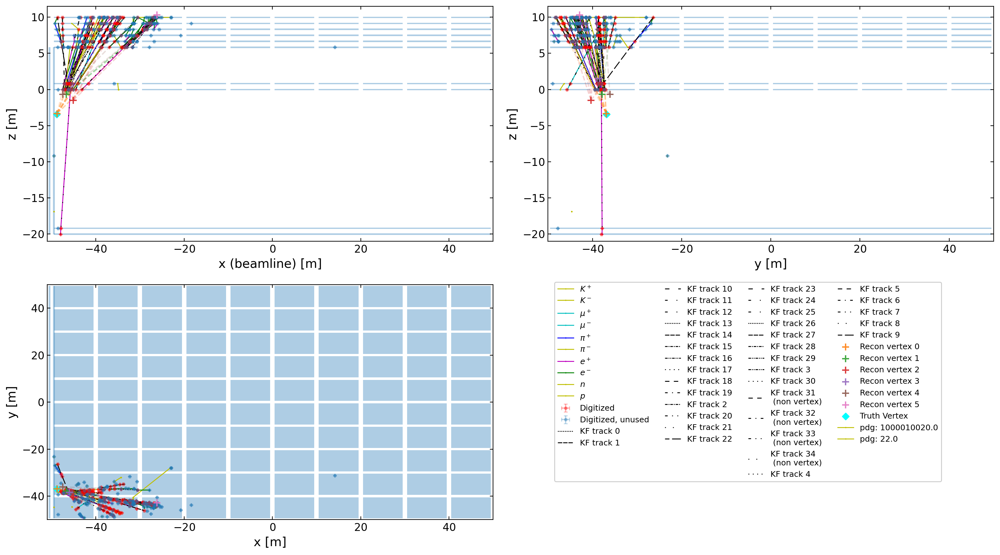

Geant4 index of particles in vertex
 [array([     6,     11,     16,     22,     22,     25,     25,     26,
       172177, 261406, 344400, 455948]), array([     4,     11,     11, 362878, 542233, 556140]), array([     6,     17,     22, 261406, 323861]), array([2, 2, 4]), array([    17, 345792, 572484]), array([306024, 336028])]
Geant4 index of particles in each track
 [list([455948, 455948, 455949, 457875])
 list([455949, 757100, 757100, 757100, 757100, 757100])
 list([22, 23, 22, 23, 23, 23, 23])
 list([5, 4, 630983, 630983, 630983, 630983, 630983])
 list([339867, 323861, 323862, 339867, 417709])
 list([11, 362879, 323861, 341077]) list([26, 26, 36966, 36965, 36965])
 list([631244, 631244, 631244, 631244]) list([16, 16, 16, 16, 16, 16, 16])
 list([408028, 341077, 323862, 306024])
 list([469566, 469566, 237271, 469725])
 list([362878, 362879, 362879, 417709, 417709])
 list([261407, 261407, 261406, 261406, 261406, 261406])
 list([17, 542236, 542236, 559725]) list([469566, 111301, 1113

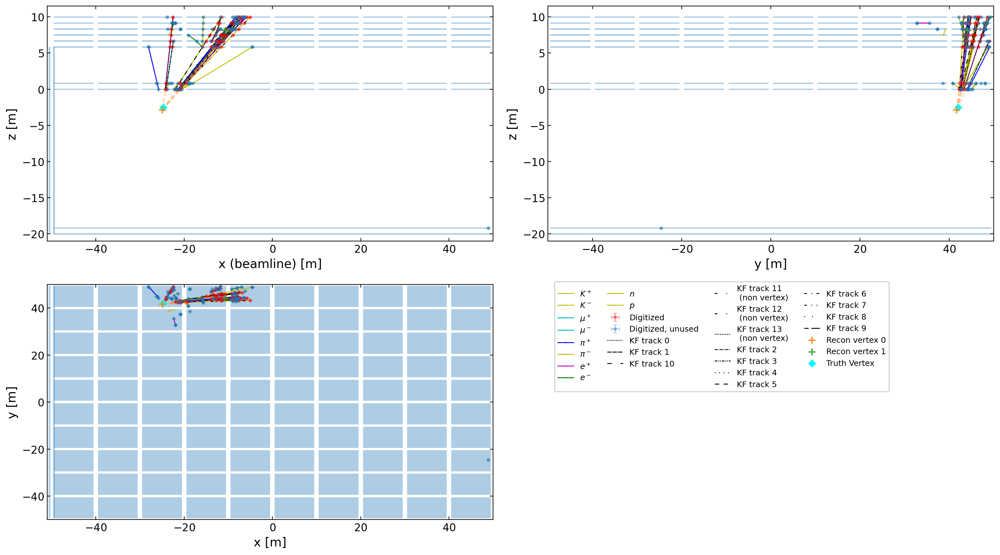

Geant4 index of particles in vertex
 [array([     5,      7,     10,     10,     12,     22,  68816, 192414]), array([11, 12, 12])]
Geant4 index of particles in each track
 [list([68816, 441966, 425197, 425197]) list([11, 12, 18, 18, 18])
 list([10, 19, 19, 19, 141597, 19]) list([12, 68817, 425197, 425196])
 list([5, 5, 5, 5, 5, 5, 396607, 5]) list([22, 22, 425196, 425197])
 list([7, 7, 11, 11, 11, 11, 11, 11]) list([18, 13, 13, 12])
 list([12, 12, 13, 13]) list([10, 10, 10, 10, 10, 286126])
 list([425196, 22, 22, 22, 22, 22]) list([13, 153668, 12, 12])
 list([523410, 523410, 523410, 523410])
 list([192414, 192414, 192414, 192516])]
===========================Event 71==============================
[[2.0, 7.0], [5.0, 12.0, 19.0, 10.0, 8.0, 13.0, 1.0, 6.0], [3.0, 4.0, 15.0, 9.0], [0.0, 18.0, 17.0]]


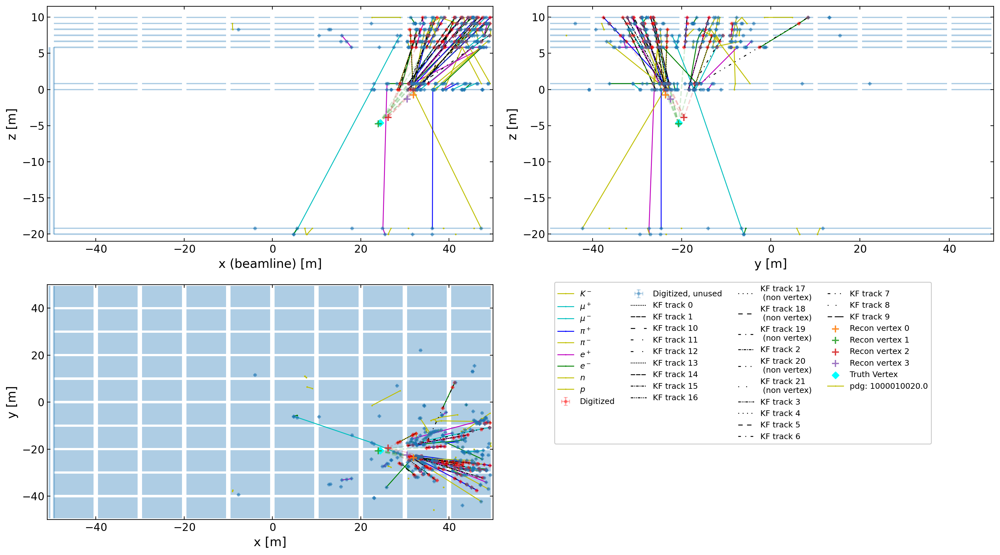

Geant4 index of particles in vertex
 [array([     6, 593311]), array([     3,      5,      8,     16,   4677,  69145, 176704, 640885]), array([    16, 141593, 336725, 436643]), array([     8,     19, 407053])]
Geant4 index of particles in each track
 [list([19, 476042, 476045, 476045]) list([8, 593311, 8, 662474, 662474])
 list([6, 4676, 476042, 476042, 476042, 476042])
 list([336725, 336726, 336726, 336726])
 list([16, 593363, 593363, 593363, 593363])
 list([640885, 640885, 640885, 640885, 640885, 640885])
 list([5, 706958, 706967, 706967, 706967, 706967, 706967])
 list([593311, 652176, 652176, 652176, 652176, 652176, 652176])
 list([3, 3, 3, 3, 3, 3]) list([141593, 141593, 141593, 141593, 141593])
 list([176704, 176704, 176705, 176704])
 list([476227, 476045, 480673, 480673])
 list([337770, 69145, 337771, 337771, 337771, 337771, 337771])
 list([4677, 5012, 5012, 5012, 5764])
 list([302225, 302225, 302225, 302225])
 list([436643, 436643, 436643, 436643, 436643])
 list([94765, 397412, 

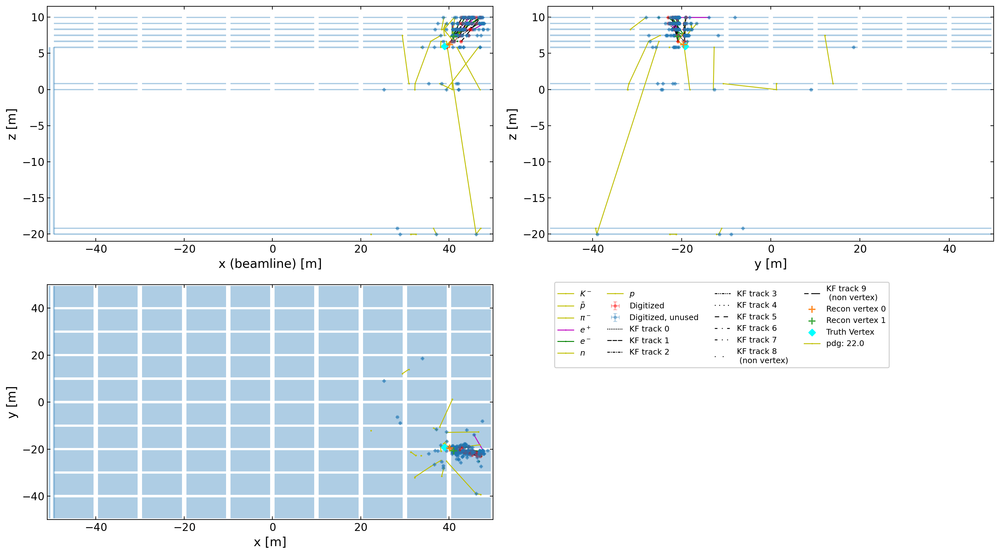

Geant4 index of particles in vertex
 [array([    3,     3,     9, 44088, 49306, 83301]), array([ 92307, 111436])]
Geant4 index of particles in each track
 [[23271 4 3 55896]
 [284114 208211 206123 185657]
 [44088 279342 86878 86878]
 [111436 380422 206464 179781]
 [23301 26 3 218391]
 [380031 209886 83667 83301]
 [380423 92307 129522 129522]
 [23424 156252 112904 189614]
 [49306 52324 189614 181698]
 [9 379293 295137 294717]]
===========================Event 73==============================
[[0.0, 6.0, 13.0, 1.0, 4.0, 5.0, 2.0, 10.0, 8.0, 9.0, 7.0], [3.0, 15.0], [12.0, 14.0], [16.0, 17.0]]


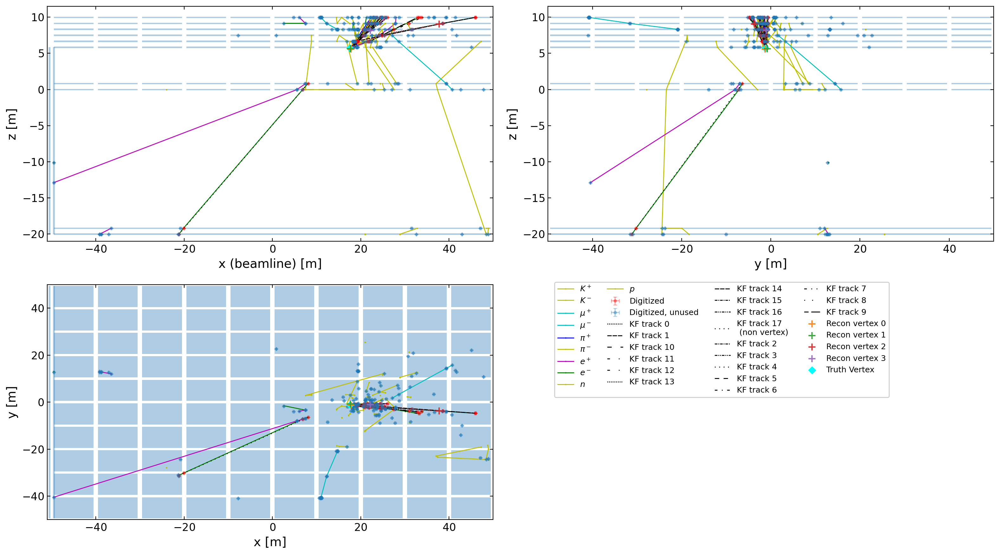

Geant4 index of particles in vertex
 [array([     4,      6,      6,      7,     15,     15,     15,     17,
           22, 176714, 176714]), array([     3, 176714]), array([    33, 176715]), array([14, 20])]
Geant4 index of particles in each track
 [list([176714, 15, 32, 22622, 192239]) list([4, 25, 25, 878405])
 list([6, 817562, 33, 669813]) list([17, 3, 19, 142592, 558961])
 list([176714, 6, 7, 7]) list([352628, 29, 22, 22])
 list([878404, 224250, 15, 15, 489780, 15]) list([15, 16, 16, 616253, 16])
 list([14, 7, 28, 33]) list([176714, 176714, 176714, 182862])
 list([176714, 176714, 192135, 191316])
 list([879312, 879312, 879312, 879312])
 list([176715, 228675, 228675, 228675]) list([176714, 605011, 32, 17])
 list([33, 228675, 228675, 228675]) list([191837, 176715, 176715, 176714])
 list([660362, 20, 771014, 771015]) list([14, 22622, 22, 29])]
===========================Event 74==============================
[[2.0, 8.0, 0.0], [1.0, 7.0, 11.0, 12.0, 14.0, 5.0, 3.0, 13.0], [15.0, 16.0]

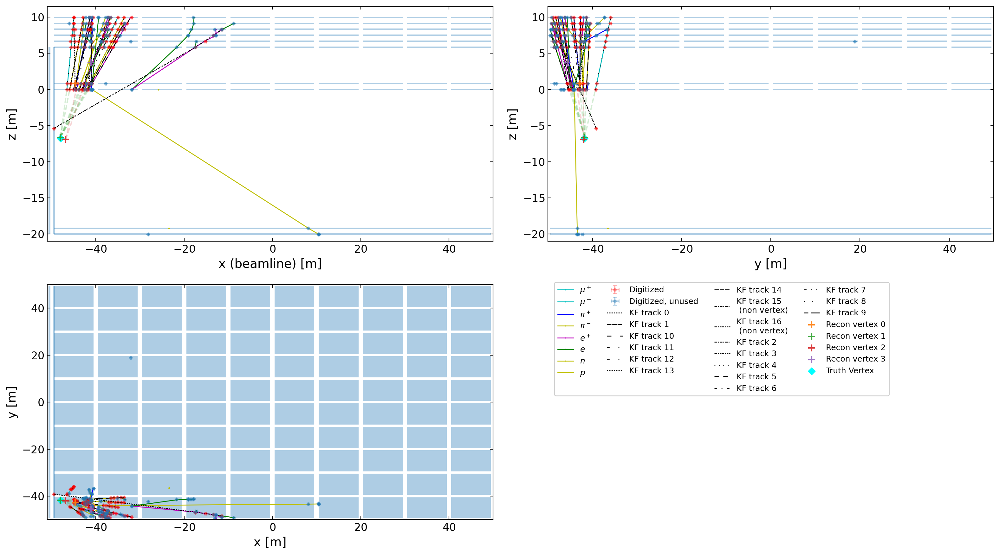

Geant4 index of particles in vertex
 [array([     1,      1, 348239]), array([    17,     18,     24,     31,     71,  88289, 131651, 186955]), array([15, 31]), array([ 88288, 118420])]
Geant4 index of particles in each track
 [list([1, 348237, 1, 1, 1, 1, 1]) list([17, 17, 17, 17, 17, 17, 17, 17])
 list([348240, 348239, 407894, 407894, 407894, 407894, 407894, 407894])
 list([18, 18, 18, 18, 18, 18, 18]) list([88288, 118420, 651103, 651103])
 list([71, 71, 71, 71, 71, 71, 71, 71])
 list([186954, 186954, 729428, 729428, 729428])
 list([24, 24, 24, 24, 24, 24, 24, 24])
 list([1, 348239, 348239, 348239, 348239, 348239, 348239])
 list([118420, 651103, 651103, 651103])
 list([132644, 696441, 696441, 696790, 696790])
 list([88289, 88289, 88289, 88289, 88289, 88289])
 list([31, 31, 4121, 4121, 4121, 4121, 4121, 4121])
 list([131651, 131651, 186954, 186954, 205292])
 list([186955, 186955, 186955, 186955]) list([31, 50555, 50555, 50555])
 list([15, 15, 388882, 388882])]
========================

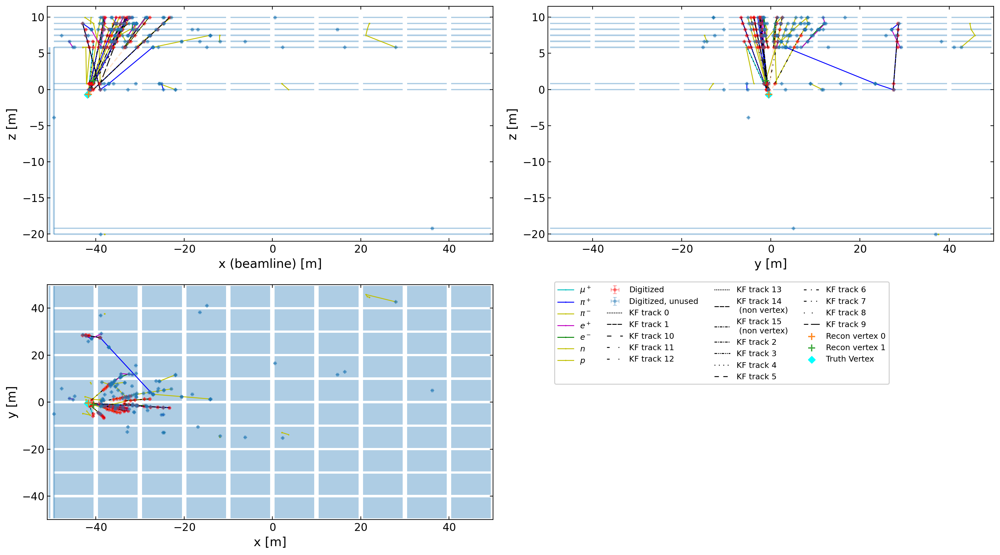

Geant4 index of particles in vertex
 [array([ 2,  4,  4,  5, 12, 13, 22, 23, 23, 34]), array([ 8, 13, 22, 36])]
Geant4 index of particles in each track
 [list([469518, 490653, 490653, 490653, 490653, 490653, 490653])
 list([22, 4, 4, 4, 4, 4, 4, 4]) list([13, 13, 13, 13, 13])
 list([2, 2, 2, 2, 2]) list([4, 407758, 407758, 407758])
 list([34, 22, 35, 35, 35, 35]) list([18, 5, 5, 5, 5, 5, 5])
 list([31, 22, 22, 22, 22, 22, 22]) list([19, 31, 31, 13])
 list([23, 34, 34, 43391]) list([8, 34, 31, 19, 19, 19])
 list([36, 268189, 268189, 268189]) list([23, 23, 23, 23, 23, 23, 23])
 list([34, 43356, 34, 34]) list([12, 12, 12, 12, 12])
 list([204269, 204269, 209716, 214369])]
===========================Event 76==============================
[]


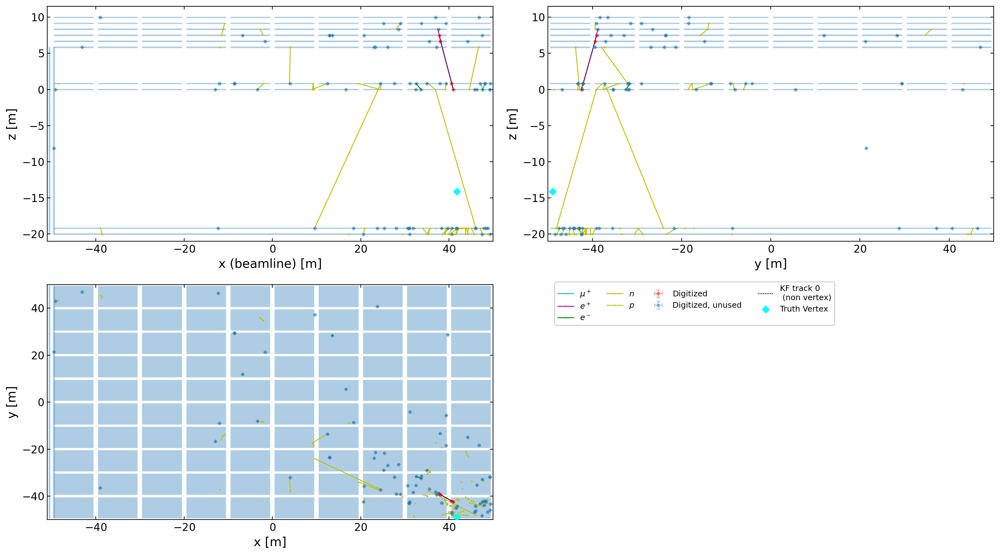

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 [[36711 36711 36711 36711]]
===========================Event 77==============================
[]


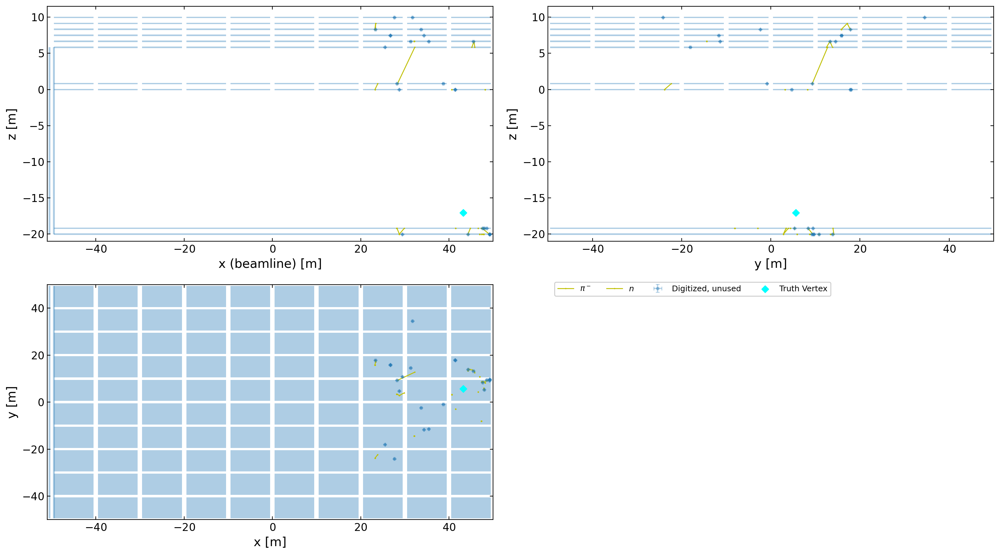

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 78==============================
[]


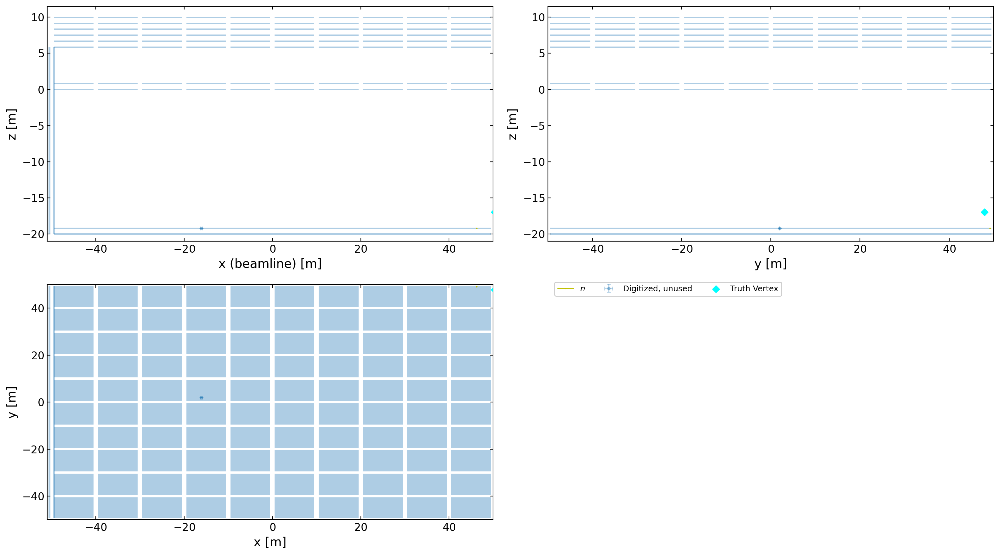

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 79==============================
[[7.0, 13.0, 4.0, 1.0, 15.0, 9.0, 3.0, 6.0, 11.0], [0.0, 10.0, 12.0], [2.0, 8.0, 5.0]]


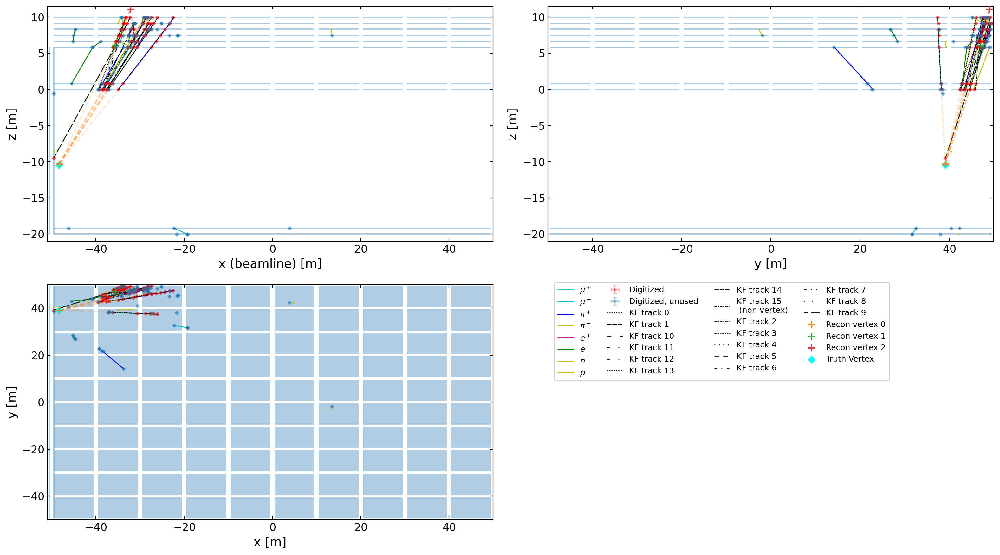

Geant4 index of particles in vertex
 [array([     3,      3,      9,     10,     18,     19,  89385, 100152,
       211160]), array([     3,     13, 211260]), array([     3, 211165, 211261])]
Geant4 index of particles in each track
 [list([13, 211161, 211161, 211161, 211161, 211161, 211161])
 list([3, 3, 3, 574000]) list([211165, 211165, 211165, 211165, 211165])
 list([211160, 211160, 211160, 211160, 319275])
 list([89385, 89385, 89385, 89385, 89385, 89385, 89385])
 list([3, 10, 10, 361416]) list([3, 404768, 404768, 404769, 547289])
 list([19, 19, 19, 19, 19, 19, 19]) list([547089, 547089, 211315, 211261])
 list([9, 9, 9, 9, 9, 9, 199817, 9]) list([3, 10, 211161, 310443])
 list([10, 10, 10, 404768]) list([627822, 627822, 211265, 211260])
 list([18, 18, 18, 18, 18, 18]) list([5, 5, 361417, 361416])
 list([100152, 100153, 100153, 100153])]
===========================Event 80==============================
[[0.0, 2.0, 4.0, 5.0, 1.0]]


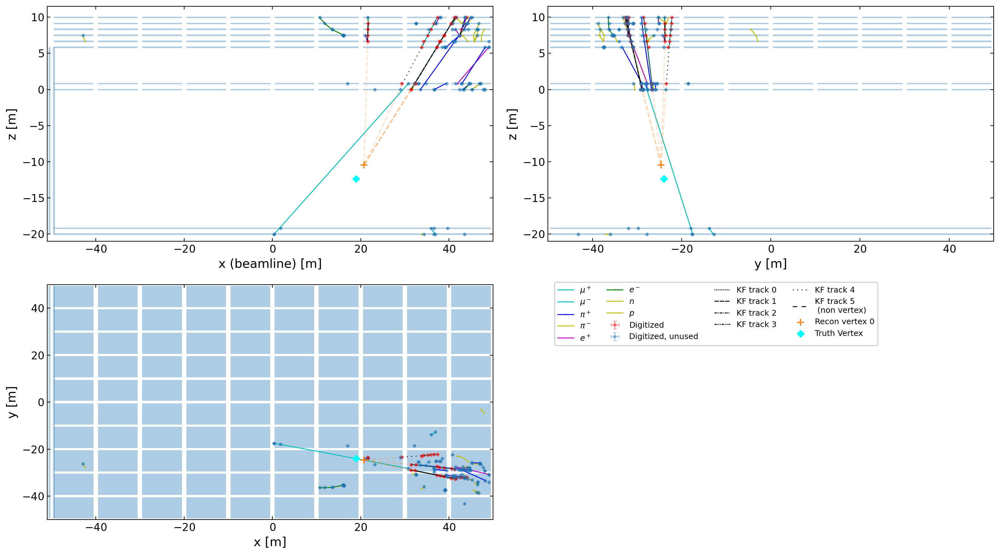

Geant4 index of particles in vertex
 [array([     6,      6,     30, 135136, 144242])]
Geant4 index of particles in each track
 [list([144242, 144242, 144242, 144242, 144242, 144242, 144242])
 list([135136, 135181, 135181, 135181, 135181, 135181, 135181])
 list([6, 6, 6, 50058]) list([405281, 405280, 427465, 427465])
 list([6, 6, 6, 6]) list([30, 30, 30, 30])]
===========================Event 81==============================
[[1.0, 2.0, 0.0, 3.0]]


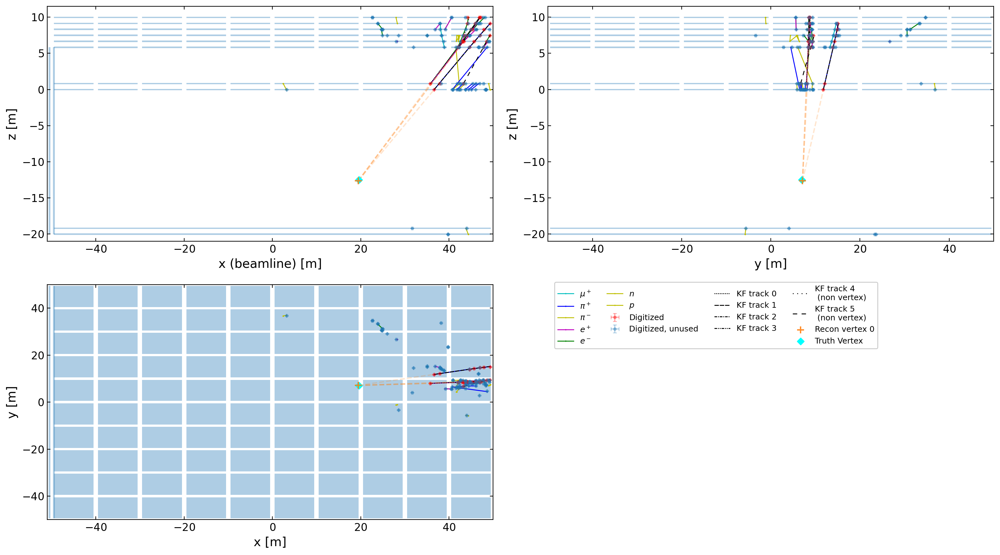

Geant4 index of particles in vertex
 [array([     1, 428854, 428855, 428855])]
Geant4 index of particles in each track
 [list([428855, 434707, 434707, 434708])
 list([428854, 428854, 430425, 451234, 451234, 434707, 451234])
 list([1, 1, 1, 1, 982480, 1, 1]) list([428855, 429162, 451234, 434707])
 list([462673, 451235, 428854, 428854]) list([19, 19713, 19712, 19712])]
===========================Event 82==============================
[[1.0, 8.0, 3.0, 4.0], [2.0, 9.0, 0.0], [5.0, 6.0], [7.0, 10.0]]


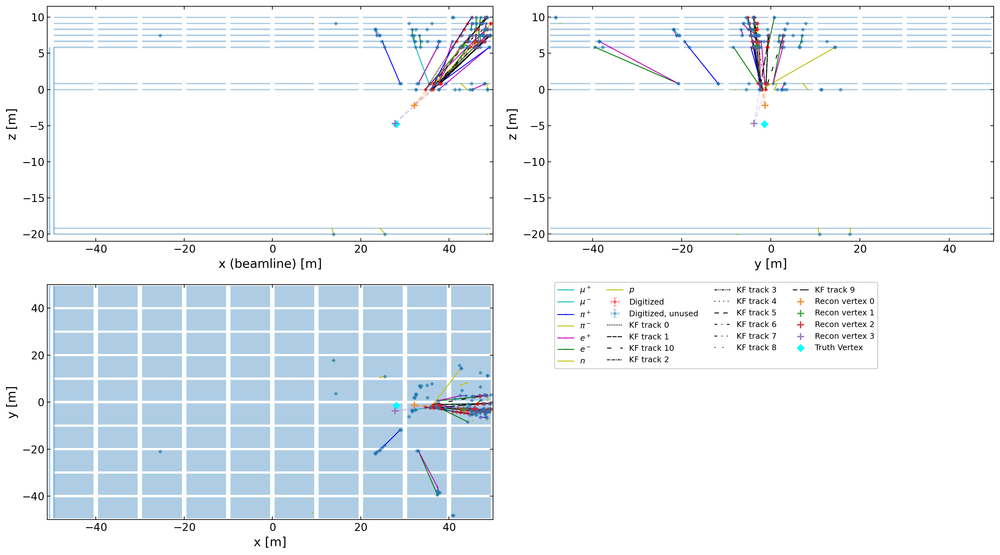

Geant4 index of particles in vertex
 [array([      3,   88866,   88866, 1144530]), array([88866, 88866, 88866]), array([     3, 201430]), array([    3, 13143])]
Geant4 index of particles in each track
 [list([88866, 88866, 201428, 253476])
 list([88866, 88866, 200001, 200001, 200001, 200001, 200001, 200001])
 list([200001, 113192, 113481, 88866])
 list([119509, 88866, 94896, 111061])
 list([1144530, 1144530, 1144530, 1144530])
 list([3, 1143882, 200002, 201430]) list([349109, 201430, 253476, 253476])
 list([1144533, 949978, 3, 3]) list([3, 3, 949978, 791639])
 list([200001, 88866, 201428, 88866]) list([1143881, 13143, 13143, 13473])]
===========================Event 83==============================
[[0.0, 1.0, 2.0, 3.0]]


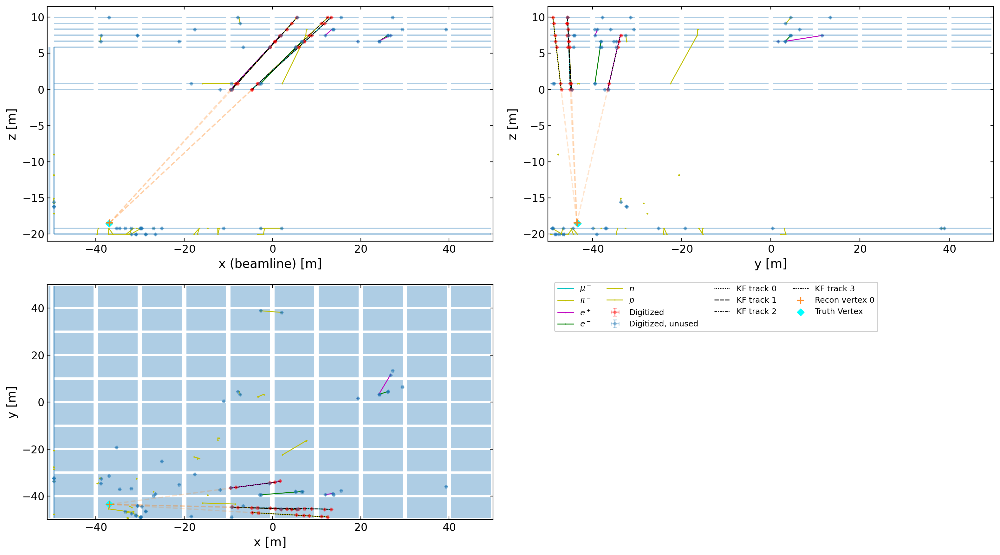

Geant4 index of particles in vertex
 [array([    4,    18,  4951, 61791])]
Geant4 index of particles in each track
 [list([18, 18, 18, 18, 18, 18, 18]) list([4, 4, 4, 4, 4, 4, 4, 4])
 list([4951, 4951, 4951, 4951, 4951, 4951, 4951])
 list([61791, 61791, 61791, 61791, 61791])]
===========================Event 84==============================
[[1.0, 6.0, 8.0, 15.0, 9.0, 13.0, 12.0, 10.0], [0.0, 5.0], [2.0, 7.0]]


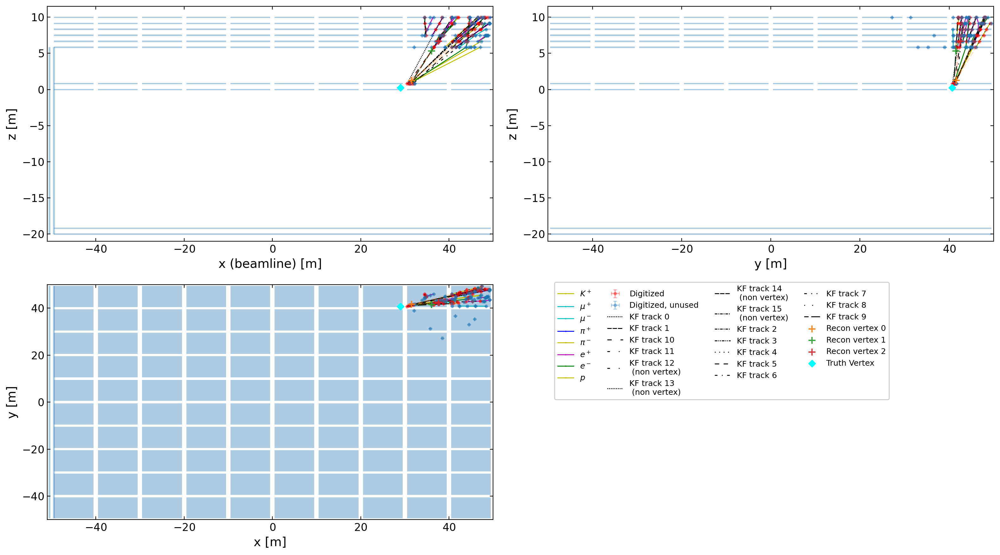

Geant4 index of particles in vertex
 [array([     1,      2,      8,     12,     16,     26, 166850, 229247]), array([16, 25]), array([13, 16])]
Geant4 index of particles in each track
 [list([16, 575305, 72674, 72674])
 list([229247, 229247, 235275, 235275, 235275])
 list([13, 575303, 575303, 72673, 584183]) list([11, 10, 235275, 235275])
 list([14, 11686, 11686, 11686]) list([322075, 25, 25, 521433])
 list([8, 11, 11, 11, 11]) list([575304, 16, 25, 25])
 list([1, 10, 472944, 10]) list([26, 26, 26, 26, 26])
 list([16, 25, 16, 16]) list([559317, 559315, 559315, 559315])
 list([166850, 584225, 584226, 584226]) list([2, 10, 243953, 268490])
 list([322075, 322075, 372721, 322075, 372747]) list([12, 12, 12, 404840])]
===========================Event 85==============================
[[1.0, 22.0, 2.0, 19.0, 23.0], [10.0, 13.0, 16.0, 7.0], [0.0, 20.0, 12.0], [18.0, 21.0], [17.0, 25.0, 9.0], [6.0, 8.0, 11.0], [4.0, 14.0], [15.0, 24.0]]


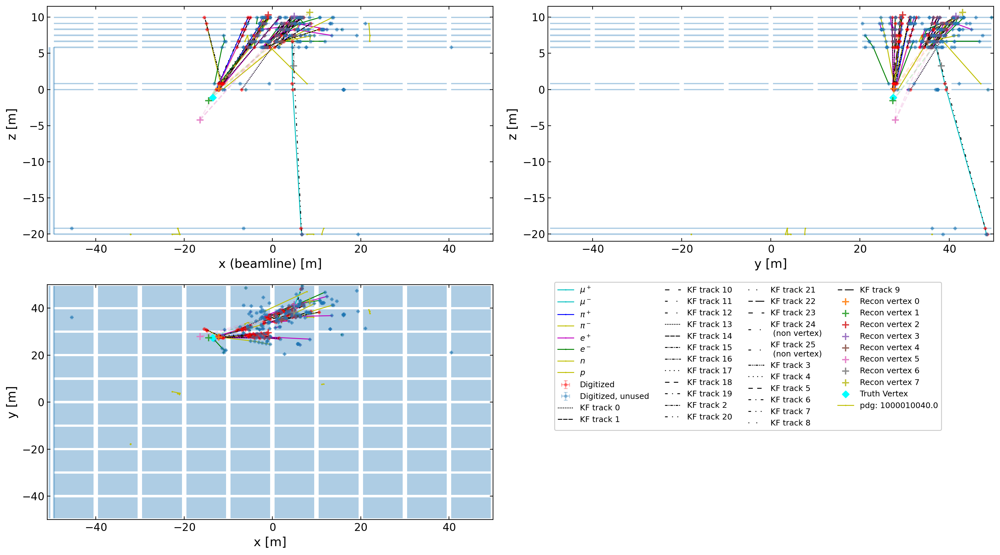

Geant4 index of particles in vertex
 [array([     2,      5,     28, 602327, 627425]), array([     2,     20,     20, 638873]), array([  2,  29, 181]), array([638836, 645659]), array([     5, 621918, 777690]), array([     2, 602310, 621905]), array([600629, 821207]), array([616443, 621899])]
Geant4 index of particles in each track
 [list([16, 16, 29, 29, 29, 2, 29, 189])
 list([2, 178001, 16, 16, 460353, 466949, 466949])
 list([602327, 602327, 602327, 602327, 602327])
 list([681007, 625083, 625083, 600628])
 list([821207, 822933, 822933, 822933])
 list([645659, 687244, 697244, 663892]) list([602326, 2, 2, 207])
 list([21, 2, 2, 28, 2]) list([602310, 621894, 617607, 617608])
 list([777690, 777694, 777694, 777694])
 list([645196, 680764, 638873, 682946, 644296])
 list([621905, 680765, 625369, 625370]) list([262225, 178002, 194, 181])
 list([20, 21, 178002, 178001, 178002, 178001, 178001, 178001])
 list([600629, 777691, 822933, 822933])
 list([621899, 634906, 682946, 645659]) list([20, 20

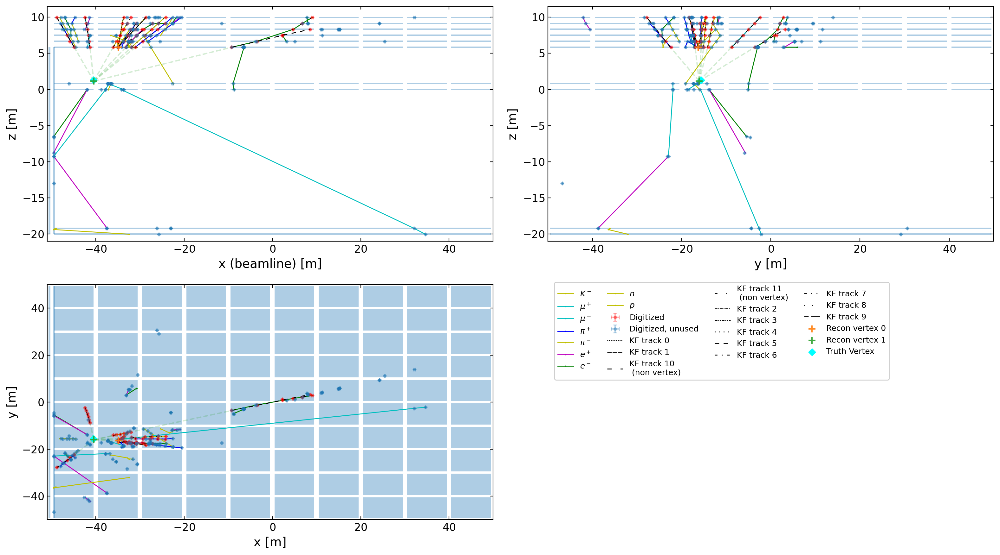

Geant4 index of particles in vertex
 [array([   12, 34282, 38875]), array([     6,     11,     16,     18,  34250, 170224, 225021])]
Geant4 index of particles in each track
 [list([38877, 38875, 38875, 38875, 38875, 38875])
 list([225021, 225021, 225021, 225021, 225021, 225021])
 list([6, 6, 6, 6, 6]) list([34251, 37749, 34250, 34250])
 list([16, 16, 16, 78158]) list([38874, 38874, 34282, 38874, 38874])
 list([18, 18, 18, 18, 18]) list([11, 11, 11, 11, 11, 151843])
 list([34250, 37749, 37749, 37750]) list([12, 12, 12, 12])
 list([177024, 170224, 170224, 170224])
 list([170224, 177197, 177024, 177208])]
===========================Event 87==============================
[]


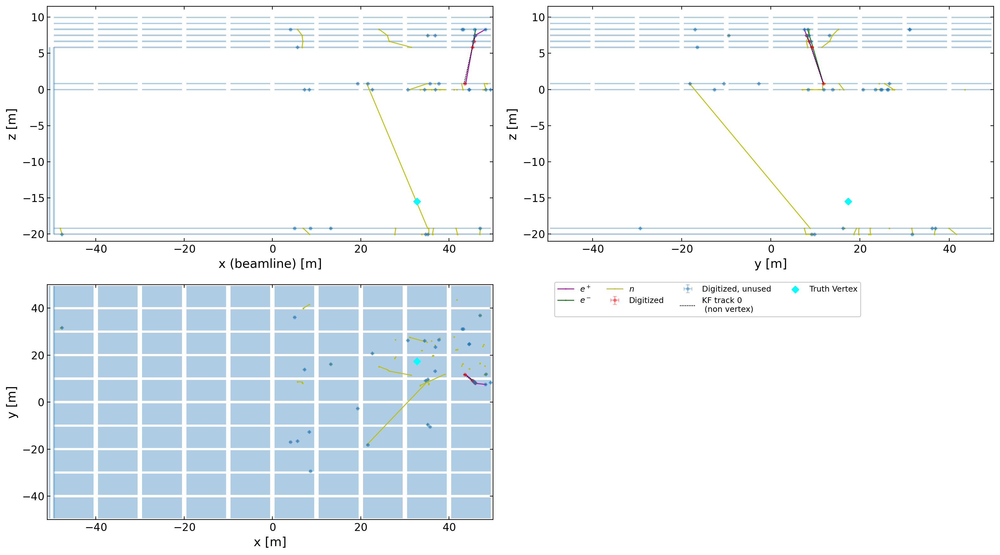

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 [[157027 157027 157028 157028]]
===========================Event 88==============================
[[0.0, 4.0, 7.0, 3.0, 1.0, 5.0, 2.0, 6.0]]


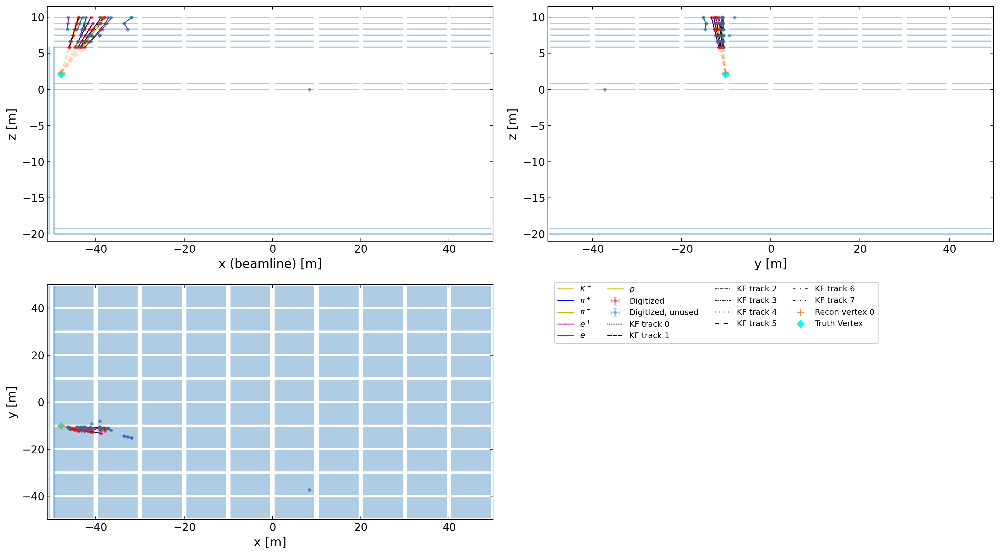

Geant4 index of particles in vertex
 [array([     1,      6,      7,     11,     11,     15,     21, 509161])]
Geant4 index of particles in each track
 [list([1, 1, 1, 1, 1, 1]) list([21, 21, 21, 21, 21])
 list([509161, 509161, 509161, 509161]) list([15, 15, 15, 15, 15])
 list([7, 7, 7, 7, 7, 416308]) list([6, 6, 6, 6, 6, 6])
 list([11, 20, 20, 20]) list([11, 11, 11, 11])]
===========================Event 89==============================
[[3.0, 4.0, 2.0]]


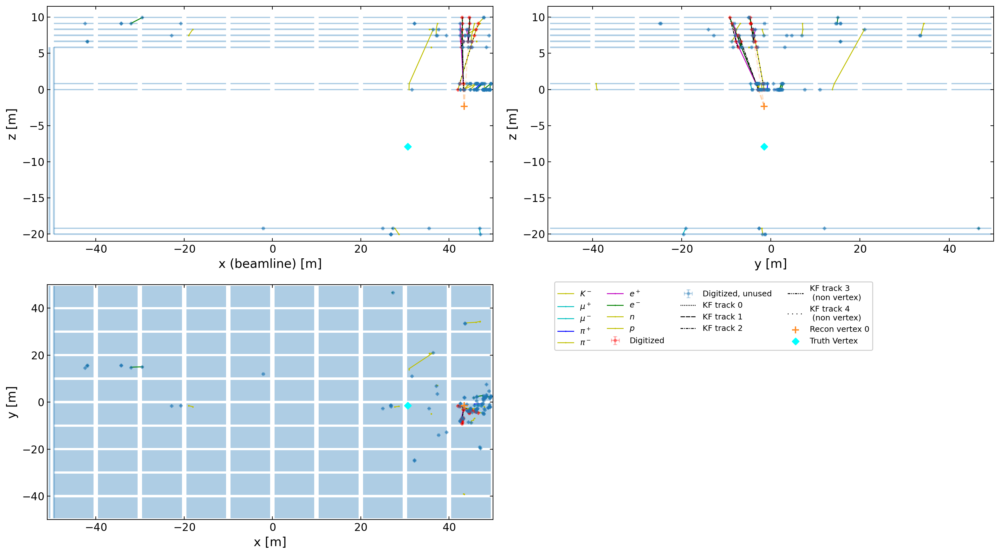

Geant4 index of particles in vertex
 [array([679154, 679156, 697418])]
Geant4 index of particles in each track
 [list([689674, 689674, 689673, 689673])
 list([119, 119, 119, 119, 119, 119, 62810])
 list([679154, 689673, 690510, 689673])
 list([679156, 689673, 697218, 689673])
 list([697419, 697418, 697418, 697418, 697418])]
===========================Event 90==============================
[[5.0, 12.0, 13.0, 22.0, 4.0, 16.0, 7.0, 3.0, 21.0, 10.0, 20.0], [17.0, 19.0, 2.0, 0.0], [11.0, 15.0, 9.0], [1.0, 8.0]]


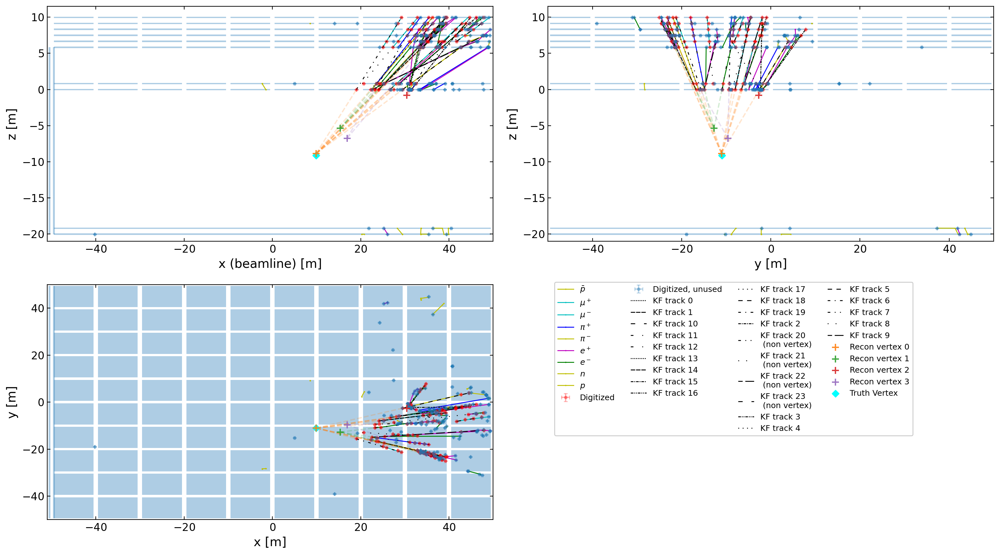

Geant4 index of particles in vertex
 [array([     9,     10,     12,     33, 325302, 418117, 422721, 473203,
       473204, 497730, 509583]), array([    10, 312842, 406591, 718708]), array([473203, 758698, 759683]), array([     5, 406591])]
Geant4 index of particles in each track
 [list([10, 10, 422721, 422722]) list([418118, 420795, 406591, 413610])
 list([406591, 406591, 406591, 406591, 415894])
 list([431016, 422722, 422721, 426996]) list([30497, 9, 9, 9, 9, 9])
 list([10, 10, 10, 10, 10, 10]) list([758698, 758698, 767541, 767541])
 list([33, 17026, 17026, 17026, 17026]) list([314991, 322923, 5, 5])
 list([759683, 760554, 760553, 760553])
 list([473204, 473204, 497730, 497730])
 list([758698, 473203, 473203, 497730])
 list([509583, 509583, 509583, 509583, 509583, 509583, 509583])
 list([473203, 473203, 473203, 473203, 475011, 475157])
 list([1, 820864, 820864, 820864, 820864, 820864])
 list([758698, 760553, 760553, 764934]) list([12, 12, 12, 604326])
 list([312842, 312842, 325915, 3

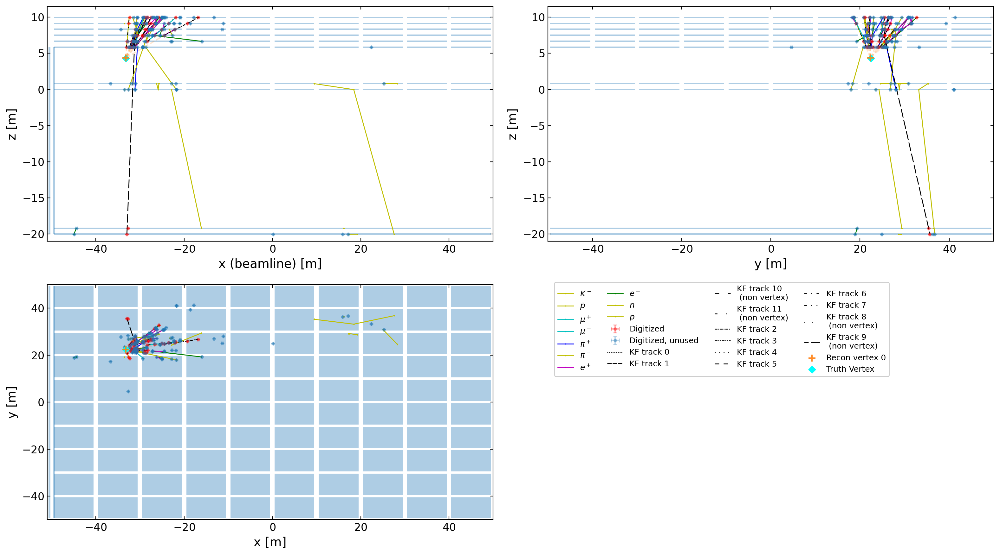

Geant4 index of particles in vertex
 [array([    9,    11,    12,    16,    18,    22,    30, 44133])]
Geant4 index of particles in each track
 [list([13, 13, 14, 12]) list([1, 1, 1, 9])
 list([141594, 141595, 142055, 142055]) list([16, 266071, 114114, 114115])
 list([16, 16, 16, 16]) list([11, 20, 230117, 318335])
 list([30, 30, 30, 30]) list([22, 22, 22, 22])
 list([375434, 18, 375434, 375434]) list([9, 21, 9, 21])
 list([44133, 44133, 45522, 45605])
 list([61942, 61942, 61942, 61942, 61942])]
===========================Event 92==============================
[[0.0, 1.0, 2.0]]


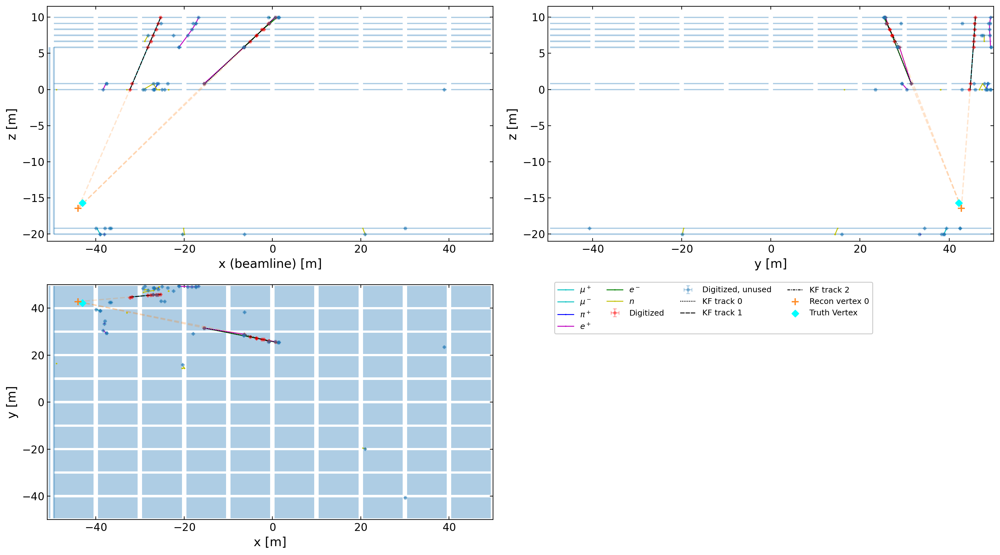

Geant4 index of particles in vertex
 [array([  14, 3473, 3473])]
Geant4 index of particles in each track
 [list([3474, 3473, 3894, 3473, 8543, 8542])
 list([14, 14, 14, 14, 14, 14, 14, 14]) list([3474, 3473, 3473, 8542])]
===========================Event 93==============================
[[6.0, 10.0, 8.0, 11.0, 5.0, 0.0, 7.0, 13.0, 14.0, 1.0], [2.0, 9.0]]


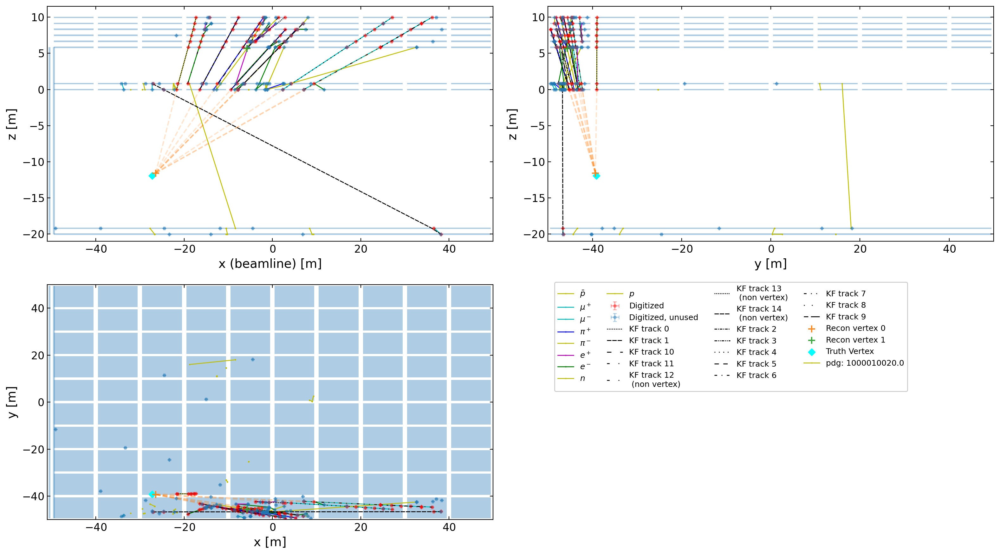

Geant4 index of particles in vertex
 [array([     2,      4,      6,      6,     13,     14,     21,  32521,
       268458, 268458]), array([    12, 299576])]
Geant4 index of particles in each track
 [list([4, 4, 4, 4, 4, 4, 4]) list([6, 6, 21, 21, 21, 56790])
 list([12, 299571, 299571, 299571, 299571])
 list([23816, 23816, 23816, 23816, 24276, 25153])
 list([239474, 239475, 239475, 240097])
 list([32521, 32521, 32521, 32521, 32521, 32521, 32521, 32521])
 list([2, 2, 2, 2, 2, 2, 2, 2])
 list([268458, 268458, 268458, 268458, 268458, 268458])
 list([13, 13, 13, 13, 13, 13]) list([299576, 299576, 299576, 299576])
 list([14, 14, 14, 14, 14, 14, 14]) list([21, 21, 21, 21])
 list([8703, 23817, 152460, 152460])
 list([268458, 268458, 268458, 268458]) list([21, 6, 6, 6])]
===========================Event 94==============================
[[0.0, 2.0, 12.0, 14.0, 23.0, 11.0, 1.0, 5.0], [6.0, 13.0], [4.0, 16.0, 19.0, 7.0], [17.0, 22.0, 15.0], [10.0, 18.0, 21.0]]


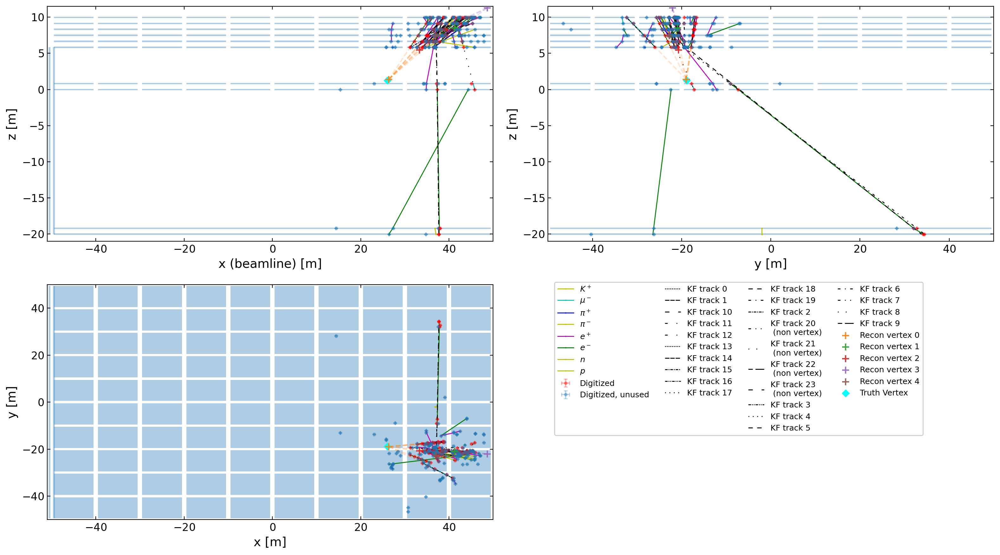

Geant4 index of particles in vertex
 [array([     8,      8,      8,      9,     13,   2352,  13085, 126615]), array([   209, 120335]), array([     3,  22774, 173988, 838329]), array([108819, 175082, 231689]), array([    11, 774641, 774641])]
Geant4 index of particles in each track
 [list([13, 13, 13, 13, 13, 13]) list([427143, 427143, 230123, 2352])
 list([8, 8, 153146, 655126, 8]) list([4, 682738, 357946, 226569])
 list([13085, 426862, 3, 3, 3]) list([671166, 8, 618858, 8])
 list([340080, 340080, 120335, 217362])
 list([427143, 340082, 358054, 22774])
 list([492006, 492006, 492006, 492743, 492743])
 list([11, 462792, 869294, 869294]) list([11, 838335, 841232, 841232])
 list([8, 8, 8, 544339]) list([9, 9, 9, 9, 9])
 list([682550, 176695, 176695, 209, 370266])
 list([13085, 13658, 13085, 13658]) list([682550, 682548, 231689, 784373])
 list([232801, 175083, 212061, 173988])
 list([158345, 152824, 108819, 225977])
 list([838332, 774641, 774641, 775268])
 list([838329, 838329, 838329, 838

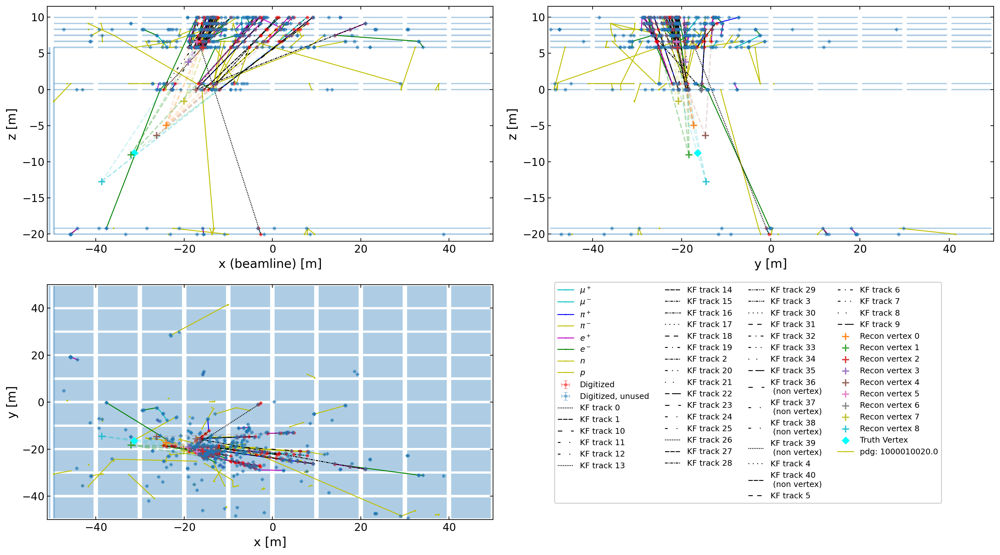

Geant4 index of particles in vertex
 [array([     2,     14, 162283, 340253, 385246, 978470]), array([     5,      8, 228482, 331587, 600533, 978470]), array([     7, 367229, 439803]), array([337043, 339582, 550548, 560009, 783544]), array([ 2, 17]), array([328999, 336149, 337043, 340253, 367375]), array([13, 13]), array([314988, 328999, 384459, 978470]), array([      7,  136612, 1131413])]
Geant4 index of particles in each track
 [list([784402, 393157, 454242, 328999, 370894])
 list([7, 398360, 548559, 385247]) list([795009, 393174, 437427, 367375])
 list([1013955, 978470, 982287, 978471, 982288, 978471])
 list([410437, 783036, 384459, 546880])
 list([795009, 440669, 410235, 340253])
 list([778170, 783036, 429093, 385246])
 list([799766, 336149, 440669, 454243, 340253])
 list([337043, 799767, 796513, 550548, 625804])
 list([8, 8, 678988, 768211])
 list([783546, 317922, 392837, 476307, 228482])
 list([978470, 978470, 978470, 978470, 982287])
 list([2, 625703, 1027284, 1027284, 1027284,

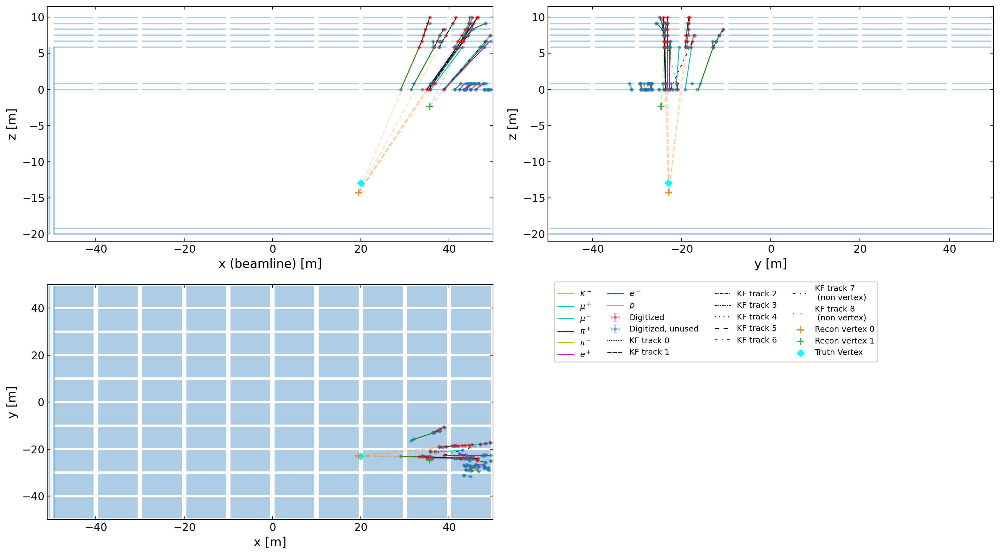

Geant4 index of particles in vertex
 [array([    15,     15,     45, 724275, 734425]), array([290558, 293439])]
Geant4 index of particles in each track
 [list([724275, 724275, 724275, 724275, 724275, 724275])
 list([290558, 290558, 642548, 642548]) list([45, 45, 45, 45, 45, 45])
 list([83434, 83434, 83434, 83434])
 list([290558, 290904, 15, 15, 15, 15, 15, 15])
 list([734425, 734425, 734425, 734425, 734425])
 list([293439, 743184, 743184, 743184]) list([743300, 7, 291003, 292106])
 list([15, 15, 292105, 292106])]
===========================Event 97==============================
[]


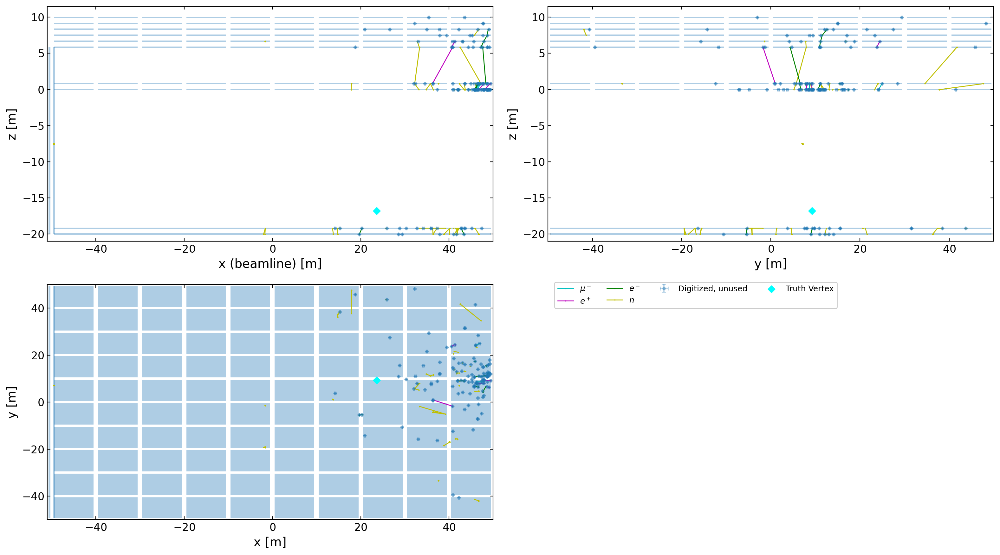

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []
===========================Event 98==============================
[[2.0, 4.0, 3.0, 1.0, 5.0, 0.0]]


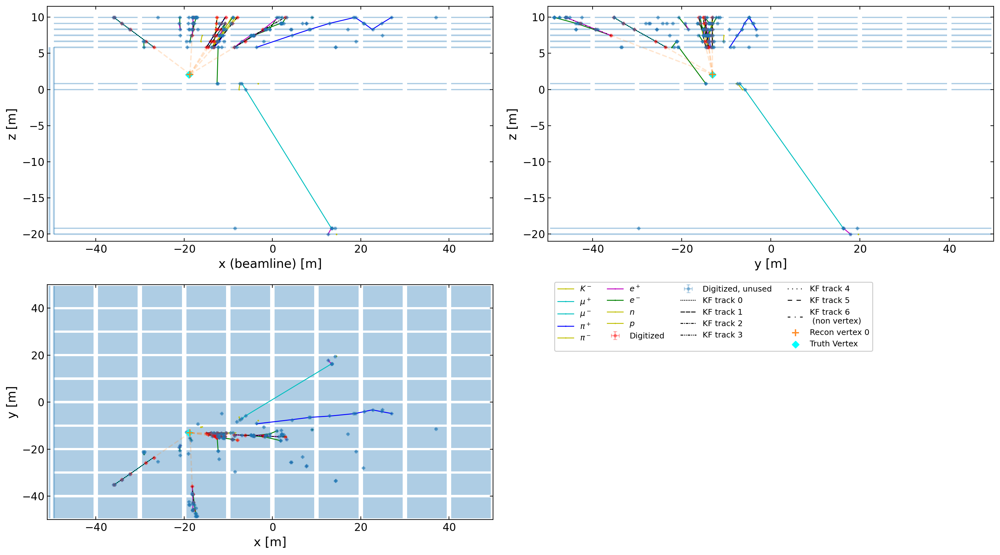

Geant4 index of particles in vertex
 [array([     1,      4,     20, 168248, 181421, 203800])]
Geant4 index of particles in each track
 [list([1, 19, 19, 19]) list([4, 4, 4, 4, 4])
 list([168248, 168248, 168248, 168248, 168248])
 list([203800, 203800, 208448, 223740, 214173])
 list([20, 20, 20, 20, 20, 20]) list([181421, 181422, 200748, 181422])
 list([250676, 250659, 250659, 250659, 250659, 250659])]
===========================Event 99==============================
[]


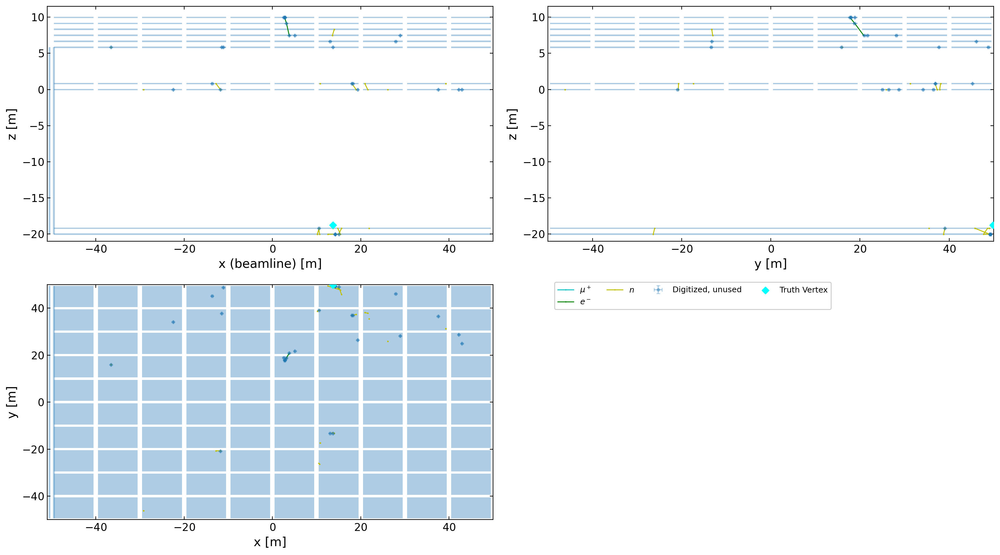

Geant4 index of particles in vertex
 []
Geant4 index of particles in each track
 []


In [8]:
ev = event.Event(filename, 0, tree_name=tree_name)

for i in range(100):
    print(f"===========================Event {i}==============================")
    ev.EventNumber=i
    ev.Tree.GetEntry(ev.EventNumber)

    fig,axs=plt.subplots(2,2,figsize=(16,9))
    # fig = vis.plot_truth(ev,fig=fig, disp_det_view=True, disp_filereader_vertex=True, disp_first_hit=False,make_legend=False);
    # fig = vis.plot_recon(ev,fig=fig, disp_det_view=True, disp_recon_vertex=True,force_limit=True,make_legend=True);
    
    fig = vis.plot_truth(ev,fig=fig, disp_det_view=True, disp_filereader_vertex=True, disp_first_hit=False,make_legend=False);
    fig = vis.plot_recon(ev,fig=fig, disp_det_view=True, disp_recon_vertex=True,force_limit=True,make_legend=True, disp_vertex_track_extension=True);    
    print(util.unzip(ev.Tree.Vertex_k_m_trackIndices))
    show()

    
    track_km_inds = np.array(util.unzip(util.c2list(ev.Tree.Track_k_m_ids)),dtype=object)
    track_km_g4inds = np.array([min(i) for i in track_km_inds])
    vertex_track_inds=util.unzip(np.array(util.c2list(ev.Tree.Vertex_k_m_trackIndices),dtype=int))
    vertex_track_g4inds = [np.sort(track_km_g4inds[ind]) for ind in vertex_track_inds]
    print("Geant4 index of particles in vertex\n", vertex_track_g4inds)
    print("Geant4 index of particles in each track\n", track_km_inds)